In [1]:
import copy, os, sys, time

import pandas as pd
import numpy as np
import tensorflow as tf

import seaborn as sns
import matplotlib
# matplotlib.use('Qt5Agg')
import matplotlib.pyplot as plt

sys.path.append('../')
from det_rnn import *
import det_rnn.train as utils_train
import det_rnn.analysis as utils_analysis
from det_rnn.train.model import Model
from models.gatedRNN.gatedRNN import gRNN
from models.gatedRNN.gatedRNN_hyper import grnn_hp

from models.base.analysis import behavior_summary, estimation_decision

from utils.plotfnc import *

print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

2.3.1
Num GPUs Available:  0


# Generate stimulus, training and test sets
For decision and estimation

In [2]:
print('batchsize = ' + str(par['batch_size']))
par

batchsize = 128


{'design': {'iti': (0, 1.5),
  'stim': (1.5, 3.0),
  'delay': ((3.0, 4.0), (5.5, 6.0)),
  'decision': (4.0, 5.5),
  'estim': (6.0, 7.5)},
 'dm_output_range': 'design',
 'em_output_range': 'design',
 'dead': 'design',
 'mask_dm': {'iti': 1.0,
  'stim': 1.0,
  'decision': 1600.0,
  'delay': 1.0,
  'estim': 1.0,
  'rule_iti': 2.0,
  'rule_stim': 2.0,
  'rule_decision': 3200.0,
  'rule_delay': 2.0,
  'rule_estim': 2.0},
 'mask_em': {'iti': 1.0,
  'stim': 1.0,
  'decision': 1.0,
  'delay': 1.0,
  'estim': 200.0,
  'rule_iti': 2.0,
  'rule_stim': 2.0,
  'rule_decision': 2.0,
  'rule_delay': 2.0,
  'rule_estim': 400.0},
 'input_rule': 'design',
 'output_dm_rule': 'design',
 'output_em_rule': 'design',
 'input_rule_strength': 0.8,
 'output_dm_rule_strength': 0.8,
 'output_em_rule_strength': 0.8,
 'reference': [-4, -3, -2, -1, 1, 2, 3, 4],
 'strength_ref': 1.0,
 'type': 'orientation',
 'stim_dist': 'uniform',
 'natural_a': 0.0002,
 'ref_dist': 'uniform',
 'trial_per_subblock': 1,
 'stim_encodin

In [3]:
# training set
par_train = copy.deepcopy(par)
par_train['n_ori'] = 24
par_train = update_parameters(par_train)
stim_train = Stimulus(par_train)

# generate training data
train_data = stim_train.generate_trial()

orientation = 157.5, reference = 127.5


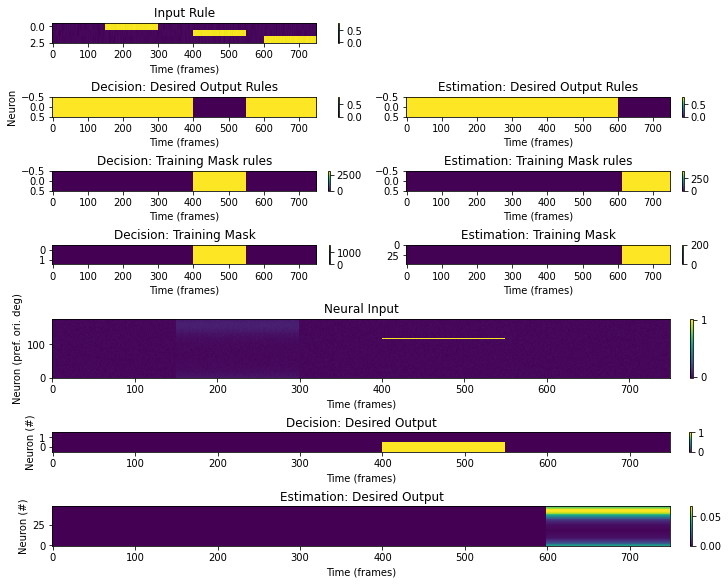

In [4]:
# check stimulus
random_trial_num = np.random.randint(stim_train.batch_size)
target_ori = np.arange(0,180,180/par_train['n_ori'])[train_data['stimulus_ori'][random_trial_num]]
ref_ori = np.arange(0,180,180/par_train['n_tuned_input'])[train_data['ref_neuron'][random_trial_num]]
print('orientation = ' + str(target_ori) + ', reference = ' + str(ref_ori))
plot_trial(train_data, stim_train, TEST_TRIAL=random_trial_num)

In [5]:
# set up a new test data with more batch
par_test                        = copy.deepcopy(par)
par_test['n_ori']               = 24
par_test['batch_size']          = 5000 # at least 9 refs * 24 orientations
par_test['reference']           = [-4, -3, -2, -1, 0, 1, 2, 3, 4]
par_test                        = update_parameters(par_test)
stim_test                       = Stimulus(par_test)
test_data                       = stim_test.generate_trial()

# set up network


In [6]:
grnn_hp = grnn_hp(par_train)
grnn = gRNN(grnn_hp, par_train)

In [7]:
# untrained network behavior
test_data                       = stim_train.generate_trial()
test_lossStruct, test_outputs   = grnn.evaluate(test_data)
est_summary, dec_summary = behavior_summary(test_data, test_outputs, stim_train)

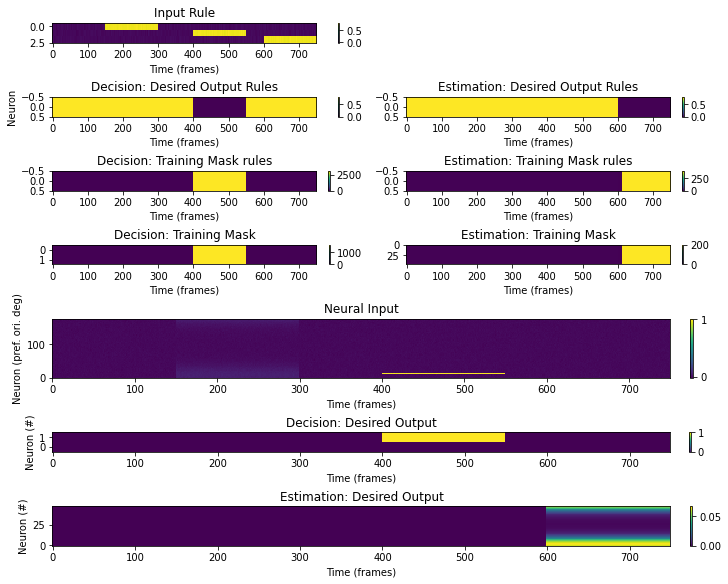

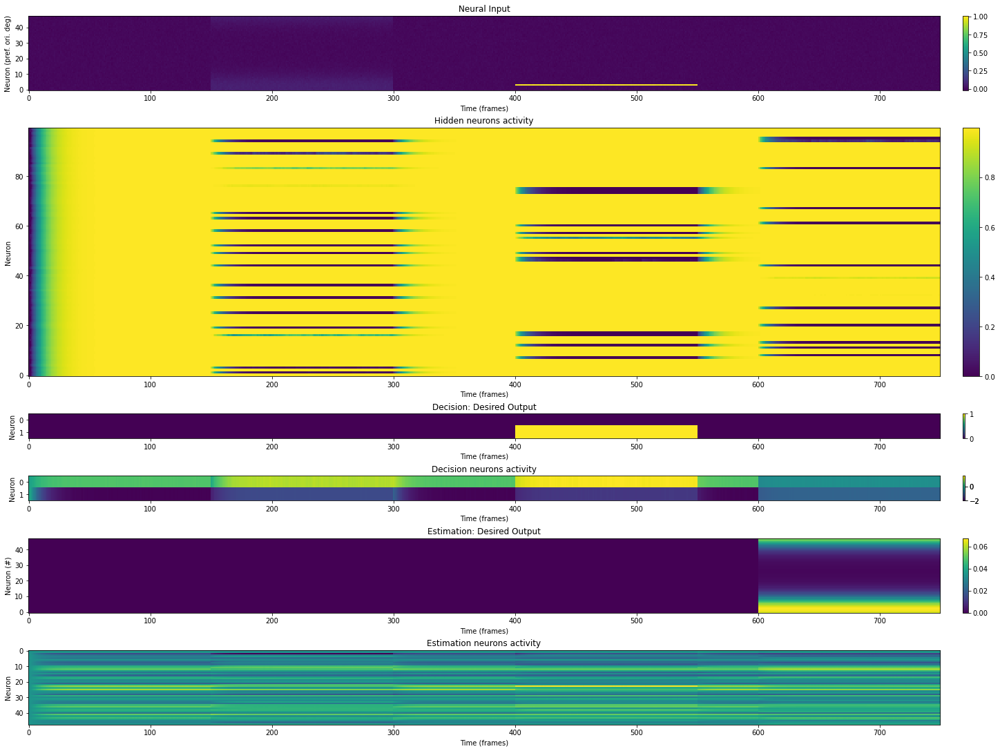

In [8]:
TEST_TRIAL = np.random.randint(stim_train.batch_size) 
plot_trial(test_data, stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)
plot_rnn_output(test_data,test_outputs,stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)

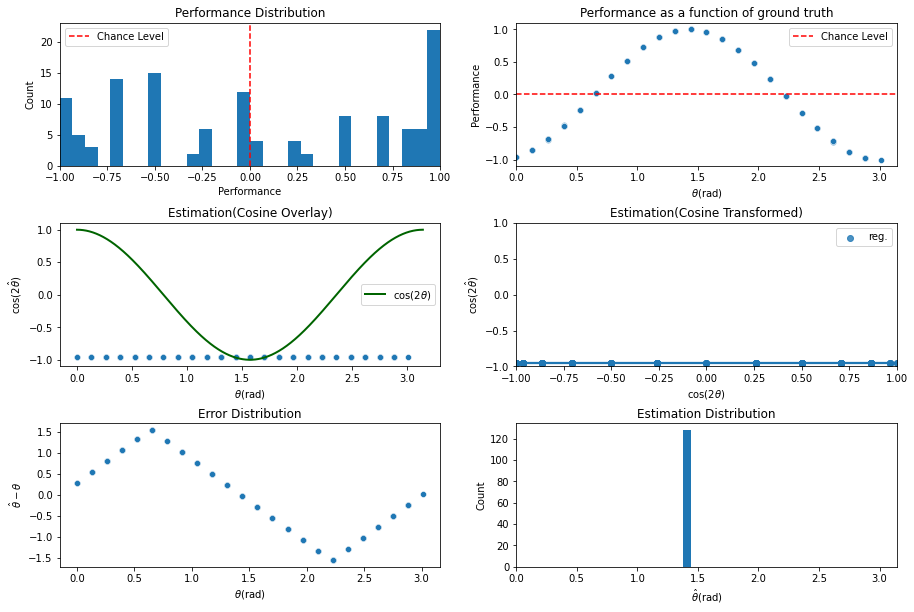

In [9]:
behavior_figure(est_summary)

# Model 5
- No stsp
- relu(tanh()) activation
- gated outputs (dm and em)

In [10]:
grnn_hp

{'output_path': '/Users/JRyu/github/det_rnn/experiments/grnn/model1/',
 'model_output': '/Users/JRyu/github/det_rnn/experiments/grnn/model1/model',
 'log_path': '/Users/JRyu/github/det_rnn/experiments/grnn/model1/logs',
 'saving_freq': 100,
 'dtype': 'tf.float32',
 'loss_mse_dec': 1,
 'loss_mse_est': 1,
 'loss_ce_dec': 1,
 'loss_ce_est': 1,
 'loss_spike': 0.002,
 'loss_L1': 0.01,
 'loss_L2': 0.01,
 'nsteps_train': 5000,
 'learning_rate': 0.02,
 'clip_max_grad_val': 0.1,
 'dt': 10.0,
 'neuron_tau': 100,
 'noise_sd': 0.5,
 'neuron_stsp': False,
 'exc_inh_prop': 0.8,
 'alpha_std': (0.05, 0.00667),
 'alpha_stf': (0.00667, 0.05),
 'U': (0.15, 0.45),
 'n_input': 51,
 'n_tuned_input': 48,
 'n_hidden': 100,
 'n_tuned_output': 48,
 'n_rule_input': 3,
 'n_rule_output_dm': 1,
 'n_rule_output_em': 1,
 'out_gate': True,
 'rnn_gate': True,
 'rnn_weights': 'normal',
 'rnn_weights_shift': 86,
 'rnn_weights_scale': 112,
 'rnn_noise_type': 'Normal_fixed'}

In [11]:
hp5    = copy.deepcopy(grnn_hp)
hp5['output_path'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model5/'
hp5['model_output'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model5/model'
hp5['log_path'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model5/logs'
hp5['learning_rate'] = 0.05
hp5['neuron_stsp'] = False
hp5['out_gate'] = True
grnn5  = gRNN(hp5, par_train)
# grnn2.train(stim_train = stim_train, stim_test= stim_train, niter=5000)

In [12]:
# load trained network without stsp
# no STSP
#from det_rnn.base.functions import alternating, w_rnn_mask
#from models.gatedRNN.gatedRNN import RNNCell
#model1_path = '/Users/JRyu/github/det_rnn/experiments/grnn/model1/model/iter1/'
#grnn1 = tf.keras.models.load_model(model1_path,
#                                   custom_objects={'RNNCell': RNNCell}, 
#                                   compile=False)

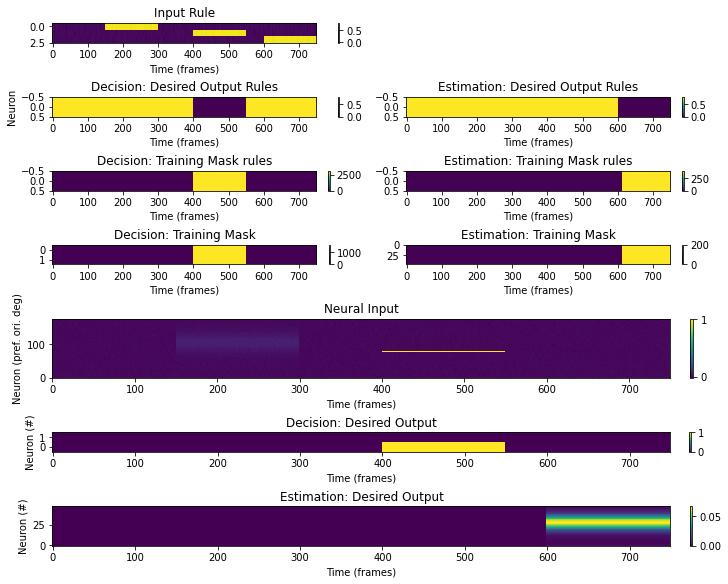

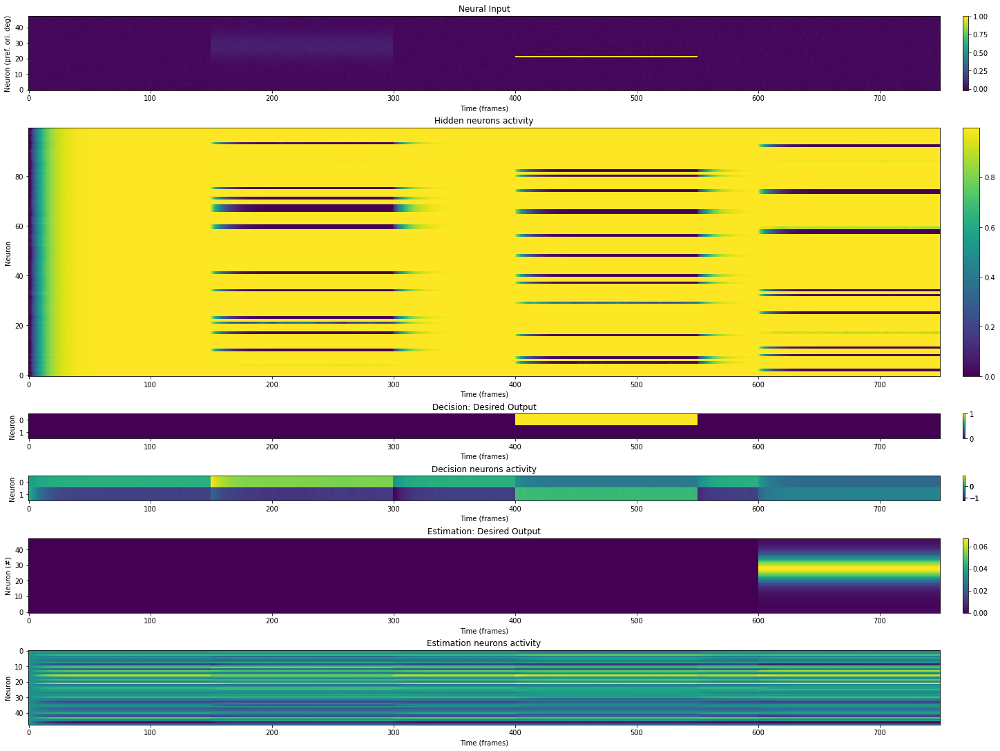

../models/base/analysis.py:186: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['CW'][0] = False
../models/base/analysis.py:187: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['CW'][1] = True
../utils/plotfnc.py:477: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)
../utils/plotfnc.py:485: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)


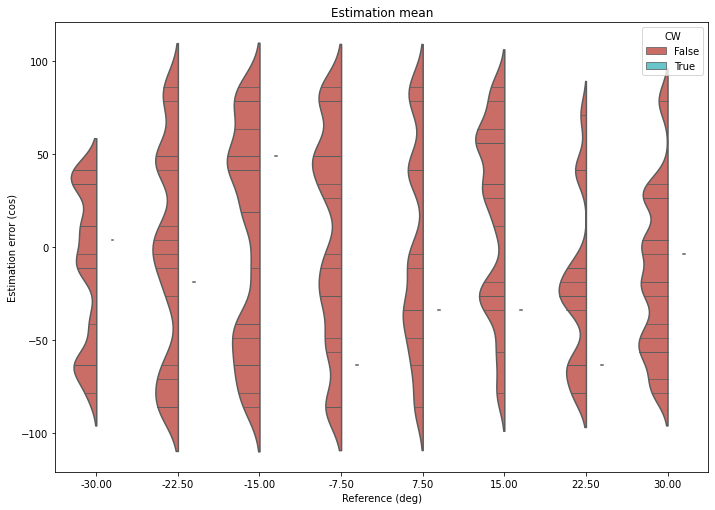

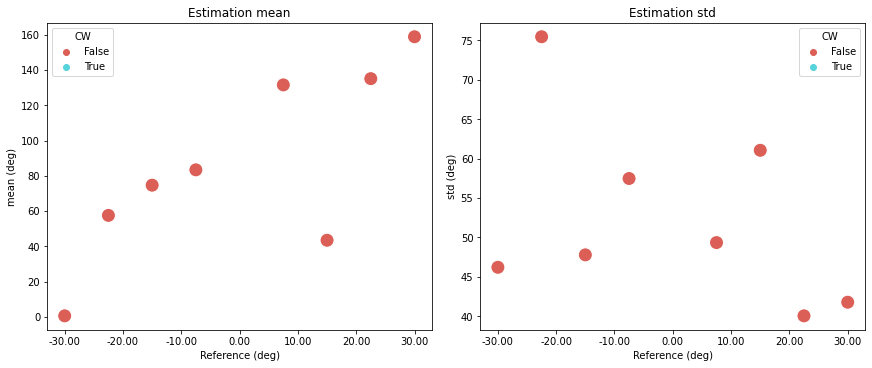

In [13]:
# evaluate and visualize before training
test_lossStruct, test_outputs   = grnn5.evaluate(test_data)

# plot rnn trial and outputs
TEST_TRIAL = np.random.randint(stim_train.batch_size) 
plot_trial(test_data, stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)
plot_rnn_output(test_data,test_outputs,stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)

# plot rnn decision effects on estimation
df_trials, df_sum = estimation_decision(test_data, test_outputs, stim_test)
plot_decision_effects(df_trials,df_sum)

   1/5000 [..............................] - ETA: 35189s - Train Loss: 2.3755 - Test Loss: 16.9697 - Test estimation cos error: : 0.6351 - Test decision performance: : 0.5000 - Grads: 6.7346


 Epoch 2, Train Loss: 2.3754830360412598, Test Loss: 16.969730377197266


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


From /opt/anaconda3/envs/detrnn37/lib/python3.7/site-packages/tensorflow/python/training/tracking/tracking.py:111: Layer.updates (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1/assets


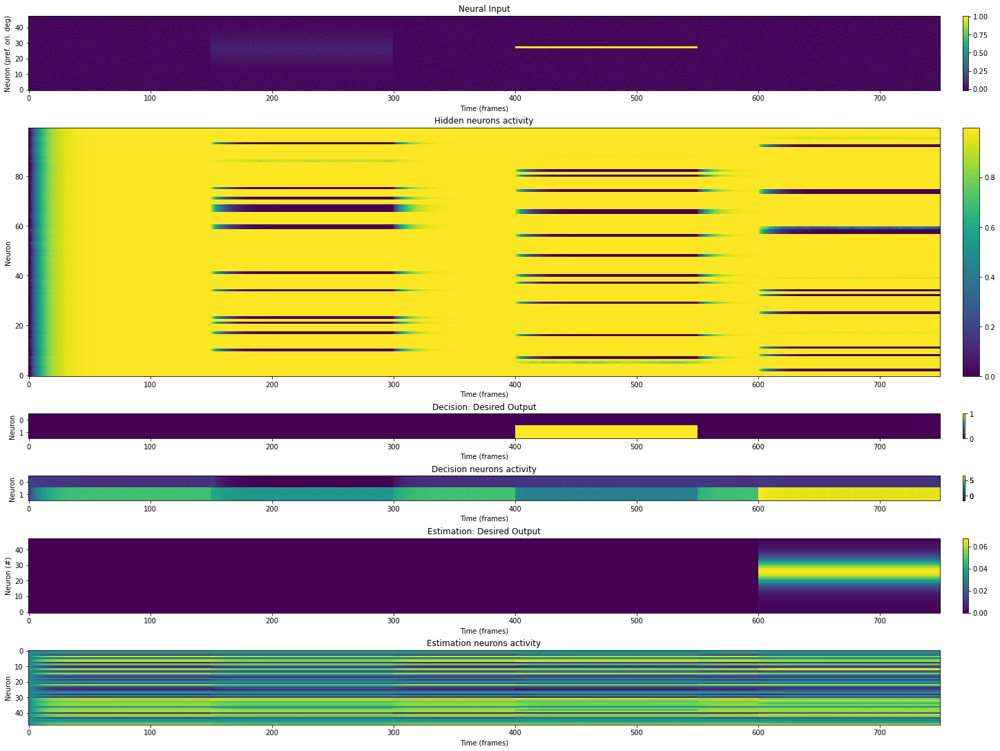

 101/5000 [..............................] - ETA: 28675s - Train Loss: 0.4838 - Test Loss: 0.4873 - Test estimation cos error: : 0.6605 - Test decision performance: : 0.4375 - Grads: 0.7667


 Epoch 102, Train Loss: 0.4838006794452667, Test Loss: 0.4873213469982147


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter101/assets


<Figure size 432x288 with 0 Axes>

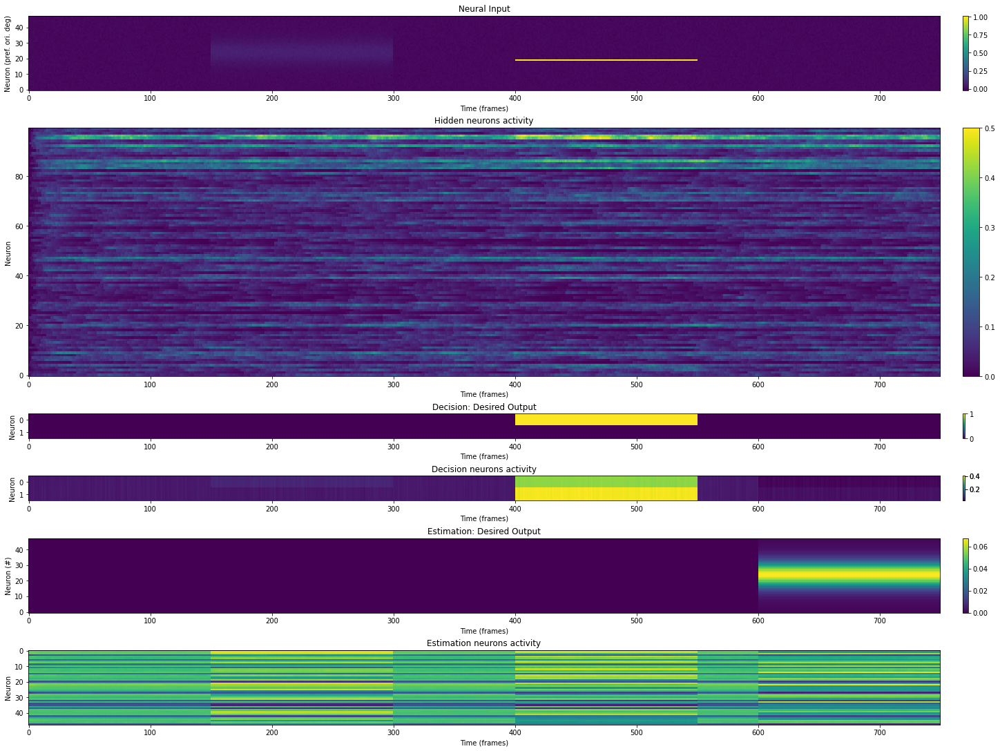

 201/5000 [>.............................] - ETA: 28408s - Train Loss: 0.4813 - Test Loss: 0.4899 - Test estimation cos error: : 0.6223 - Test decision performance: : 0.4453 - Grads: 0.7663


 Epoch 202, Train Loss: 0.48133209347724915, Test Loss: 0.48988252878189087


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter201/assets


<Figure size 432x288 with 0 Axes>

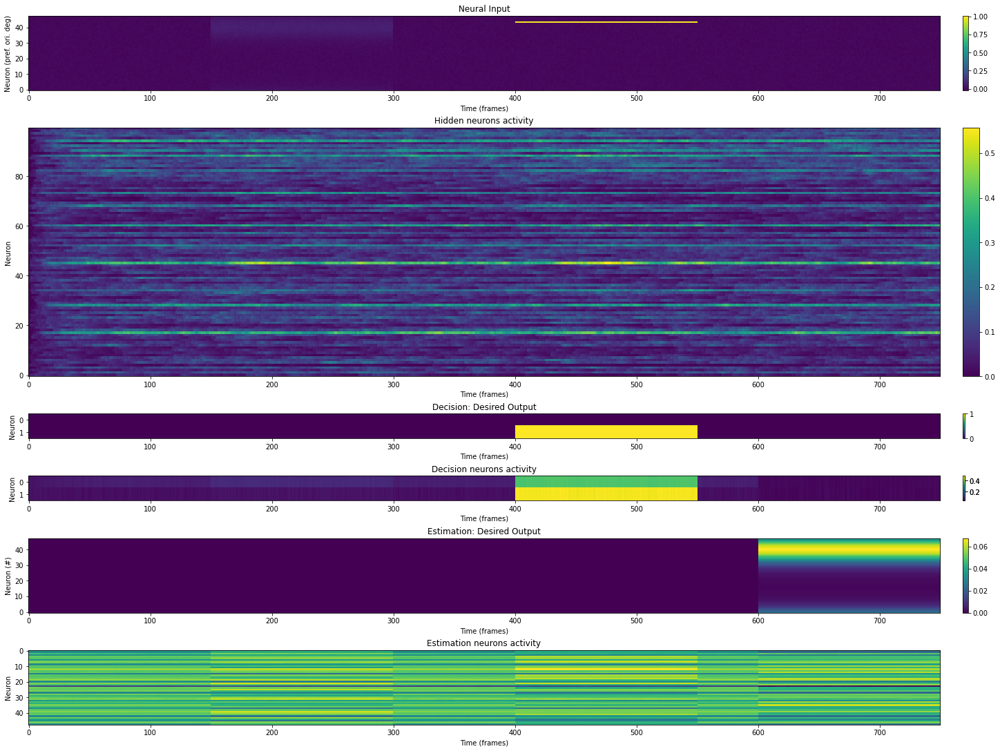

 301/5000 [>.............................] - ETA: 27740s - Train Loss: 0.4875 - Test Loss: 0.4813 - Test estimation cos error: : 0.6077 - Test decision performance: : 0.5781 - Grads: 0.7763


 Epoch 302, Train Loss: 0.487519234418869, Test Loss: 0.48133736848831177


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter301/assets


<Figure size 432x288 with 0 Axes>

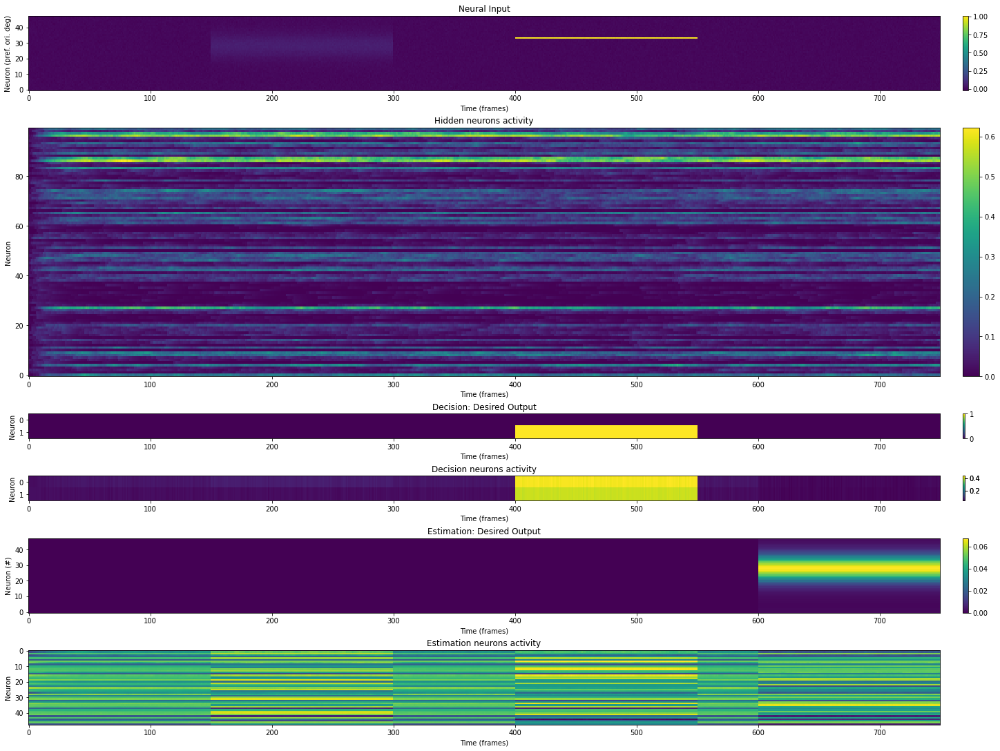

 401/5000 [=>............................] - ETA: 27203s - Train Loss: 0.4841 - Test Loss: 0.4978 - Test estimation cos error: : 0.6527 - Test decision performance: : 0.5078 - Grads: 0.7701


 Epoch 402, Train Loss: 0.48414942622184753, Test Loss: 0.4978276789188385


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter401/assets


<Figure size 432x288 with 0 Axes>

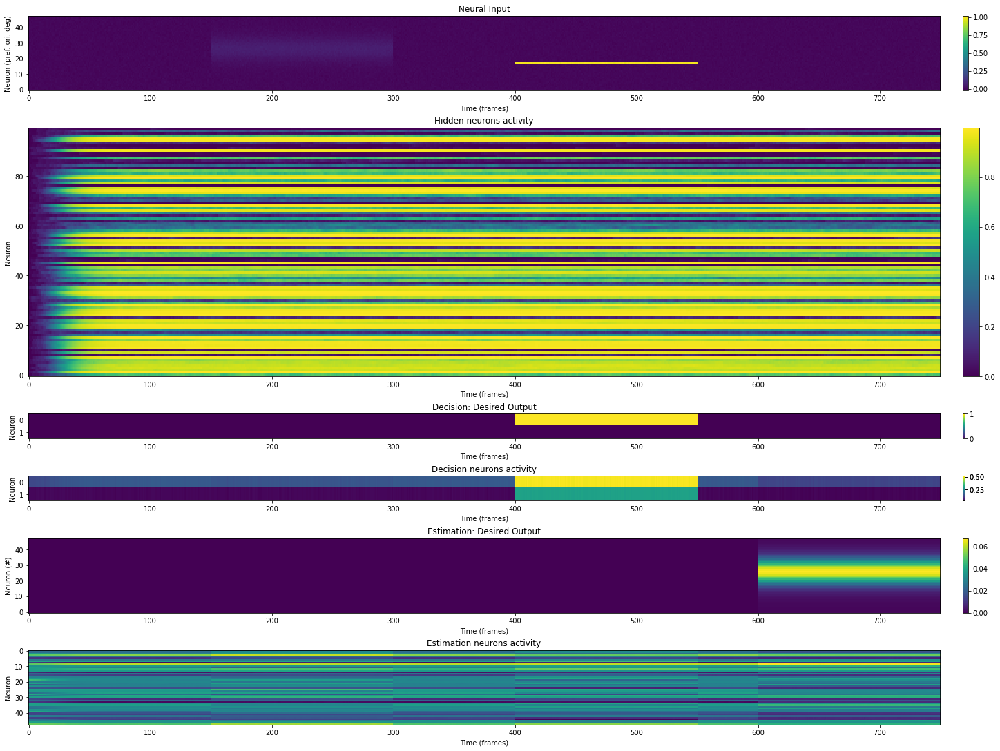

 501/5000 [==>...........................] - ETA: 26559s - Train Loss: 0.4867 - Test Loss: 0.4874 - Test estimation cos error: : 0.6515 - Test decision performance: : 0.4844 - Grads: 0.7720


 Epoch 502, Train Loss: 0.4866977035999298, Test Loss: 0.4874309301376343


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter501/assets


<Figure size 432x288 with 0 Axes>

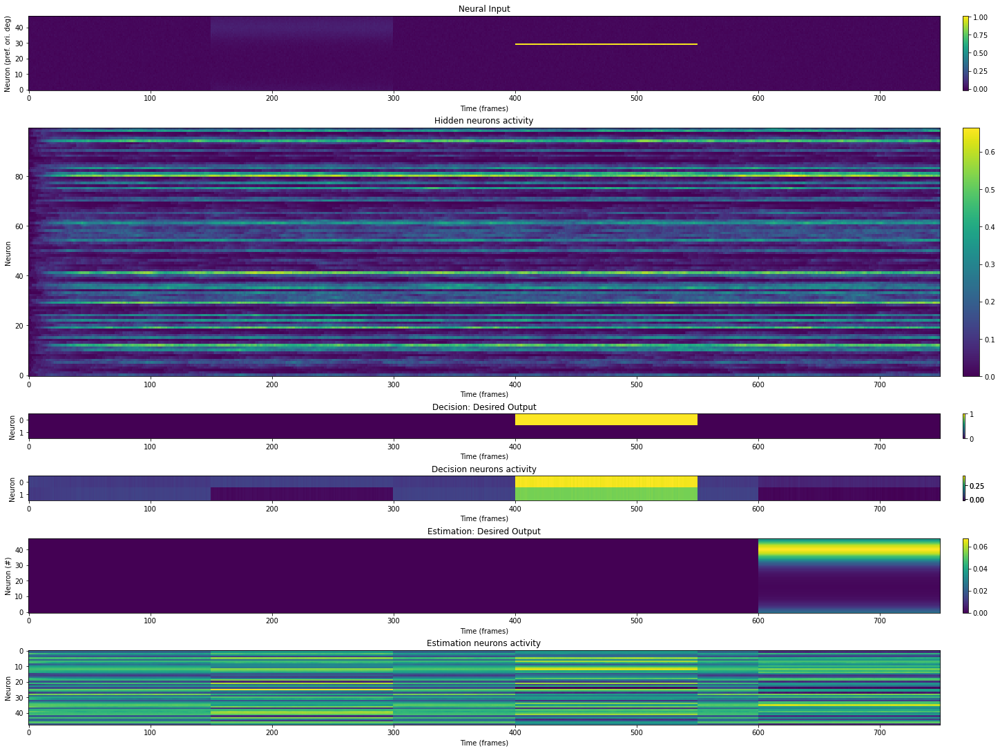

 601/5000 [==>...........................] - ETA: 25910s - Train Loss: 0.4831 - Test Loss: 0.4868 - Test estimation cos error: : 0.6246 - Test decision performance: : 0.5078 - Grads: 0.7655


 Epoch 602, Train Loss: 0.4830501973628998, Test Loss: 0.48682552576065063


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter601/assets


<Figure size 432x288 with 0 Axes>

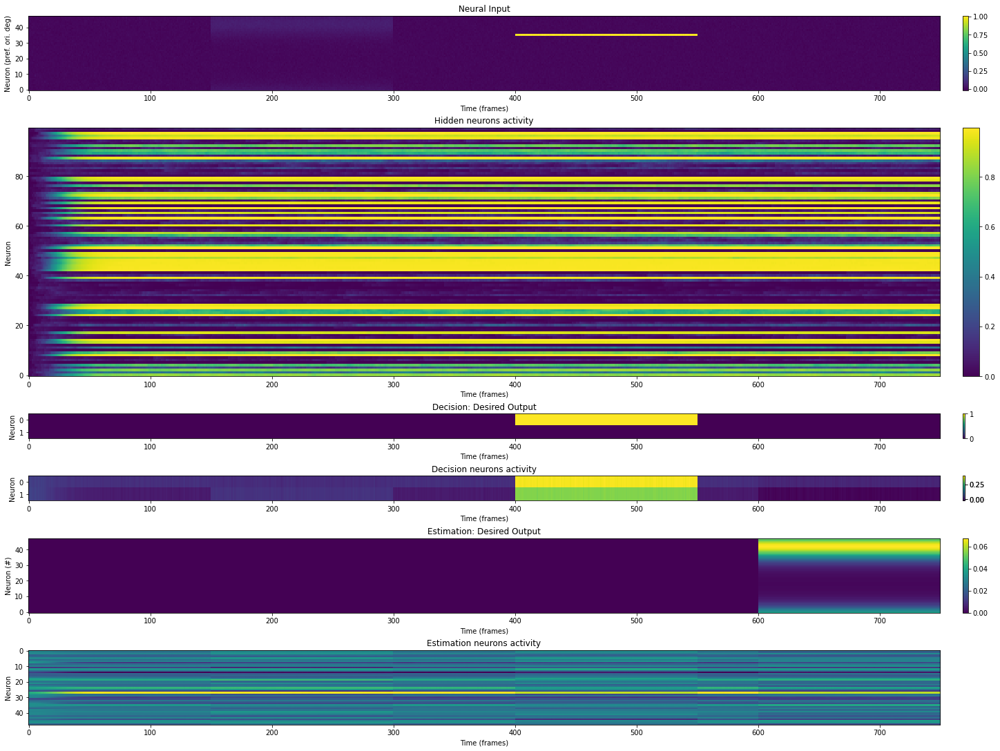

 701/5000 [===>..........................] - ETA: 25391s - Train Loss: 0.4943 - Test Loss: 0.4869 - Test estimation cos error: : 0.6104 - Test decision performance: : 0.4062 - Grads: 0.7861


 Epoch 702, Train Loss: 0.49432364106178284, Test Loss: 0.4868929088115692


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter701/assets


<Figure size 432x288 with 0 Axes>

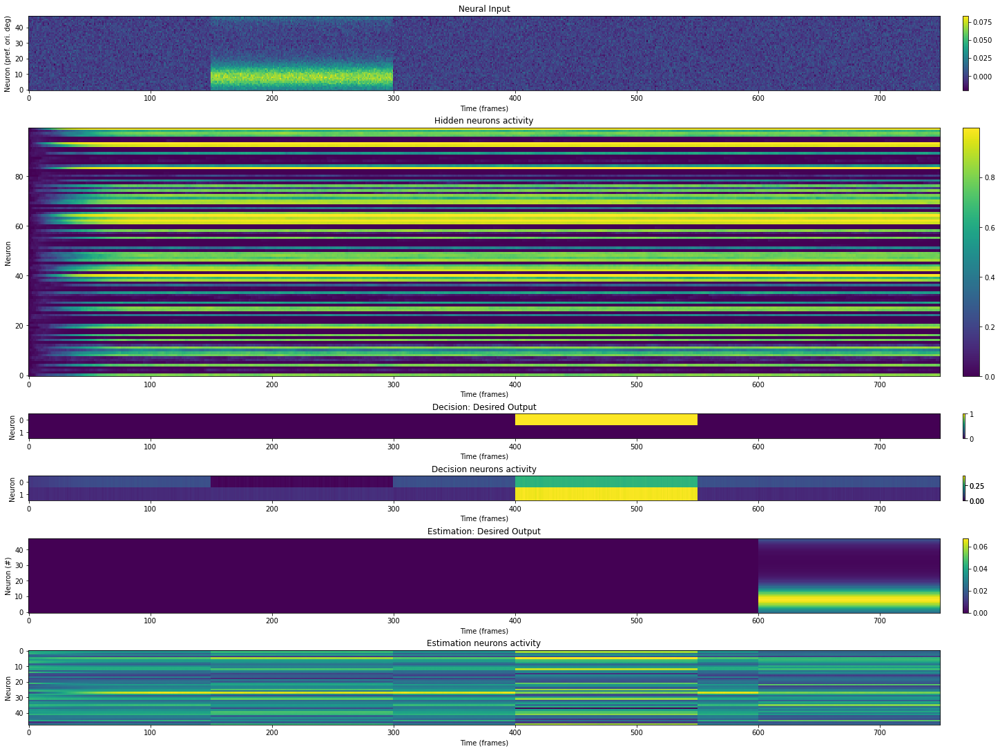

 801/5000 [===>..........................] - ETA: 24775s - Train Loss: 0.4856 - Test Loss: 0.4842 - Test estimation cos error: : 0.6797 - Test decision performance: : 0.5312 - Grads: 0.7671


 Epoch 802, Train Loss: 0.48555952310562134, Test Loss: 0.48416194319725037


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter801/assets


<Figure size 432x288 with 0 Axes>

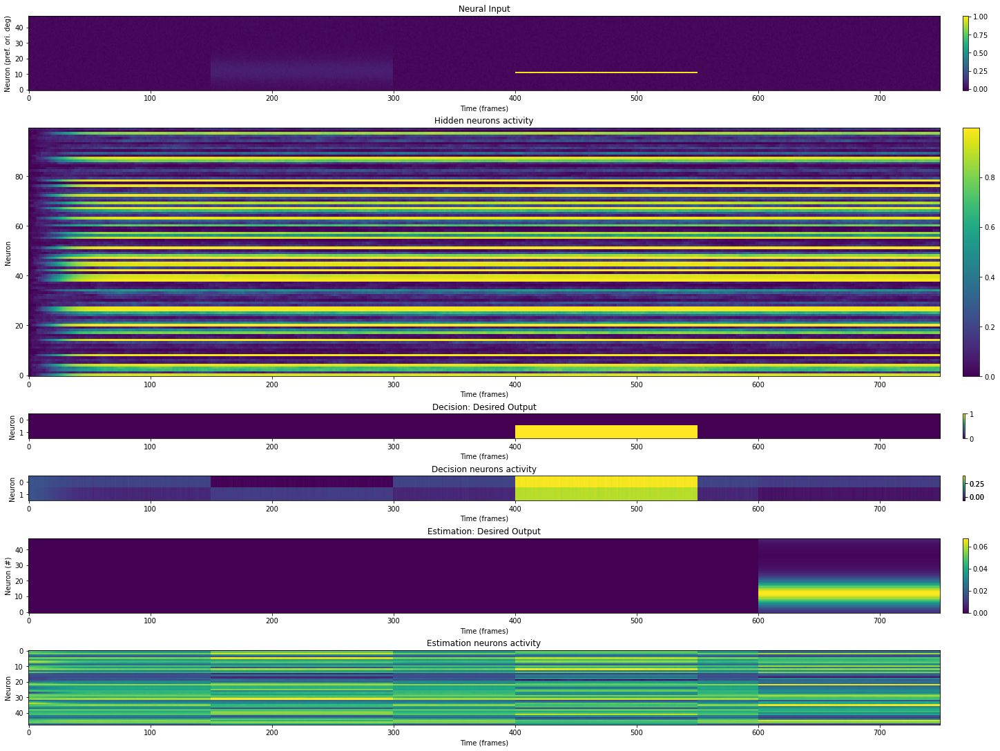

 901/5000 [====>.........................] - ETA: 24205s - Train Loss: 0.4842 - Test Loss: 0.4818 - Test estimation cos error: : 0.6080 - Test decision performance: : 0.5078 - Grads: 0.7673


 Epoch 902, Train Loss: 0.48418304324150085, Test Loss: 0.48182907700538635


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter901/assets


<Figure size 432x288 with 0 Axes>

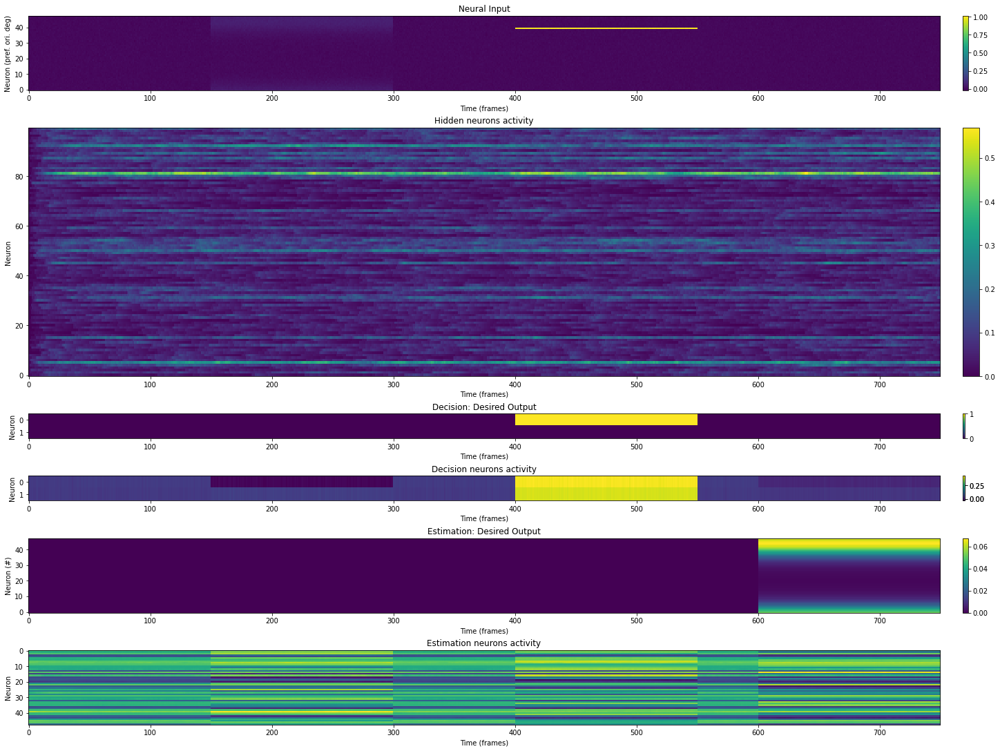

1001/5000 [=====>........................] - ETA: 23644s - Train Loss: 0.4936 - Test Loss: 0.4828 - Test estimation cos error: : 0.6095 - Test decision performance: : 0.4922 - Grads: 0.7889


 Epoch 1002, Train Loss: 0.49360954761505127, Test Loss: 0.4827767312526703


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1001/assets


<Figure size 432x288 with 0 Axes>

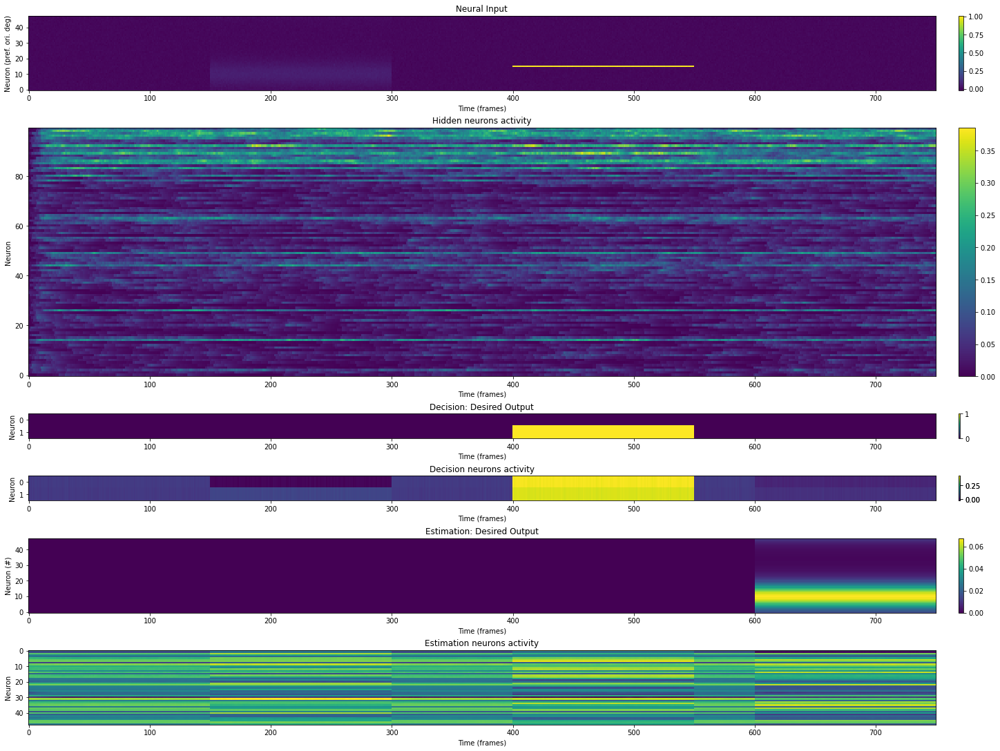

1101/5000 [=====>........................] - ETA: 23037s - Train Loss: 0.4861 - Test Loss: 0.4838 - Test estimation cos error: : 0.6298 - Test decision performance: : 0.4453 - Grads: 0.7698


 Epoch 1102, Train Loss: 0.486082524061203, Test Loss: 0.48377418518066406


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1101/assets


<Figure size 432x288 with 0 Axes>

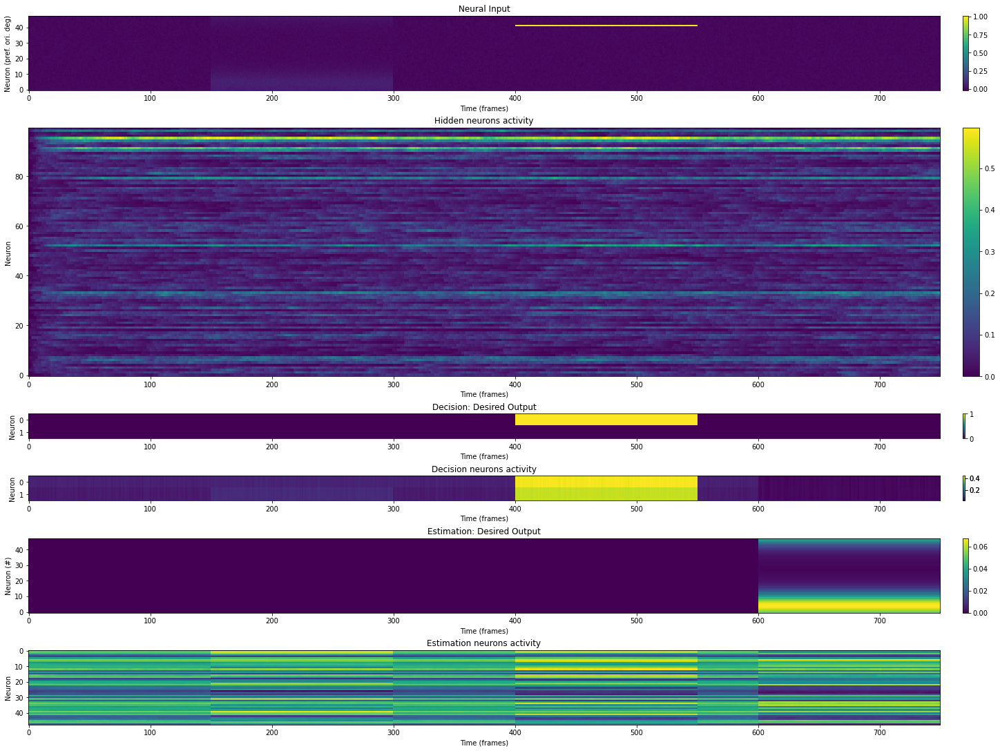

1201/5000 [======>.......................] - ETA: 22434s - Train Loss: 0.4844 - Test Loss: 0.4822 - Test estimation cos error: : 0.6142 - Test decision performance: : 0.4609 - Grads: 0.7762


 Epoch 1202, Train Loss: 0.48436427116394043, Test Loss: 0.48219606280326843


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1201/assets


<Figure size 432x288 with 0 Axes>

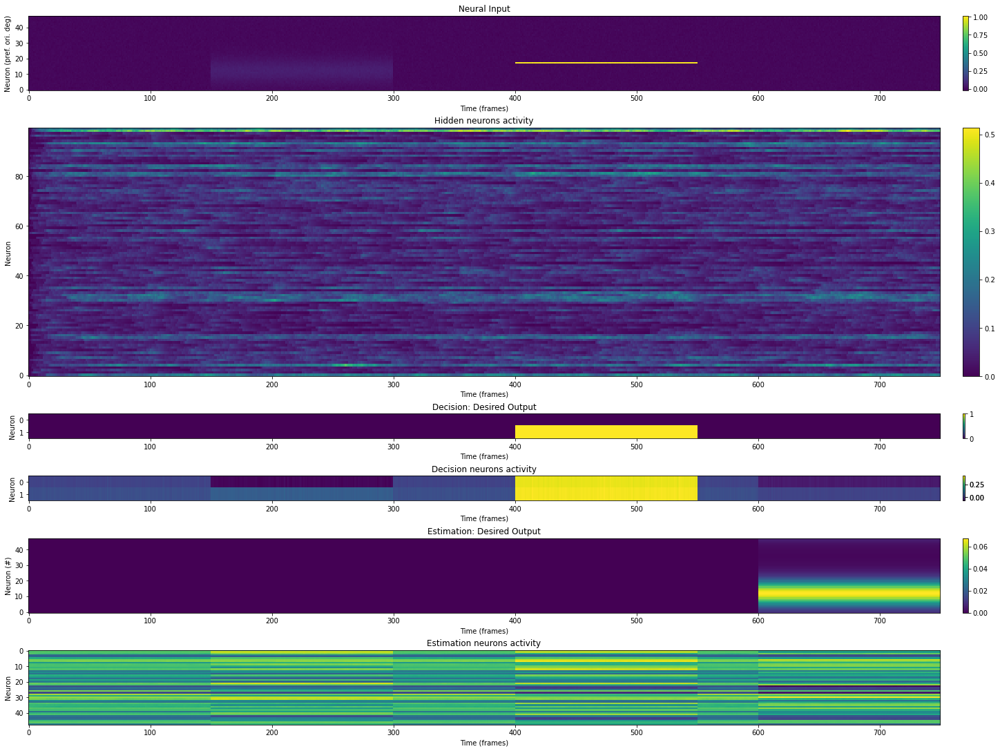

1301/5000 [======>.......................] - ETA: 21839s - Train Loss: 0.4854 - Test Loss: 0.4826 - Test estimation cos error: : 0.6264 - Test decision performance: : 0.4922 - Grads: 0.7735


 Epoch 1302, Train Loss: 0.48539113998413086, Test Loss: 0.4826452136039734


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1301/assets


<Figure size 432x288 with 0 Axes>

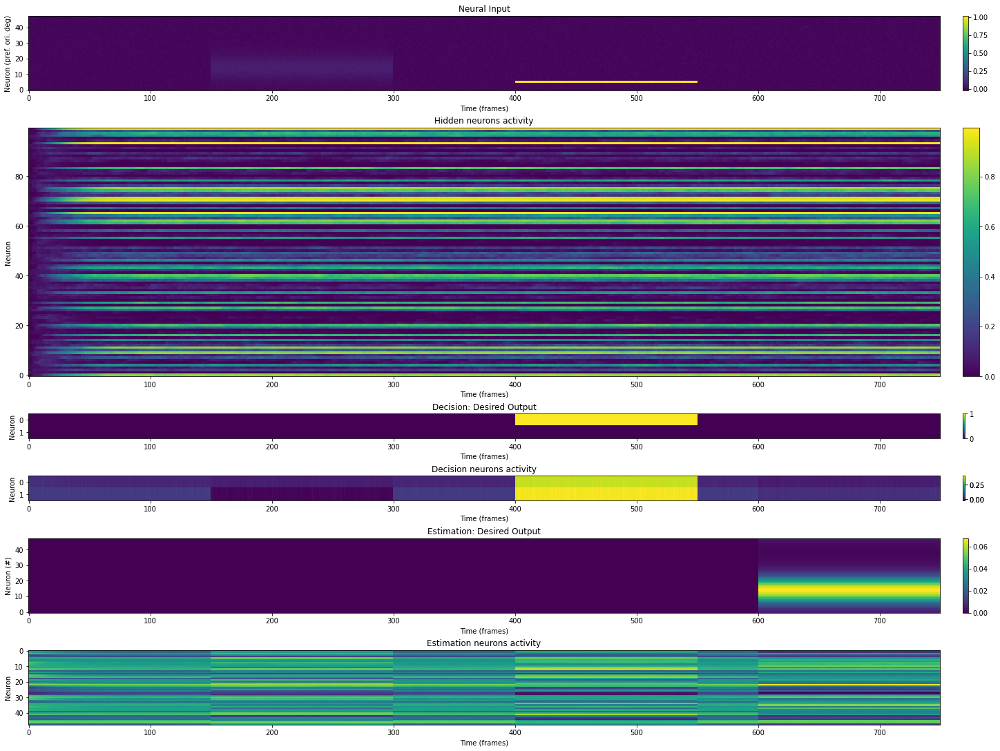

1401/5000 [=======>......................] - ETA: 21233s - Train Loss: 0.4820 - Test Loss: 0.4890 - Test estimation cos error: : 0.6191 - Test decision performance: : 0.5078 - Grads: 0.7656


 Epoch 1402, Train Loss: 0.48197001218795776, Test Loss: 0.48898640275001526


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1401/assets


<Figure size 432x288 with 0 Axes>

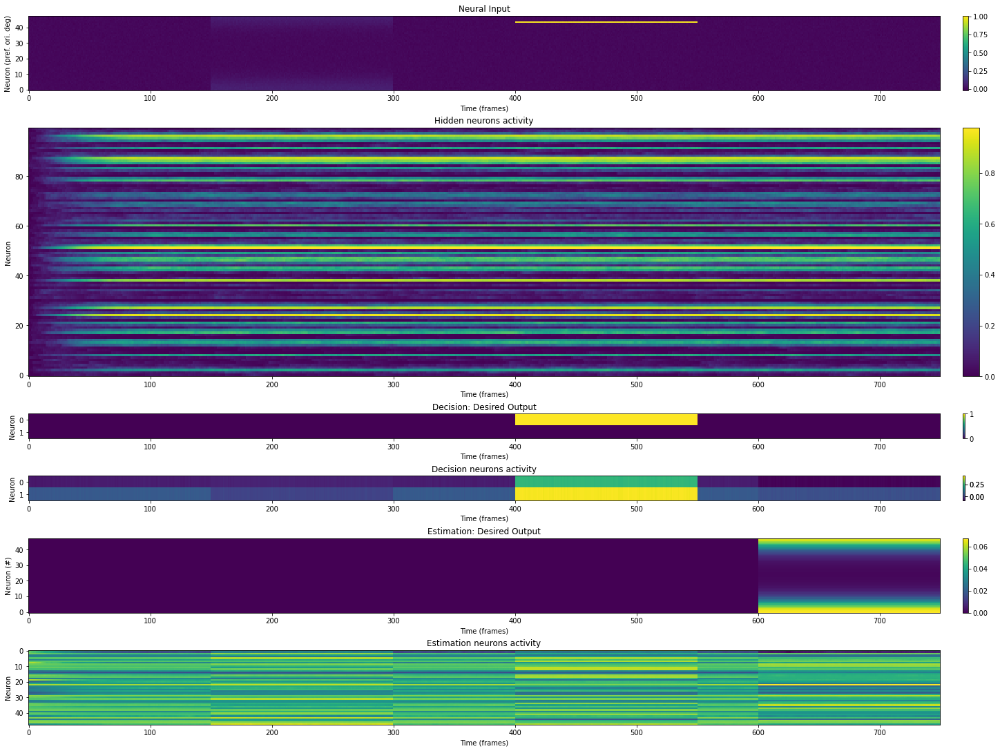

1501/5000 [========>.....................] - ETA: 20647s - Train Loss: 0.4830 - Test Loss: 0.4826 - Test estimation cos error: : 0.6597 - Test decision performance: : 0.4922 - Grads: 0.7673


 Epoch 1502, Train Loss: 0.48296746611595154, Test Loss: 0.4826274812221527


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1501/assets


<Figure size 432x288 with 0 Axes>

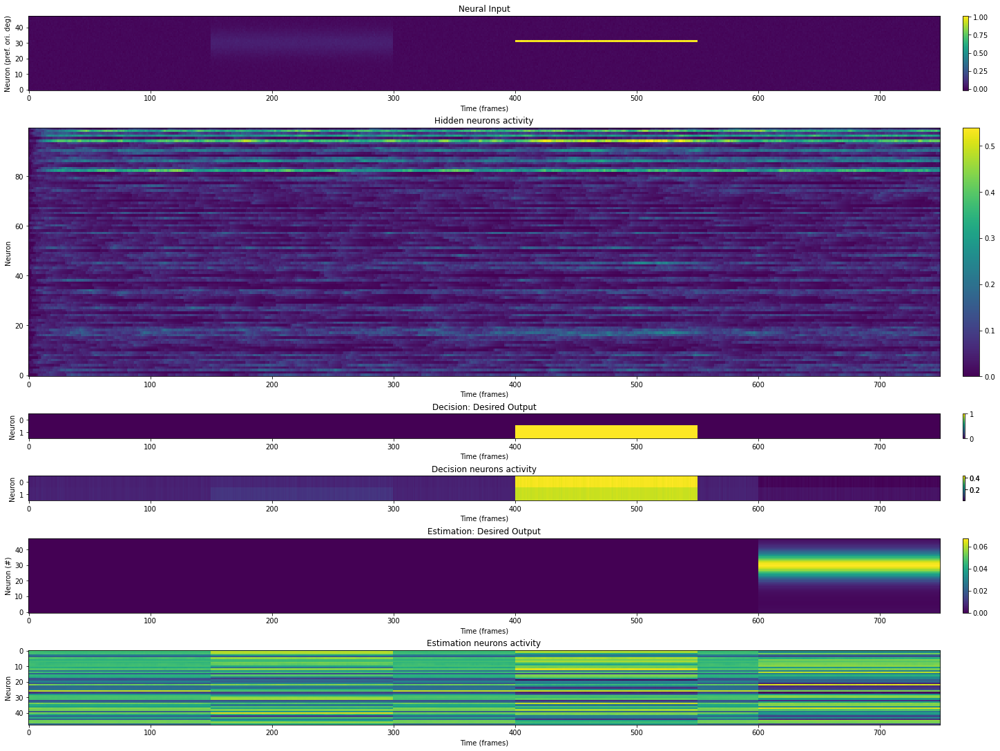

1601/5000 [========>.....................] - ETA: 20054s - Train Loss: 0.4833 - Test Loss: 0.4834 - Test estimation cos error: : 0.6741 - Test decision performance: : 0.4922 - Grads: 0.7655


 Epoch 1602, Train Loss: 0.4833097457885742, Test Loss: 0.4833952486515045


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1601/assets


<Figure size 432x288 with 0 Axes>

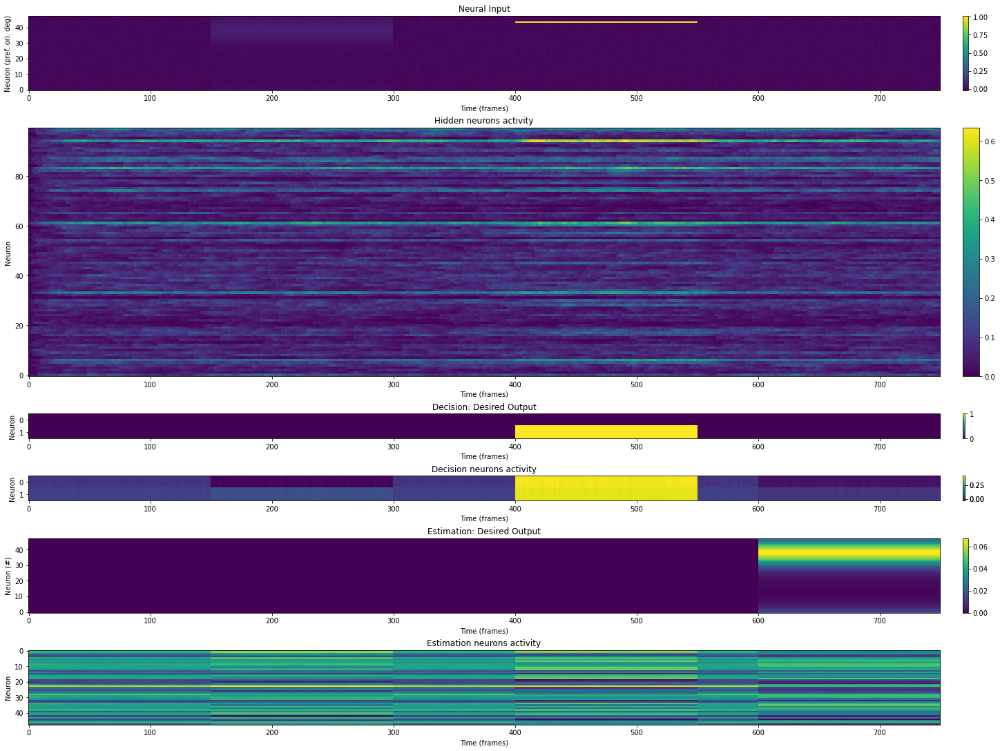

1701/5000 [=========>....................] - ETA: 19452s - Train Loss: 0.4836 - Test Loss: 0.4883 - Test estimation cos error: : 0.5991 - Test decision performance: : 0.4688 - Grads: 0.7683


 Epoch 1702, Train Loss: 0.48364341259002686, Test Loss: 0.4883403182029724


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1701/assets


<Figure size 432x288 with 0 Axes>

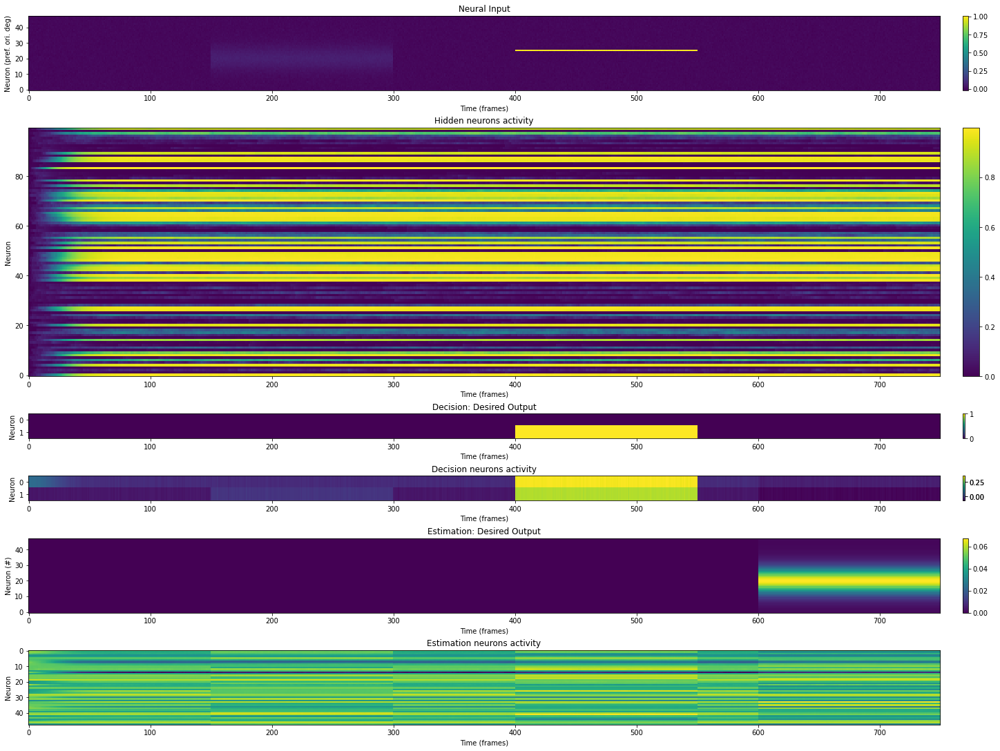

1801/5000 [=========>....................] - ETA: 18849s - Train Loss: 0.4799 - Test Loss: 0.4896 - Test estimation cos error: : 0.6197 - Test decision performance: : 0.4766 - Grads: 0.7659


 Epoch 1802, Train Loss: 0.47988900542259216, Test Loss: 0.48959824442863464


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1801/assets


<Figure size 432x288 with 0 Axes>

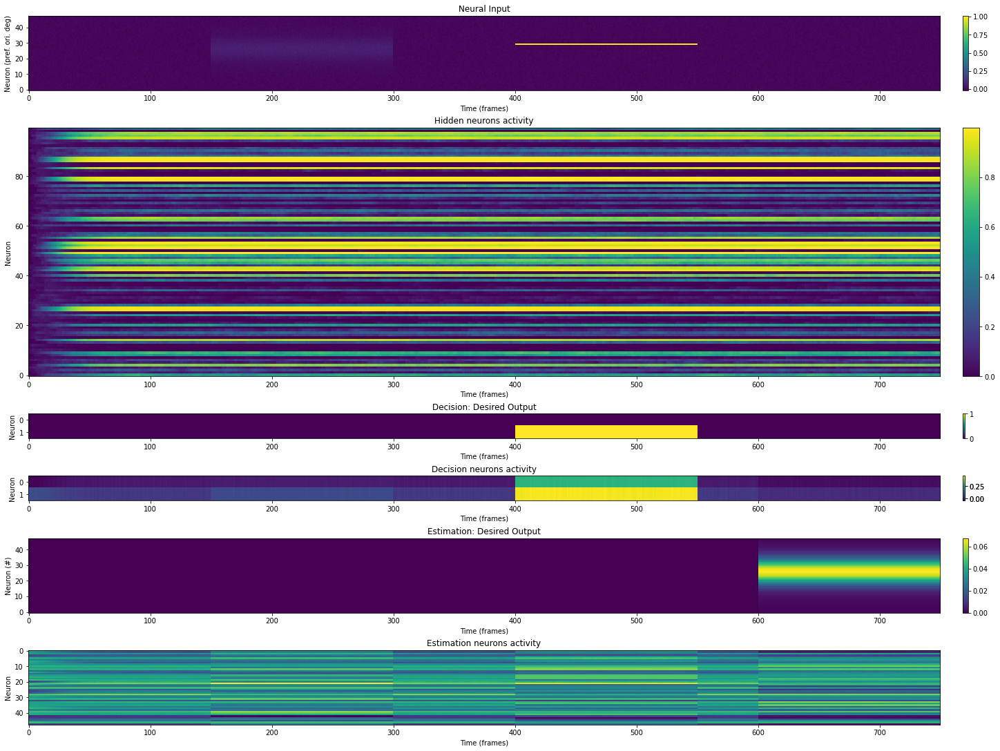

1901/5000 [==========>...................] - ETA: 18253s - Train Loss: 0.4839 - Test Loss: 0.4998 - Test estimation cos error: : 0.6712 - Test decision performance: : 0.5391 - Grads: 0.7707


 Epoch 1902, Train Loss: 0.4839107096195221, Test Loss: 0.4997912347316742


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter1901/assets


<Figure size 432x288 with 0 Axes>

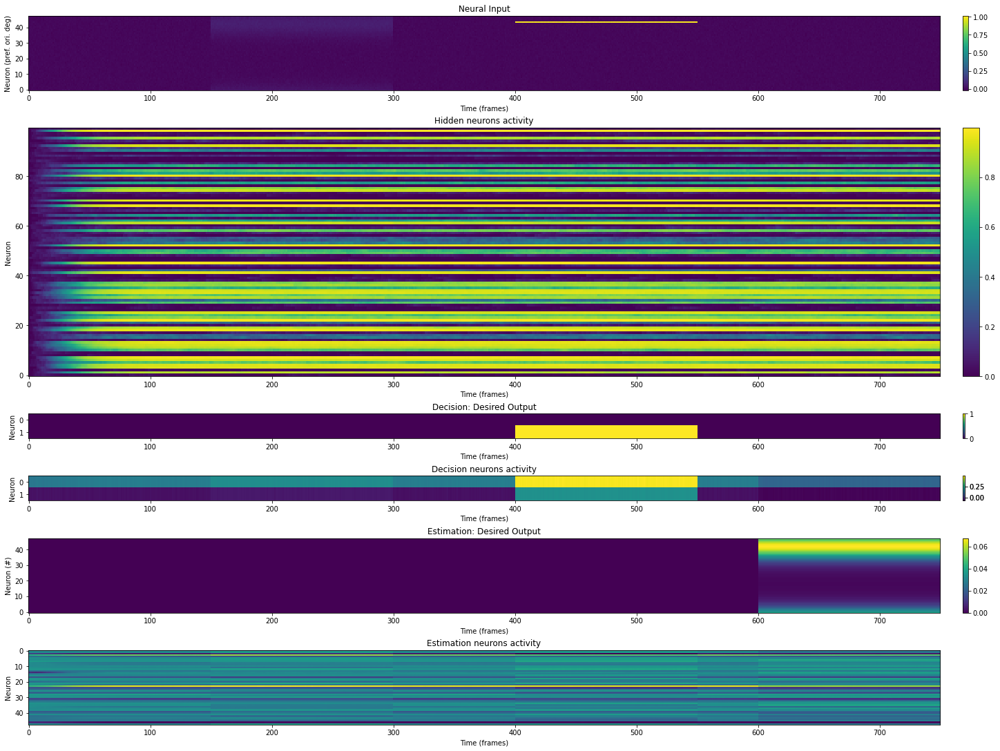

2001/5000 [===========>..................] - ETA: 17655s - Train Loss: 0.4890 - Test Loss: 0.4867 - Test estimation cos error: : 0.6411 - Test decision performance: : 0.4453 - Grads: 0.7733


 Epoch 2002, Train Loss: 0.4890422224998474, Test Loss: 0.4866980314254761


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2001/assets


<Figure size 432x288 with 0 Axes>

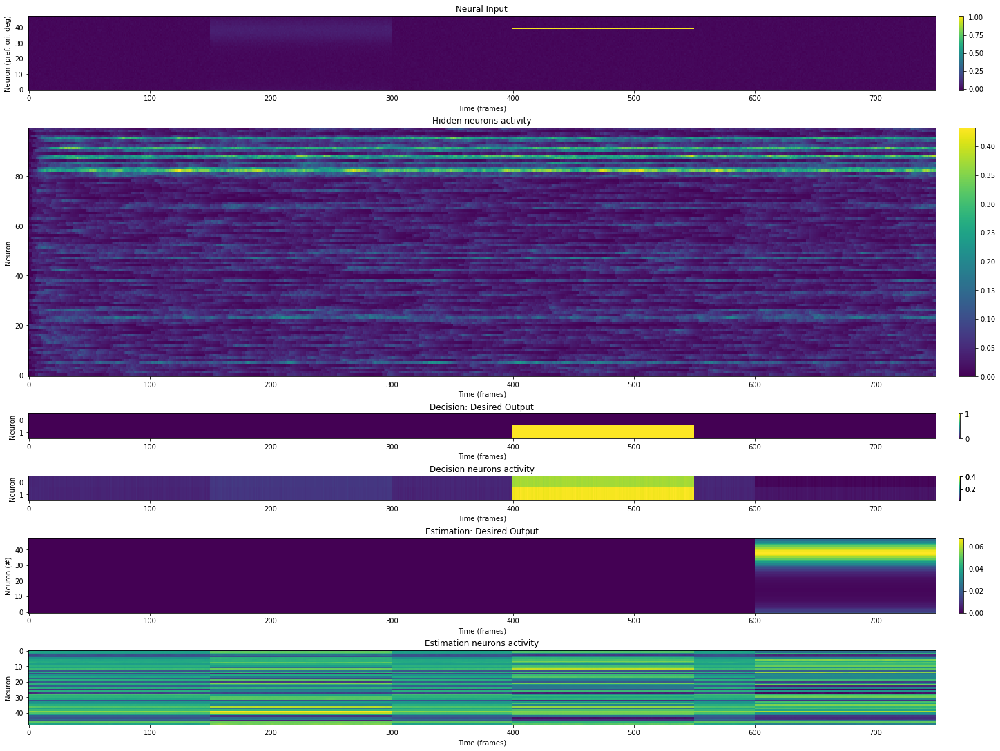

2101/5000 [===========>..................] - ETA: 17059s - Train Loss: 0.4827 - Test Loss: 0.4835 - Test estimation cos error: : 0.6239 - Test decision performance: : 0.5234 - Grads: 0.7687


 Epoch 2102, Train Loss: 0.4826864004135132, Test Loss: 0.4835209250450134


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2101/assets


<Figure size 432x288 with 0 Axes>

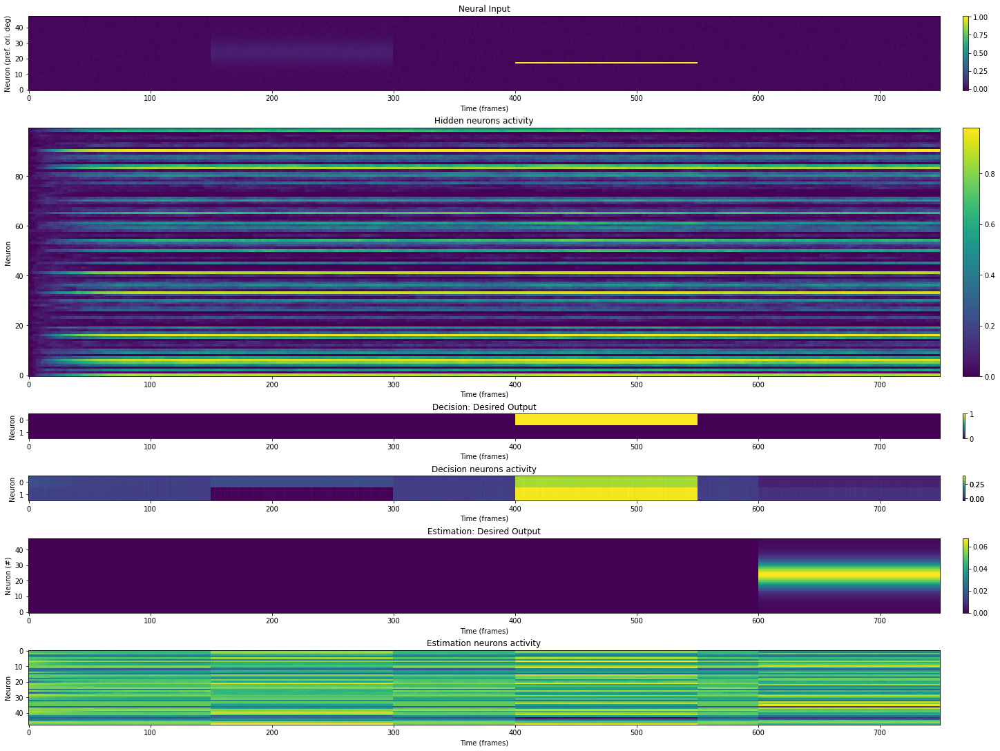

2201/5000 [============>.................] - ETA: 16484s - Train Loss: 0.4883 - Test Loss: 0.4898 - Test estimation cos error: : 0.6392 - Test decision performance: : 0.5156 - Grads: 0.7716


 Epoch 2202, Train Loss: 0.4883398115634918, Test Loss: 0.48978063464164734


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2201/assets


<Figure size 432x288 with 0 Axes>

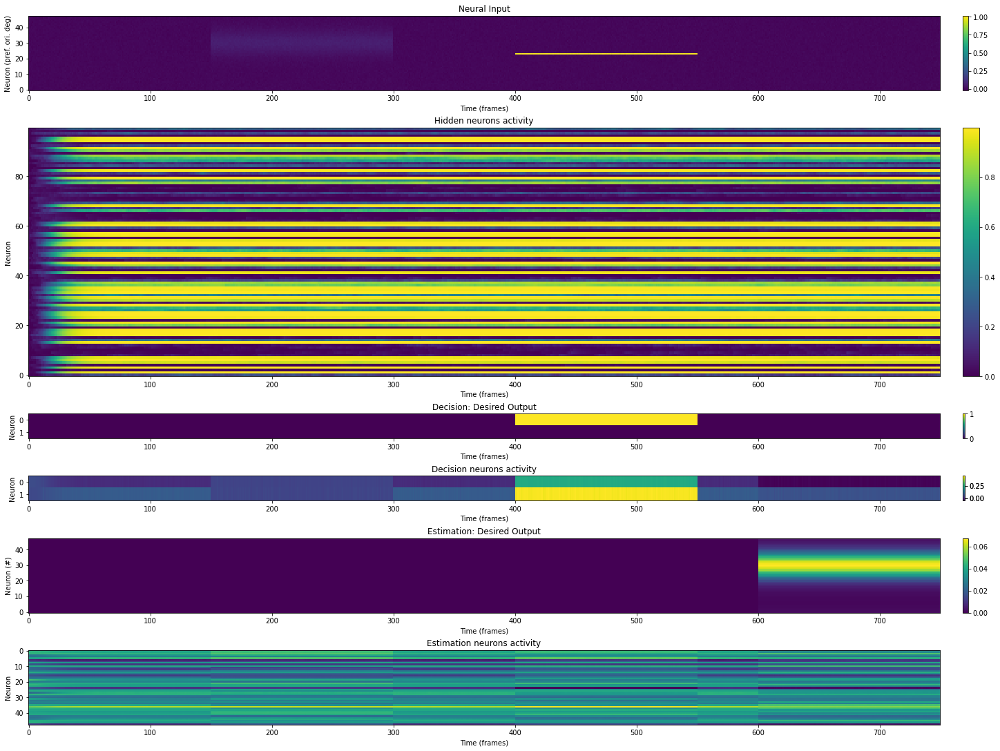

2301/5000 [============>.................] - ETA: 15893s - Train Loss: 0.5004 - Test Loss: 0.4857 - Test estimation cos error: : 0.6173 - Test decision performance: : 0.5234 - Grads: 0.8012


 Epoch 2302, Train Loss: 0.5004044771194458, Test Loss: 0.4857054650783539


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2301/assets


<Figure size 432x288 with 0 Axes>

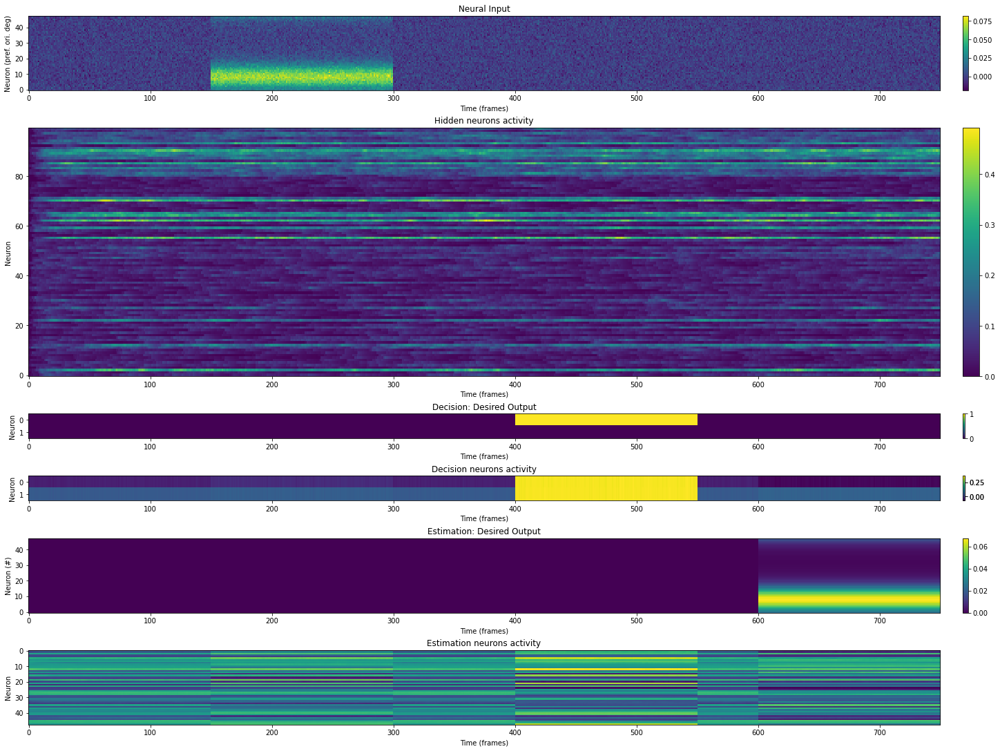

2401/5000 [=============>................] - ETA: 15291s - Train Loss: 0.4982 - Test Loss: 0.4844 - Test estimation cos error: : 0.6438 - Test decision performance: : 0.4453 - Grads: 0.8015


 Epoch 2402, Train Loss: 0.4981567859649658, Test Loss: 0.4844452142715454


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2401/assets


<Figure size 432x288 with 0 Axes>

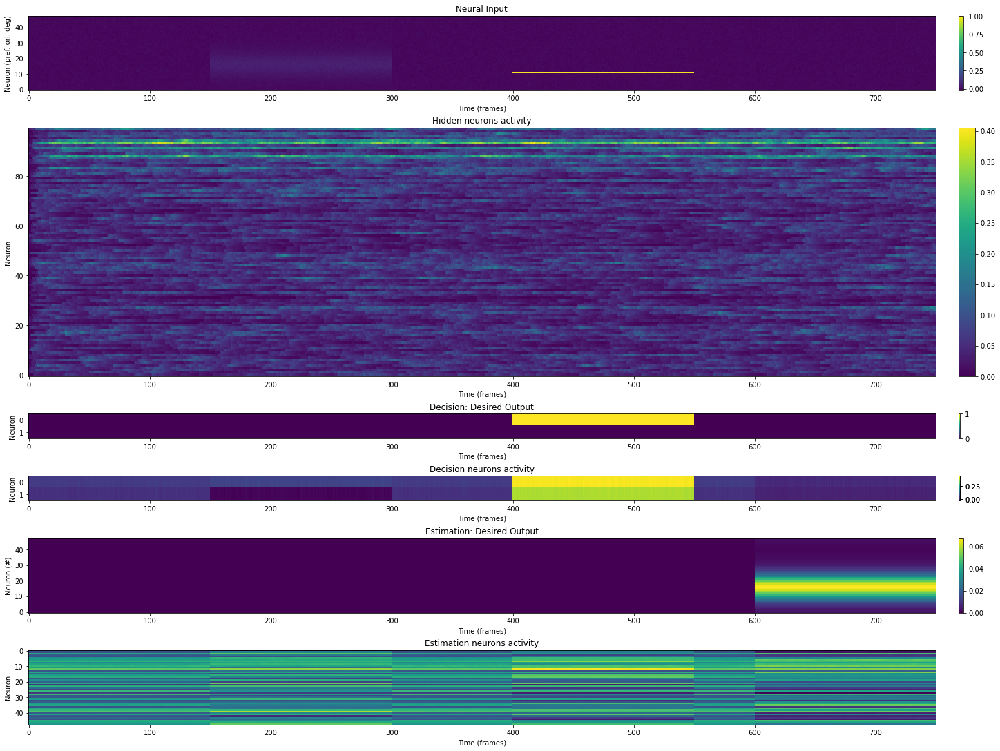

2501/5000 [==============>...............] - ETA: 14693s - Train Loss: 0.5015 - Test Loss: 0.4851 - Test estimation cos error: : 0.6296 - Test decision performance: : 0.4453 - Grads: 0.8021


 Epoch 2502, Train Loss: 0.5014777183532715, Test Loss: 0.4851362705230713


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2501/assets


<Figure size 432x288 with 0 Axes>

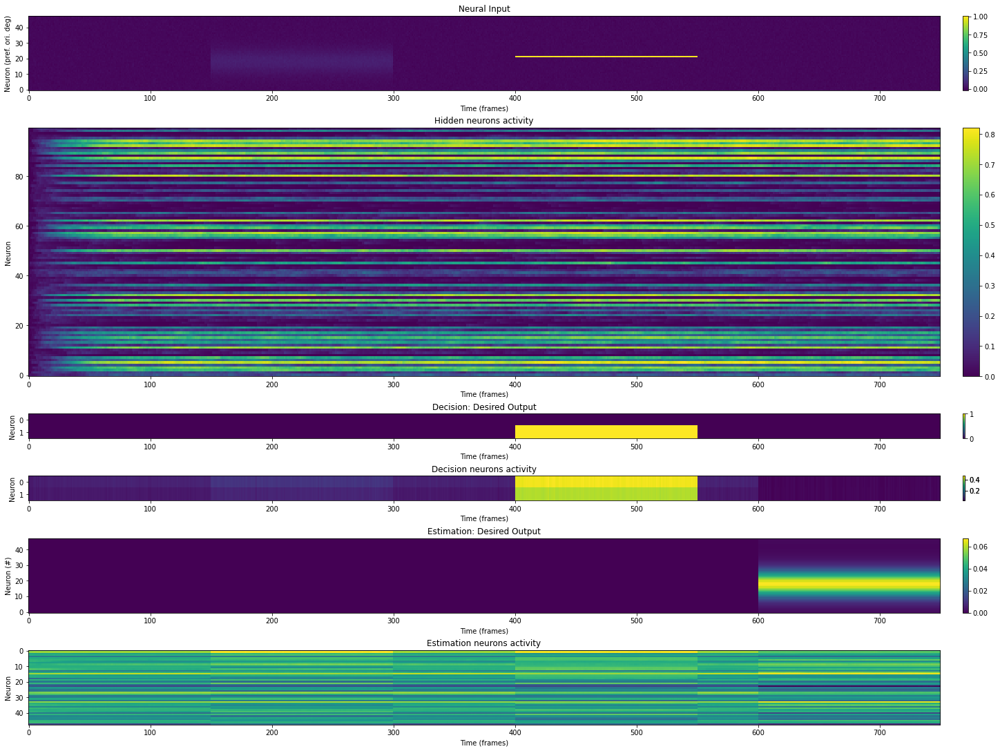

2601/5000 [==============>...............] - ETA: 14103s - Train Loss: 0.4831 - Test Loss: 0.4849 - Test estimation cos error: : 0.6435 - Test decision performance: : 0.4141 - Grads: 0.7665


 Epoch 2602, Train Loss: 0.4830624759197235, Test Loss: 0.4848538637161255


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2601/assets


<Figure size 432x288 with 0 Axes>

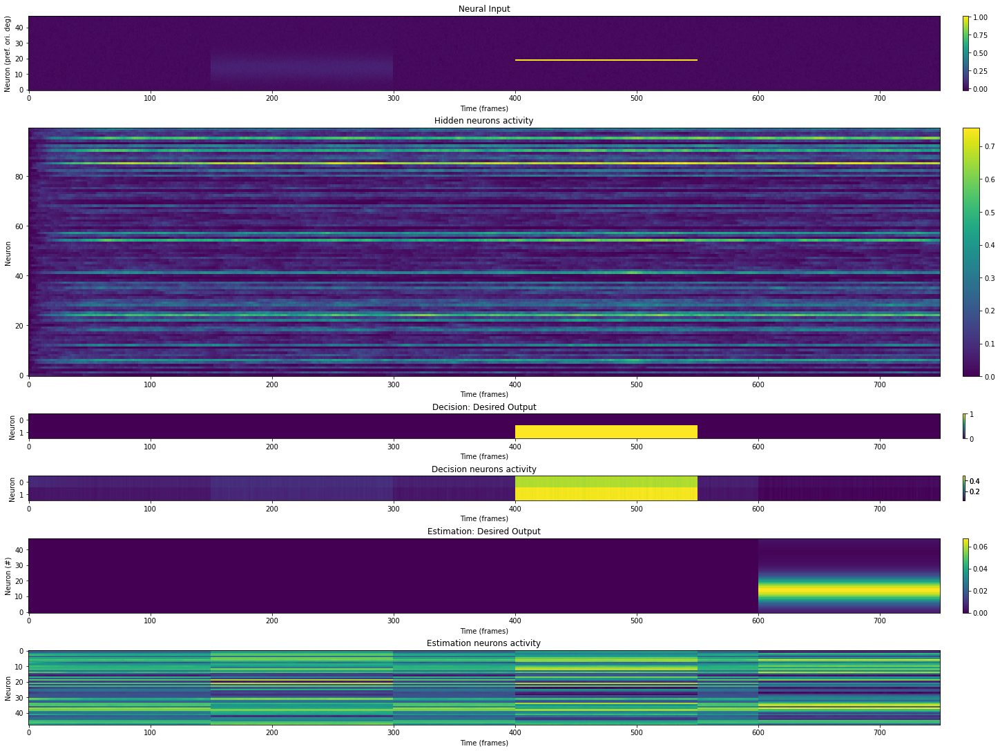

2701/5000 [===============>..............] - ETA: 13514s - Train Loss: 0.4871 - Test Loss: 0.4824 - Test estimation cos error: : 0.6142 - Test decision performance: : 0.5234 - Grads: 0.7726


 Epoch 2702, Train Loss: 0.4871310591697693, Test Loss: 0.4823615849018097


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2701/assets


<Figure size 432x288 with 0 Axes>

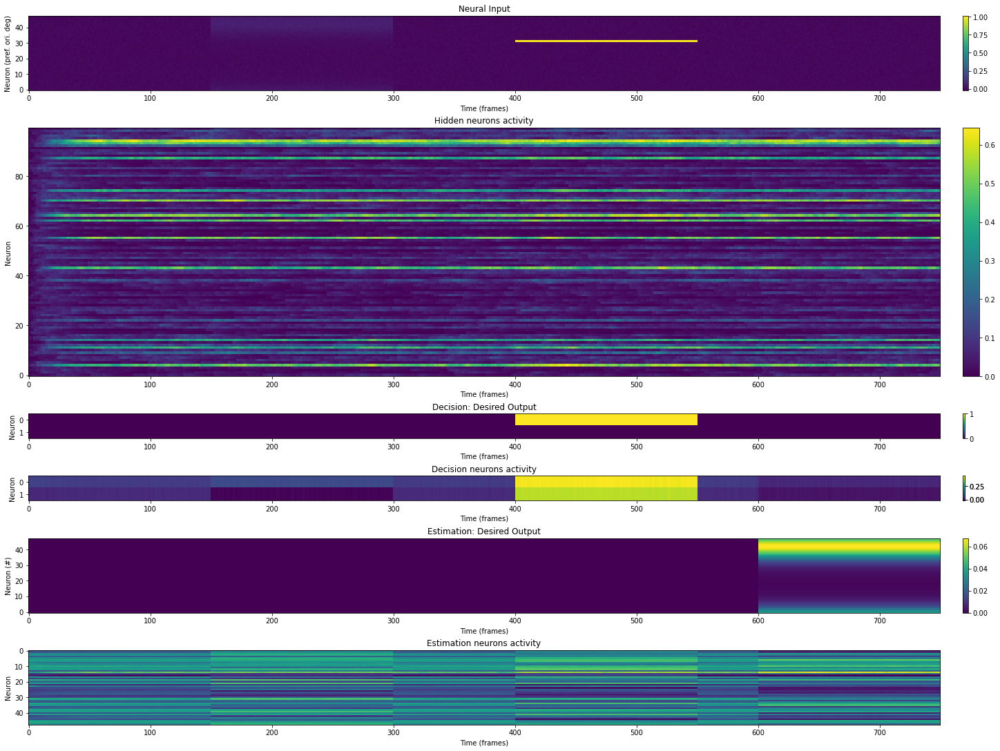

2801/5000 [===============>..............] - ETA: 12932s - Train Loss: 0.4863 - Test Loss: 0.4848 - Test estimation cos error: : 0.6241 - Test decision performance: : 0.4766 - Grads: 0.7750


 Epoch 2802, Train Loss: 0.4862971603870392, Test Loss: 0.4848315119743347


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2801/assets


<Figure size 432x288 with 0 Axes>

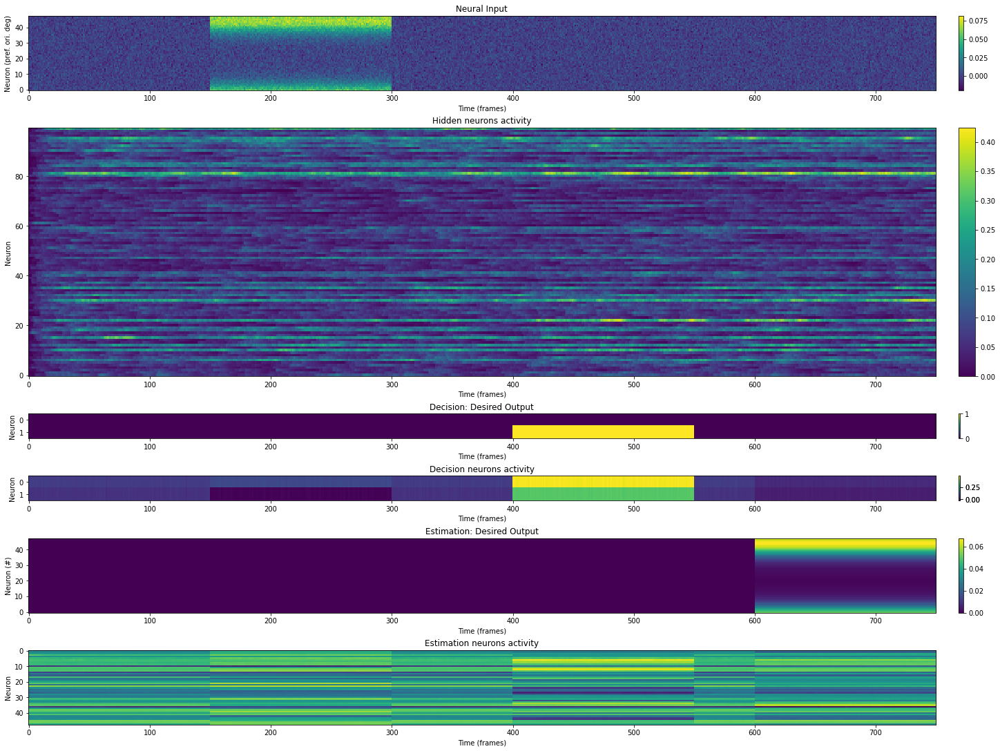

2901/5000 [================>.............] - ETA: 12340s - Train Loss: 0.5309 - Test Loss: 0.5284 - Test estimation cos error: : 0.6193 - Test decision performance: : 0.5156 - Grads: 0.9490


 Epoch 2902, Train Loss: 0.5308532118797302, Test Loss: 0.5284420251846313


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter2901/assets


<Figure size 432x288 with 0 Axes>

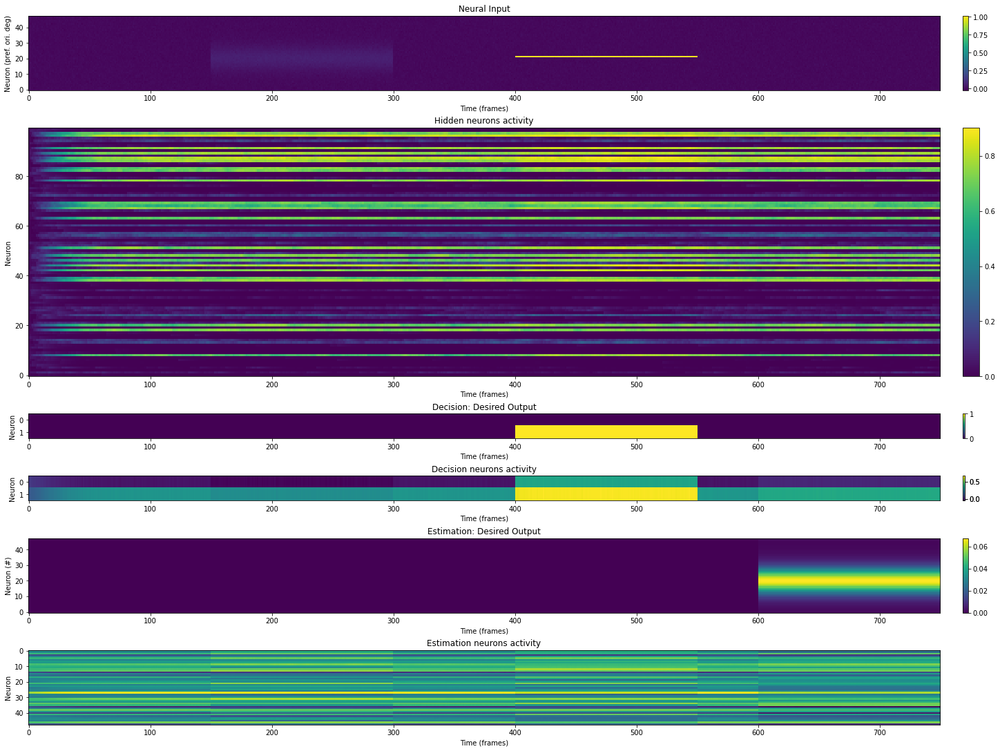

3001/5000 [=================>............] - ETA: 11751s - Train Loss: 0.4826 - Test Loss: 0.4839 - Test estimation cos error: : 0.6185 - Test decision performance: : 0.5000 - Grads: 0.7705


 Epoch 3002, Train Loss: 0.48260897397994995, Test Loss: 0.4839131236076355


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3001/assets


<Figure size 432x288 with 0 Axes>

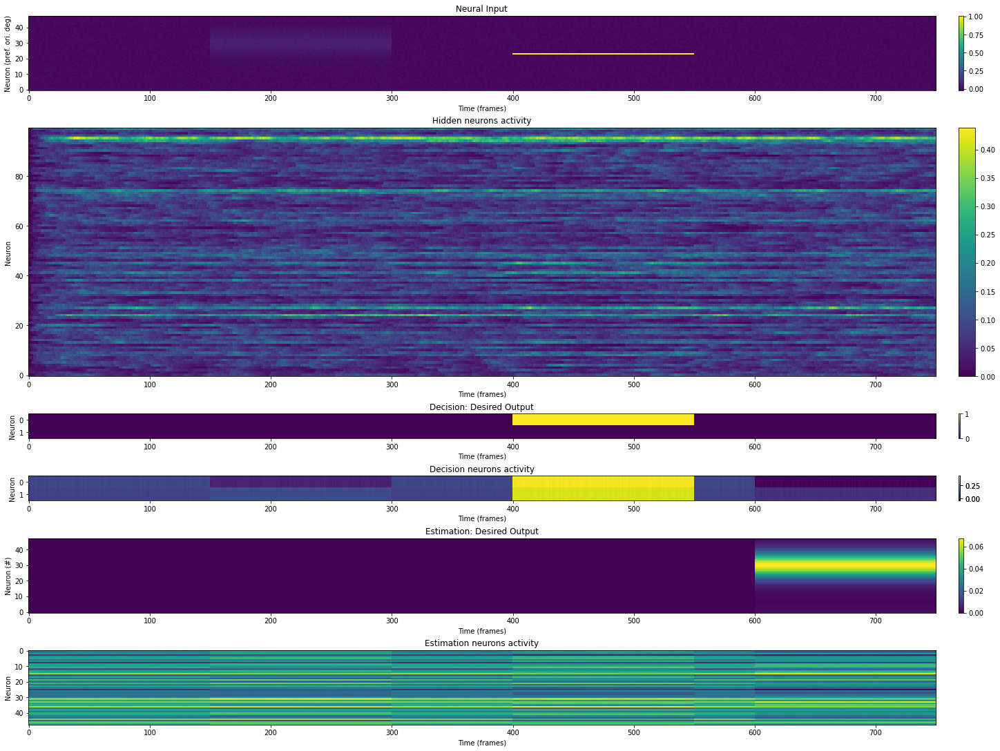

3101/5000 [=================>............] - ETA: 11164s - Train Loss: 0.4896 - Test Loss: 0.4850 - Test estimation cos error: : 0.6390 - Test decision performance: : 0.4688 - Grads: 0.7807


 Epoch 3102, Train Loss: 0.4895516633987427, Test Loss: 0.4849705994129181


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3101/assets


<Figure size 432x288 with 0 Axes>

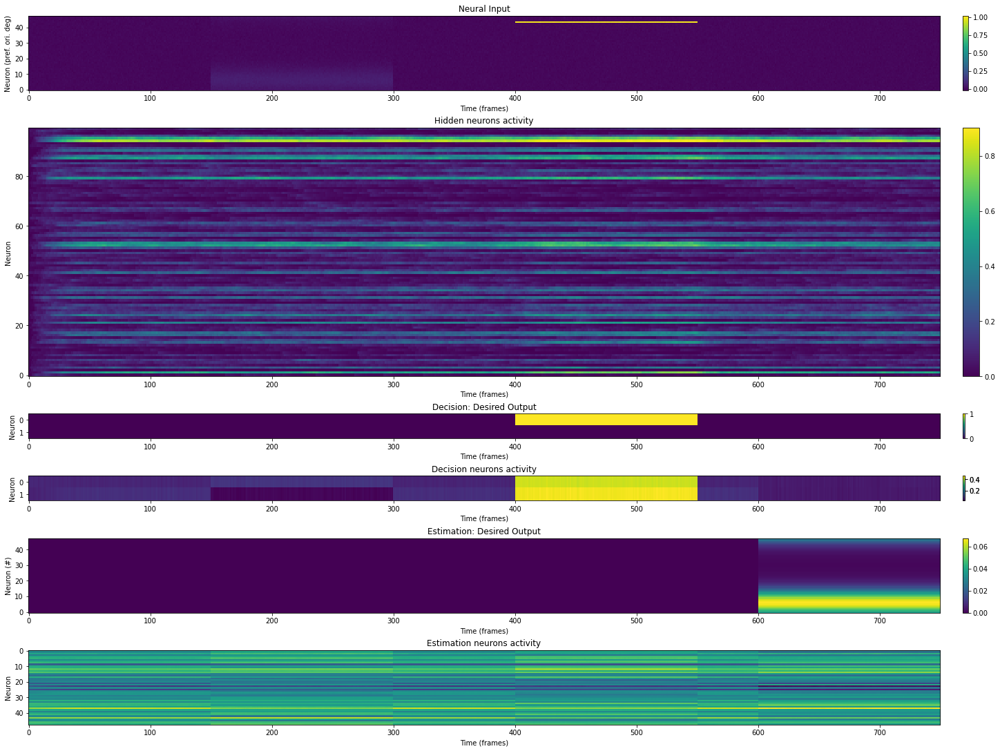

3201/5000 [==================>...........] - ETA: 10574s - Train Loss: 0.4886 - Test Loss: 0.4882 - Test estimation cos error: : 0.6126 - Test decision performance: : 0.4844 - Grads: 0.7893


 Epoch 3202, Train Loss: 0.48863810300827026, Test Loss: 0.4881781041622162


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3201/assets


<Figure size 432x288 with 0 Axes>

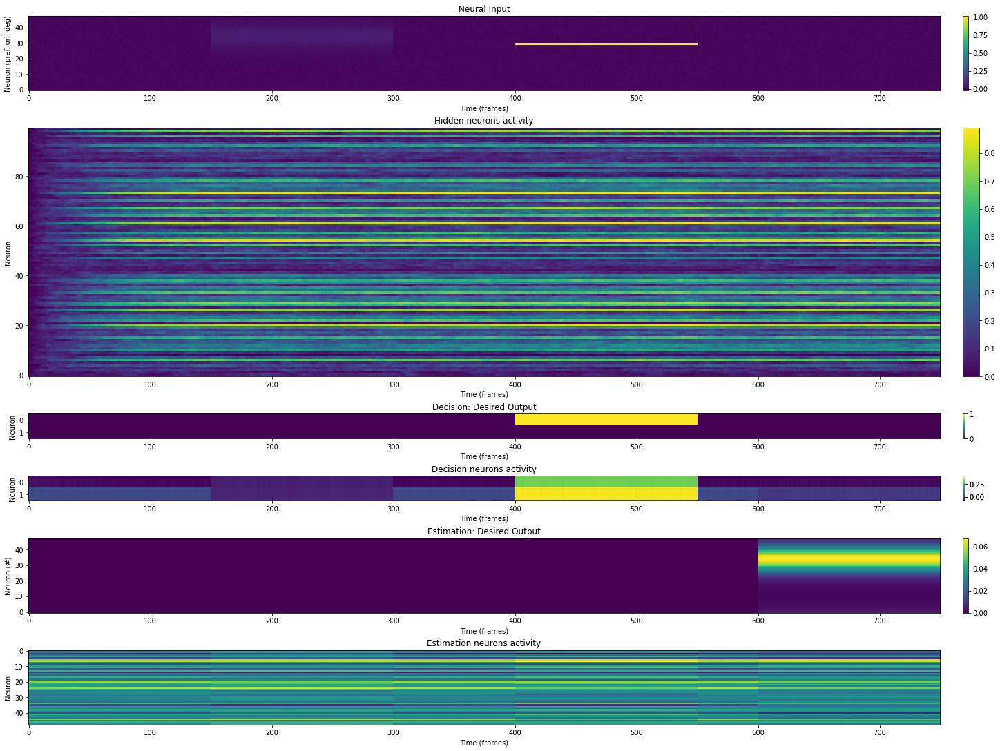

3301/5000 [==================>...........] - ETA: 9987s - Train Loss: 0.4908 - Test Loss: 0.4947 - Test estimation cos error: : 0.6483 - Test decision performance: : 0.5000 - Grads: 0.7772


 Epoch 3302, Train Loss: 0.4908374547958374, Test Loss: 0.4947013854980469


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3301/assets


<Figure size 432x288 with 0 Axes>

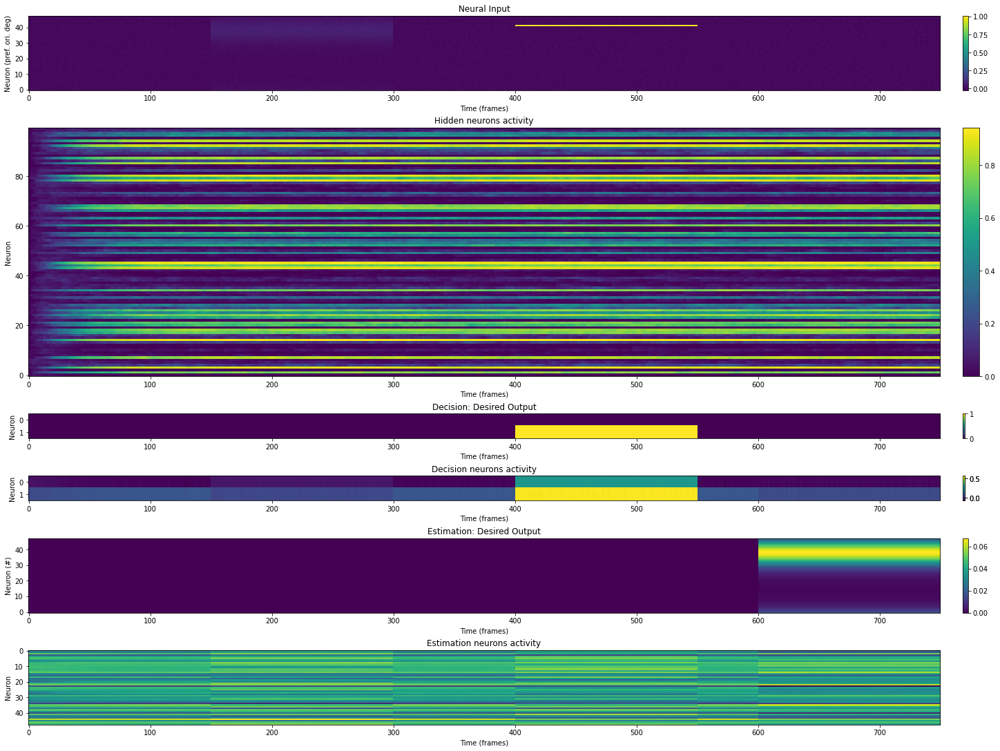

3401/5000 [===================>..........] - ETA: 9412s - Train Loss: 0.4812 - Test Loss: 0.4996 - Test estimation cos error: : 0.6369 - Test decision performance: : 0.4297 - Grads: 0.7705


 Epoch 3402, Train Loss: 0.4812377393245697, Test Loss: 0.49957984685897827


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3401/assets


<Figure size 432x288 with 0 Axes>

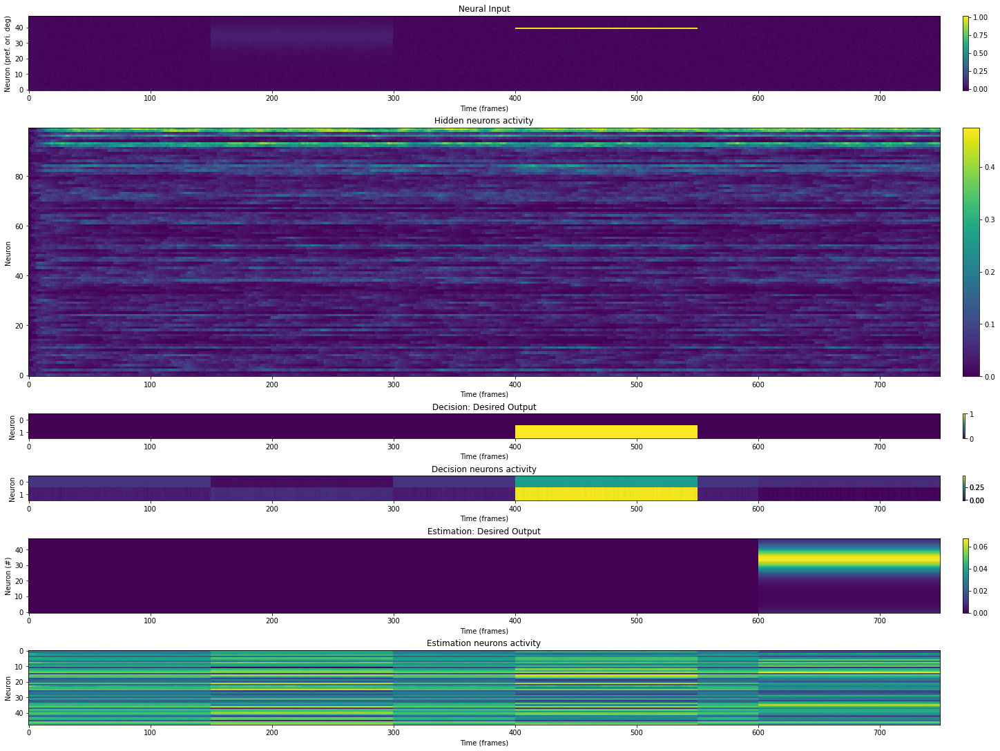

3501/5000 [====================>.........] - ETA: 8827s - Train Loss: 0.4865 - Test Loss: 0.4853 - Test estimation cos error: : 0.6023 - Test decision performance: : 0.5625 - Grads: 0.7673


 Epoch 3502, Train Loss: 0.4865146577358246, Test Loss: 0.4852730631828308


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3501/assets


<Figure size 432x288 with 0 Axes>

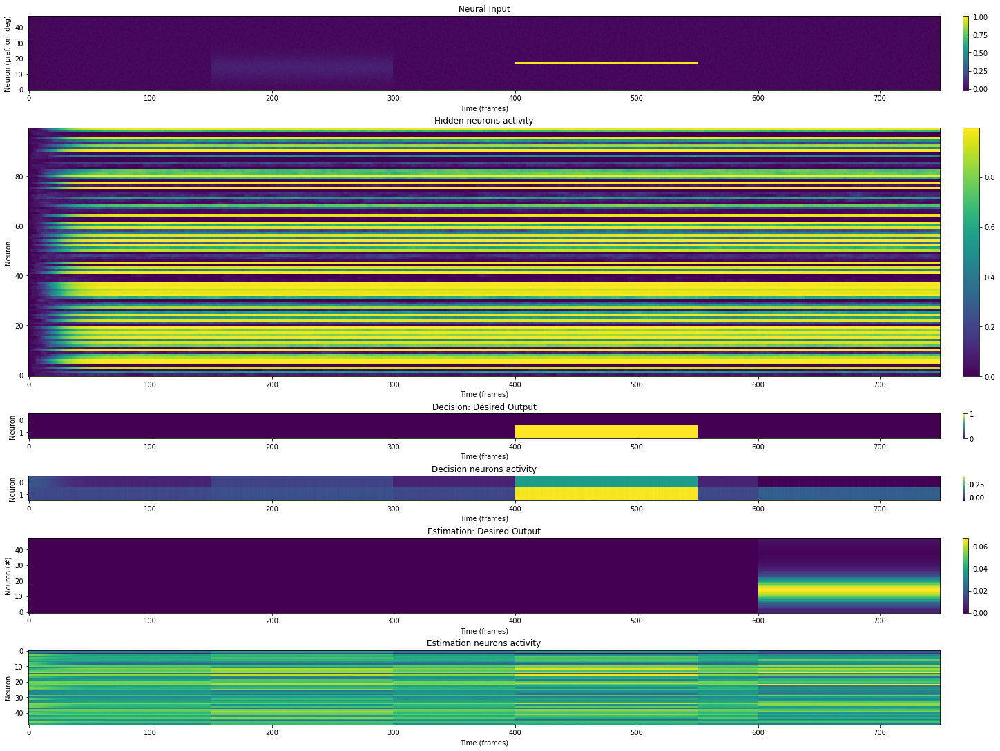

3601/5000 [====================>.........] - ETA: 8242s - Train Loss: 0.4821 - Test Loss: 0.4775 - Test estimation cos error: : 0.6327 - Test decision performance: : 0.5703 - Grads: 0.7662


 Epoch 3602, Train Loss: 0.4820648431777954, Test Loss: 0.4775155484676361


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3601/assets


<Figure size 432x288 with 0 Axes>

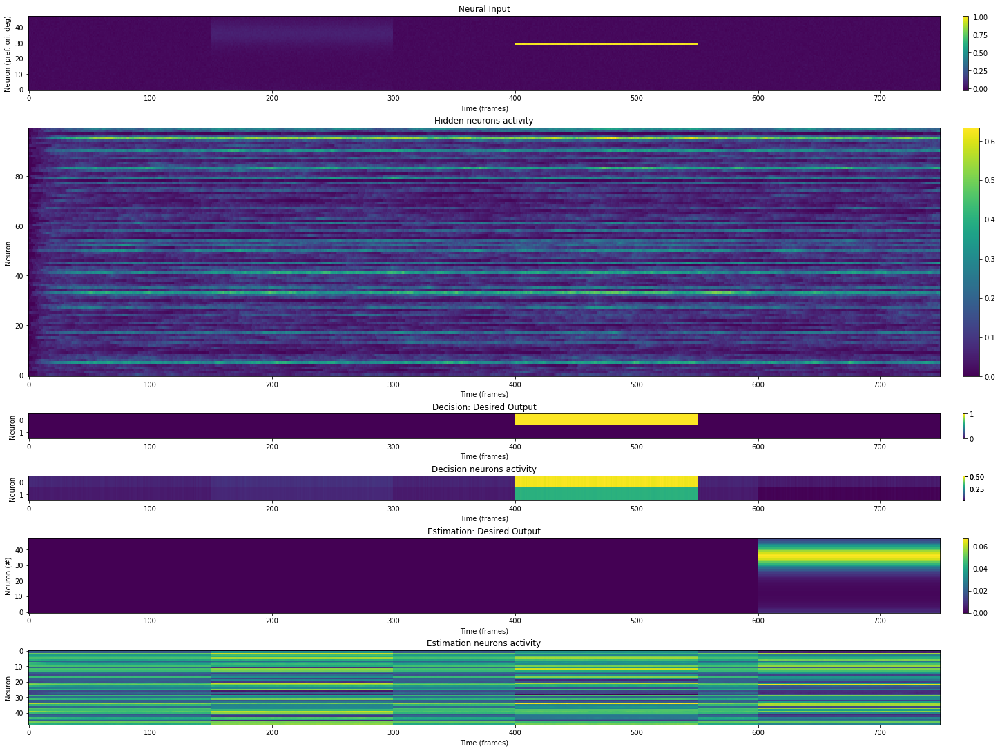

3701/5000 [=====================>........] - ETA: 7663s - Train Loss: 0.4846 - Test Loss: 0.4851 - Test estimation cos error: : 0.6708 - Test decision performance: : 0.4922 - Grads: 0.7716


 Epoch 3702, Train Loss: 0.4846176207065582, Test Loss: 0.48512041568756104


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3701/assets


<Figure size 432x288 with 0 Axes>

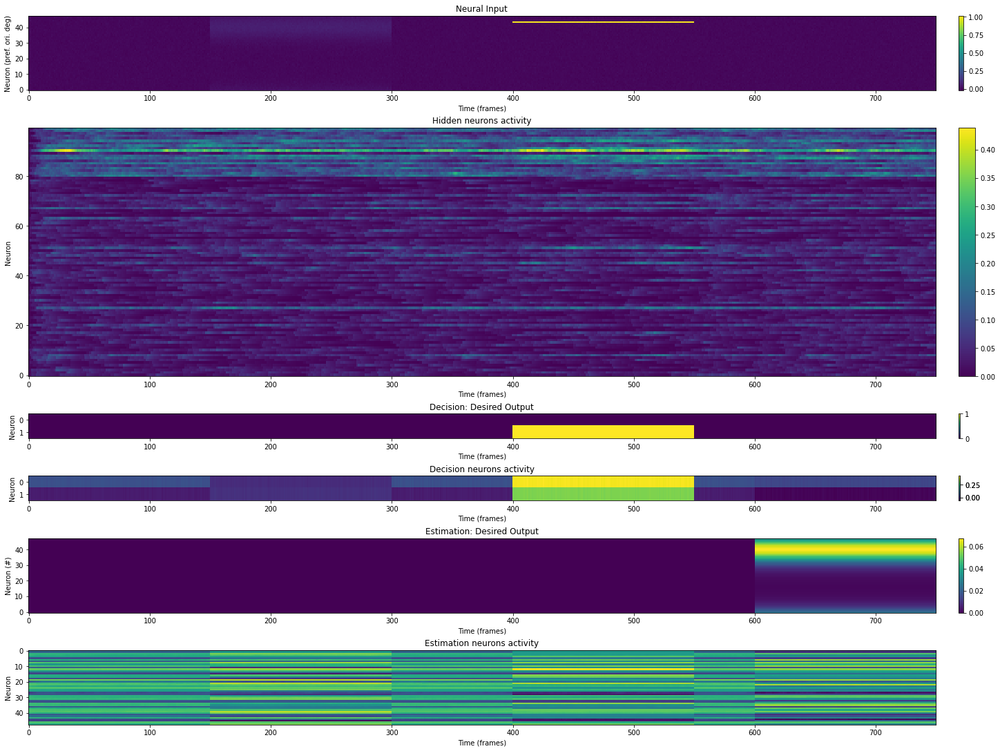

3801/5000 [=====================>........] - ETA: 7087s - Train Loss: 0.5100 - Test Loss: 0.4832 - Test estimation cos error: : 0.6104 - Test decision performance: : 0.6094 - Grads: 0.8401


 Epoch 3802, Train Loss: 0.5099822282791138, Test Loss: 0.4831570088863373


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3801/assets


<Figure size 432x288 with 0 Axes>

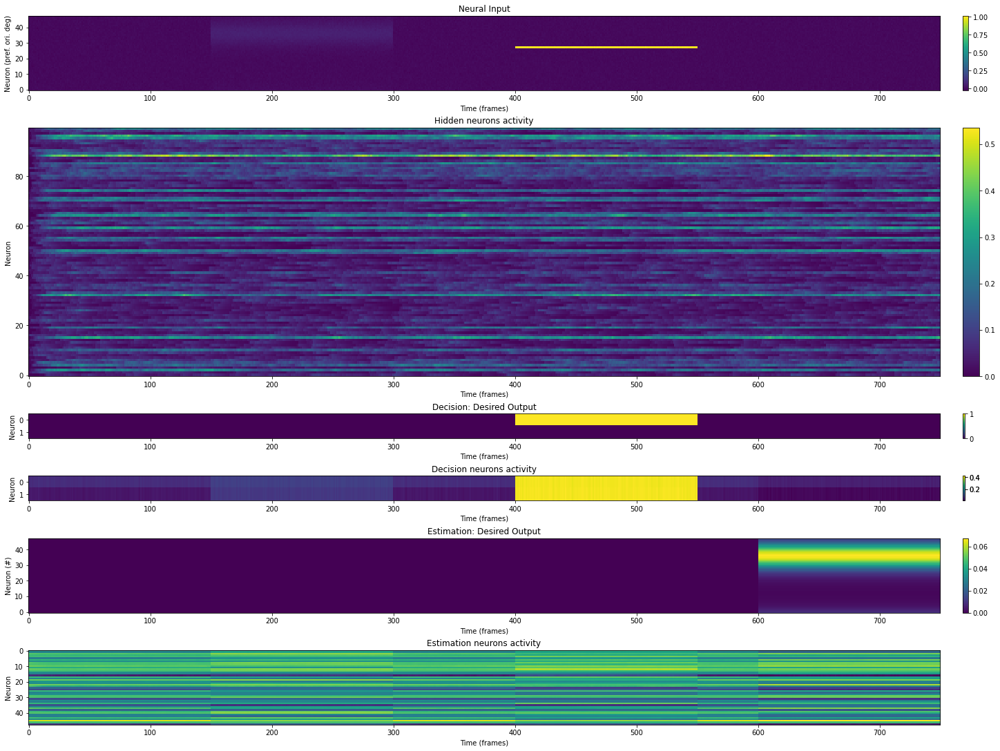

3901/5000 [======================>.......] - ETA: 6510s - Train Loss: 0.4873 - Test Loss: 0.4814 - Test estimation cos error: : 0.6056 - Test decision performance: : 0.5469 - Grads: 0.7675


 Epoch 3902, Train Loss: 0.48733651638031006, Test Loss: 0.4814116954803467


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter3901/assets


<Figure size 432x288 with 0 Axes>

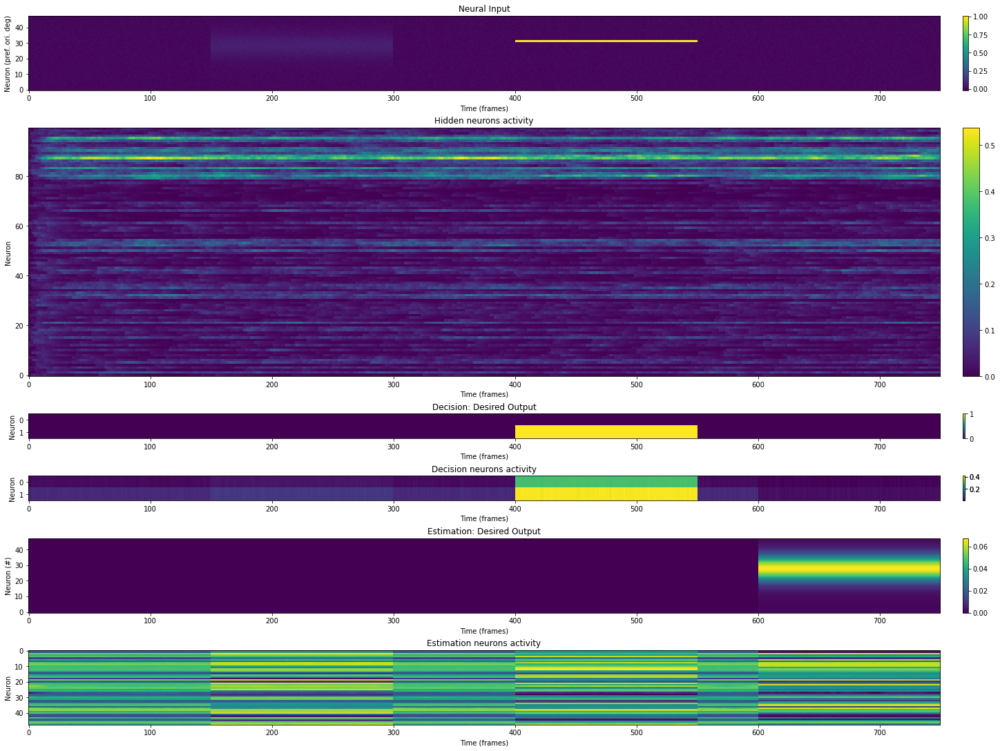

4001/5000 [=======================>......] - ETA: 5929s - Train Loss: 0.4905 - Test Loss: 0.4833 - Test estimation cos error: : 0.5876 - Test decision performance: : 0.5312 - Grads: 0.7775


 Epoch 4002, Train Loss: 0.49045270681381226, Test Loss: 0.4833389222621918


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4001/assets


<Figure size 432x288 with 0 Axes>

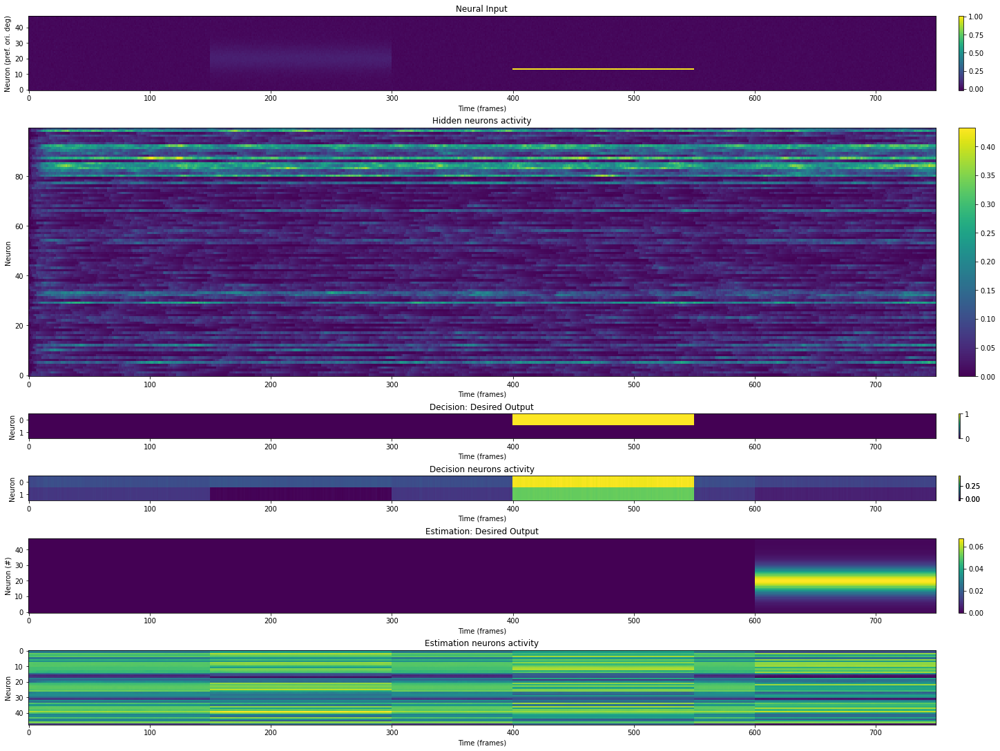

4101/5000 [=======================>......] - ETA: 5345s - Train Loss: 0.4856 - Test Loss: 0.4960 - Test estimation cos error: : 0.6499 - Test decision performance: : 0.4609 - Grads: 0.7741


 Epoch 4102, Train Loss: 0.48564133048057556, Test Loss: 0.49600547552108765


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4101/assets


<Figure size 432x288 with 0 Axes>

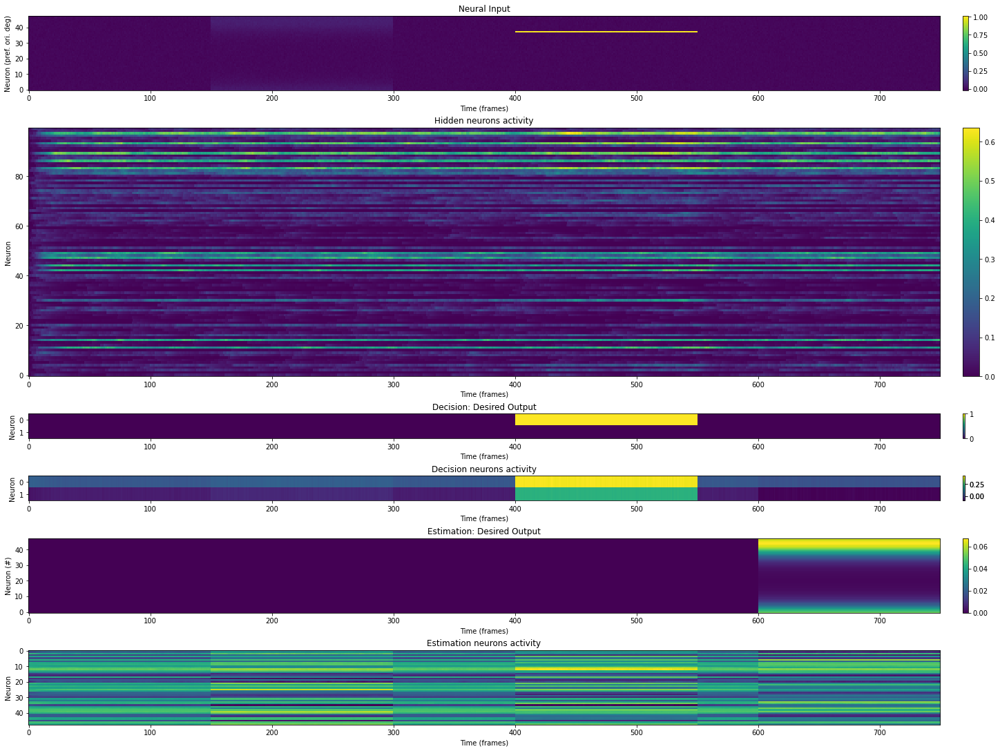

4201/5000 [========================>.....] - ETA: 4757s - Train Loss: 0.4965 - Test Loss: 0.4779 - Test estimation cos error: : 0.5841 - Test decision performance: : 0.5781 - Grads: 0.8109


 Epoch 4202, Train Loss: 0.49652302265167236, Test Loss: 0.4778943955898285


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4201/assets


<Figure size 432x288 with 0 Axes>

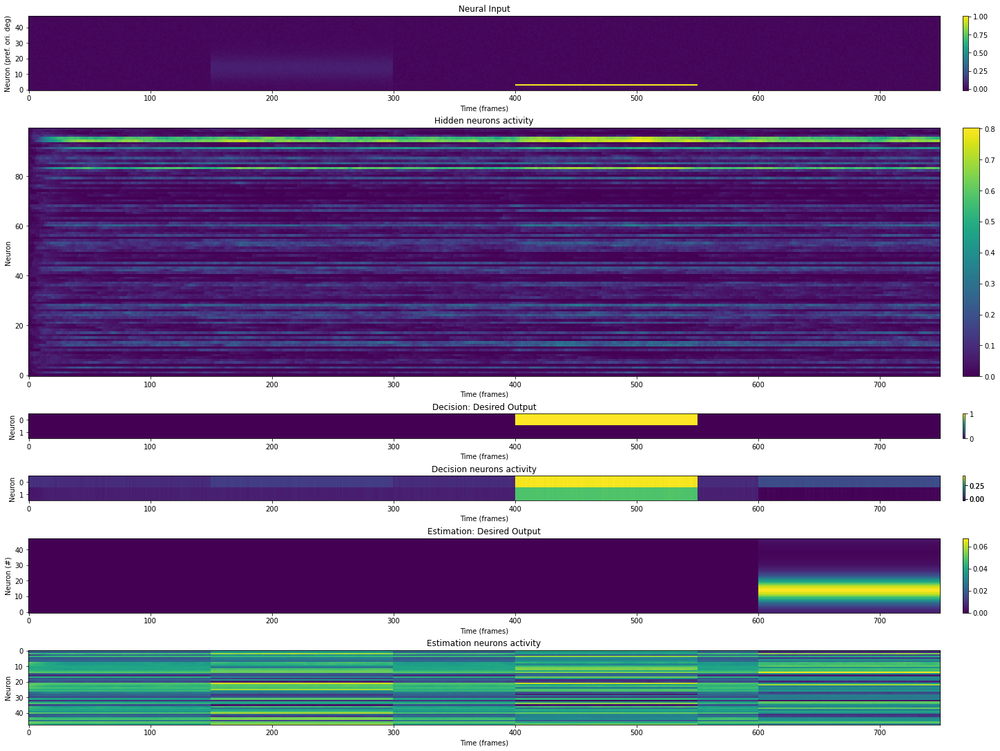

4301/5000 [========================>.....] - ETA: 4167s - Train Loss: 0.4927 - Test Loss: 0.4870 - Test estimation cos error: : 0.6421 - Test decision performance: : 0.4922 - Grads: 0.7811


 Epoch 4302, Train Loss: 0.4927394390106201, Test Loss: 0.4870283901691437


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4301/assets


<Figure size 432x288 with 0 Axes>

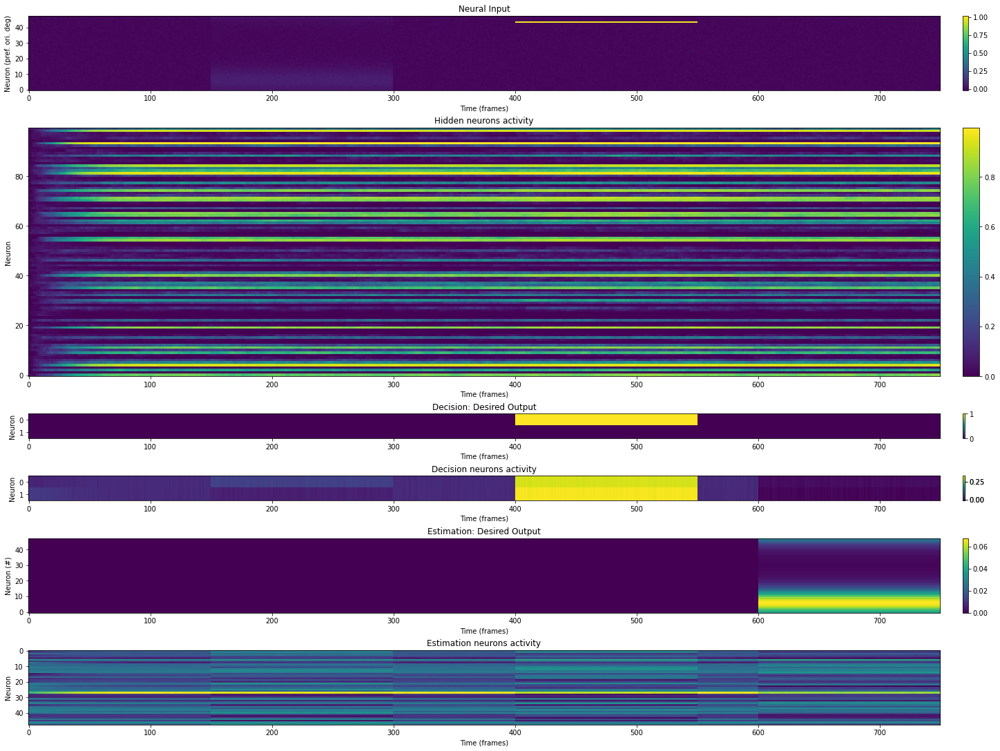

4401/5000 [=========================>....] - ETA: 3576s - Train Loss: 0.4992 - Test Loss: 0.4894 - Test estimation cos error: : 0.5990 - Test decision performance: : 0.4375 - Grads: 0.7935


 Epoch 4402, Train Loss: 0.4992386996746063, Test Loss: 0.4893827438354492


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4401/assets


<Figure size 432x288 with 0 Axes>

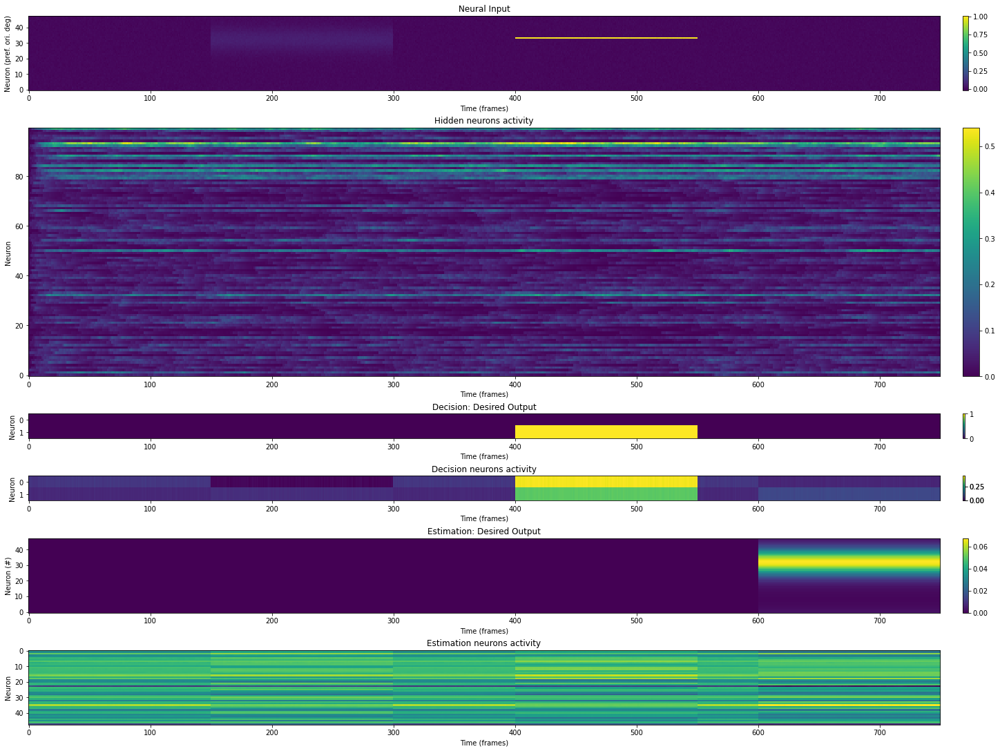

4501/5000 [==========================>...] - ETA: 2983s - Train Loss: 0.4887 - Test Loss: 0.4860 - Test estimation cos error: : 0.6488 - Test decision performance: : 0.4922 - Grads: 0.7761


 Epoch 4502, Train Loss: 0.488699734210968, Test Loss: 0.4860001802444458


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4501/assets


<Figure size 432x288 with 0 Axes>

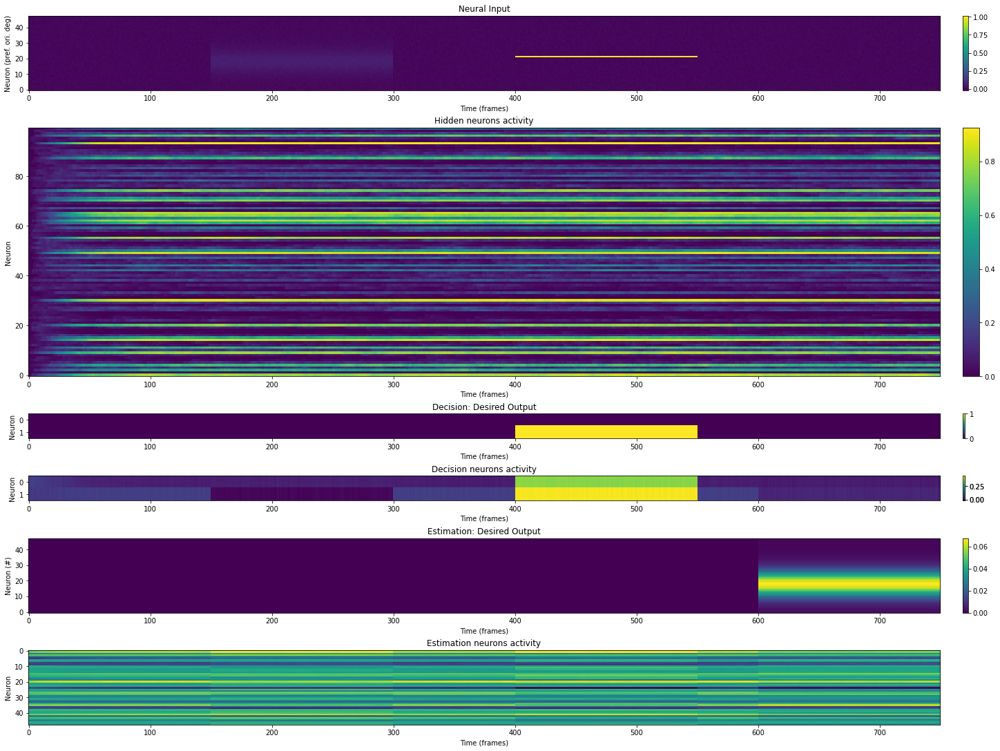

4601/5000 [==========================>...] - ETA: 2389s - Train Loss: 0.4904 - Test Loss: 0.4873 - Test estimation cos error: : 0.7094 - Test decision performance: : 0.4531 - Grads: 0.7781


 Epoch 4602, Train Loss: 0.4903595447540283, Test Loss: 0.4873013496398926


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4601/assets


<Figure size 432x288 with 0 Axes>

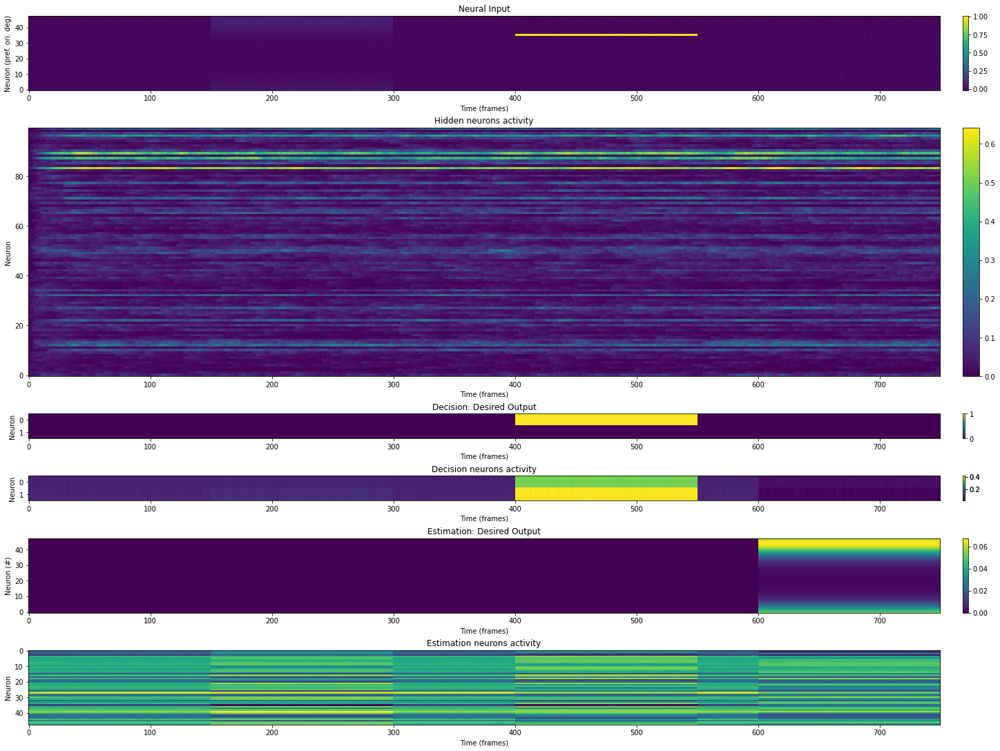

4701/5000 [===========================>..] - ETA: 1793s - Train Loss: 0.4844 - Test Loss: 0.4817 - Test estimation cos error: : 0.6738 - Test decision performance: : 0.4609 - Grads: 0.7670


 Epoch 4702, Train Loss: 0.48438069224357605, Test Loss: 0.4817068576812744


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4701/assets


<Figure size 432x288 with 0 Axes>

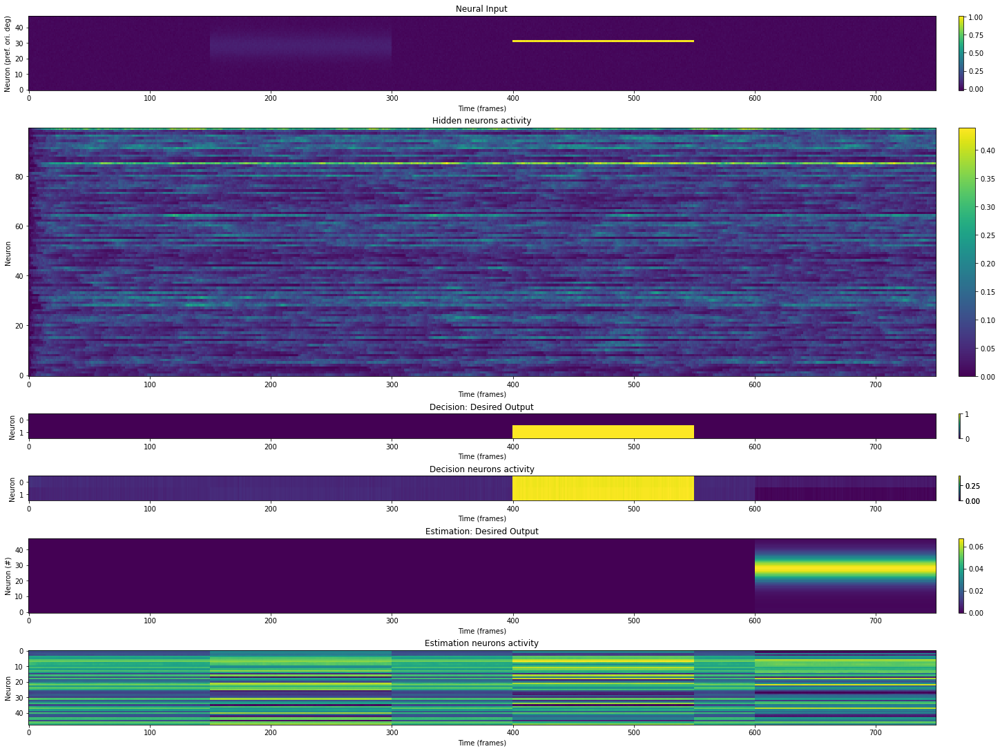

4801/5000 [===========================>..] - ETA: 1195s - Train Loss: 0.4891 - Test Loss: 0.4856 - Test estimation cos error: : 0.6559 - Test decision performance: : 0.4922 - Grads: 0.7735


 Epoch 4802, Train Loss: 0.48907431960105896, Test Loss: 0.485625296831131


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4801/assets


<Figure size 432x288 with 0 Axes>

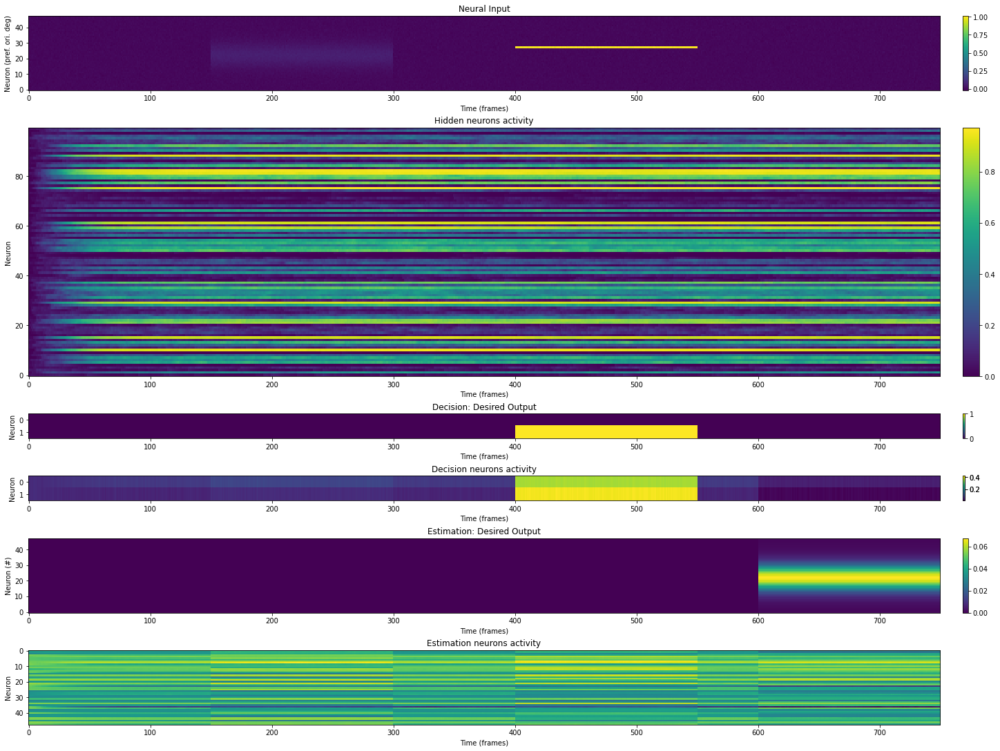

4901/5000 [============================>.] - ETA: 595s - Train Loss: 0.4881 - Test Loss: 0.4833 - Test estimation cos error: : 0.6331 - Test decision performance: : 0.4844 - Grads: 0.7749


 Epoch 4902, Train Loss: 0.48807060718536377, Test Loss: 0.48331862688064575


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iter4901/assets


<Figure size 432x288 with 0 Axes>

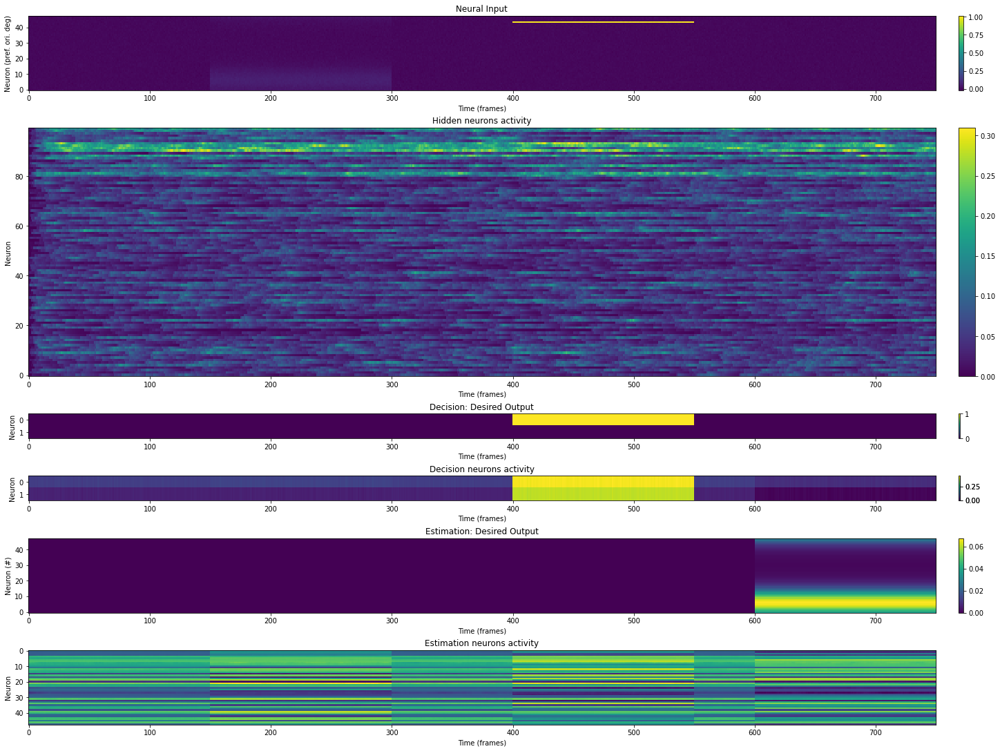

5000/5000 [==============================] - 30105s - Train Loss: 0.4849 - Test Loss: 0.4843 - Test estimation cos error: : 0.6261 - Test decision performance: : 0.4844 - Grads: 0.7671 

- Training done.



INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iterfinal/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model5/model/iterfinal/assets


<Figure size 432x288 with 0 Axes>

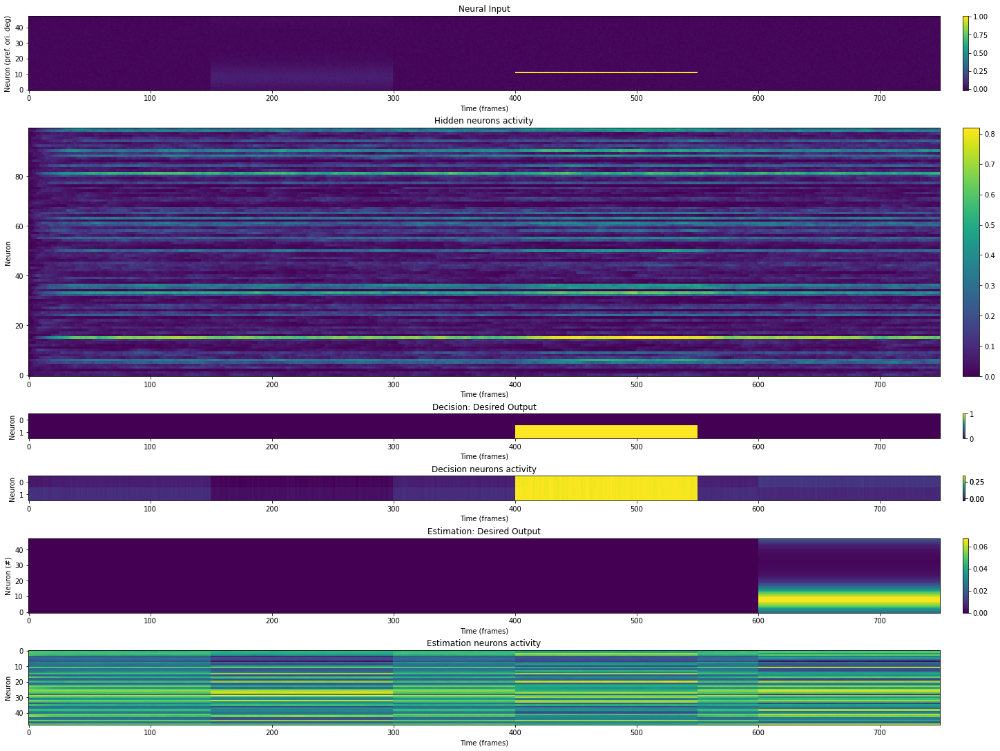

<Figure size 432x288 with 0 Axes>

In [14]:
# train network
grnn5.train(stim_train = stim_train, stim_test= stim_train, niter=5000)

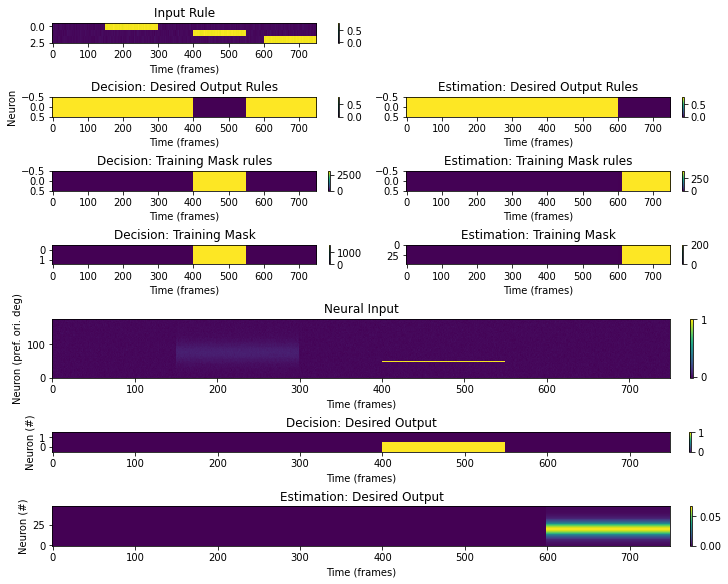

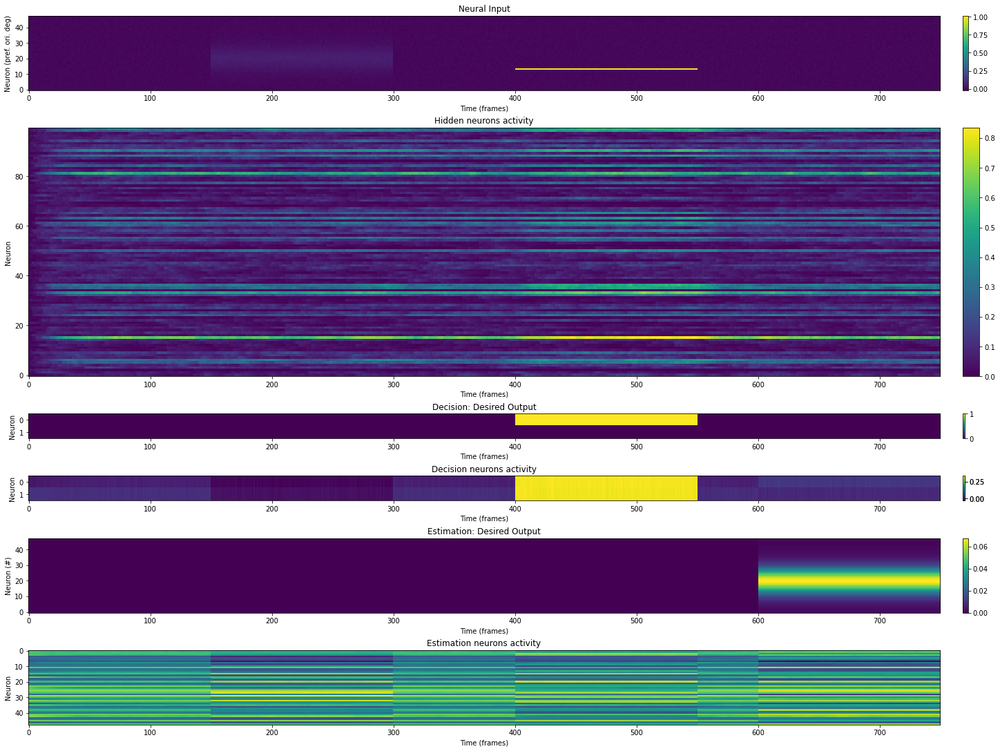

../utils/plotfnc.py:477: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)
../utils/plotfnc.py:485: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)


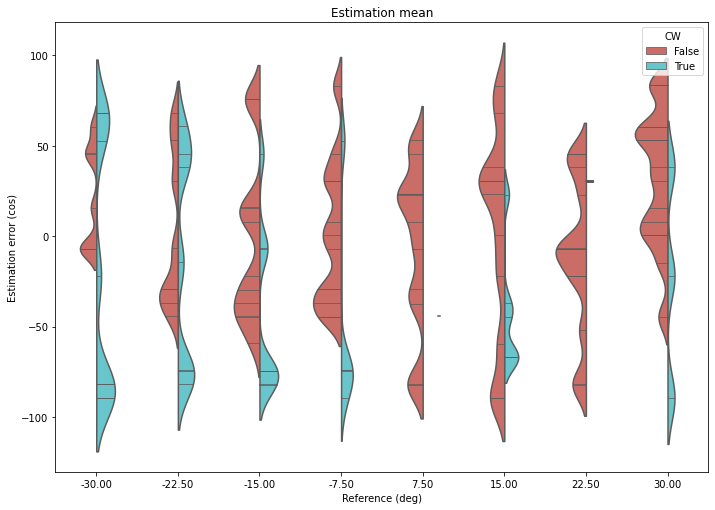

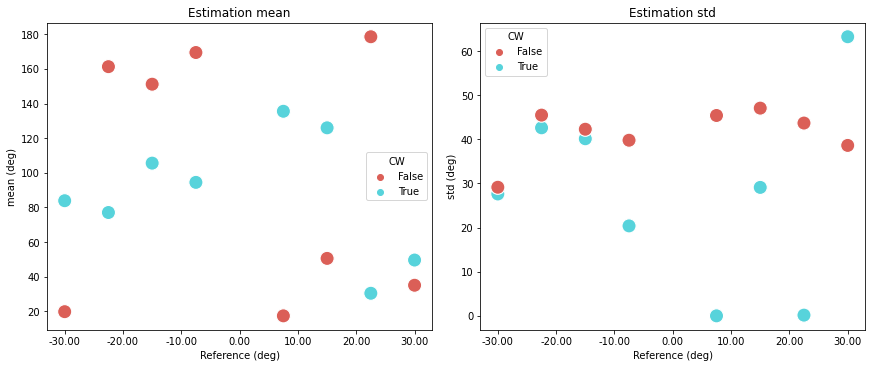

In [15]:
# evaluate and visualize after training
test_lossStruct, test_outputs   = grnn5.evaluate(test_data)

# plot rnn trial and outputs
TEST_TRIAL = np.random.randint(stim_train.batch_size) 
plot_trial(test_data, stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)
plot_rnn_output(test_data,test_outputs,stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)

# plot rnn decision effects on estimation
df_trials, df_sum = estimation_decision(test_data, test_outputs, stim_test)
plot_decision_effects(df_trials,df_sum)

# model 6: with stsp
- relu(tanh()) activation
- gated outputs (dm and em)

In [16]:
hp6    = copy.deepcopy(grnn_hp)
hp6['output_path'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model6/'
hp6['model_output'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model6/model'
hp6['log_path'] = '/Users/JRyu/github/det_rnn/experiments/grnn/model6/logs'
hp6['learning_rate'] = 0.05
hp6['neuron_stsp'] = True
hp6['out_gate'] = True
grnn6  = gRNN(hp6, par_train)

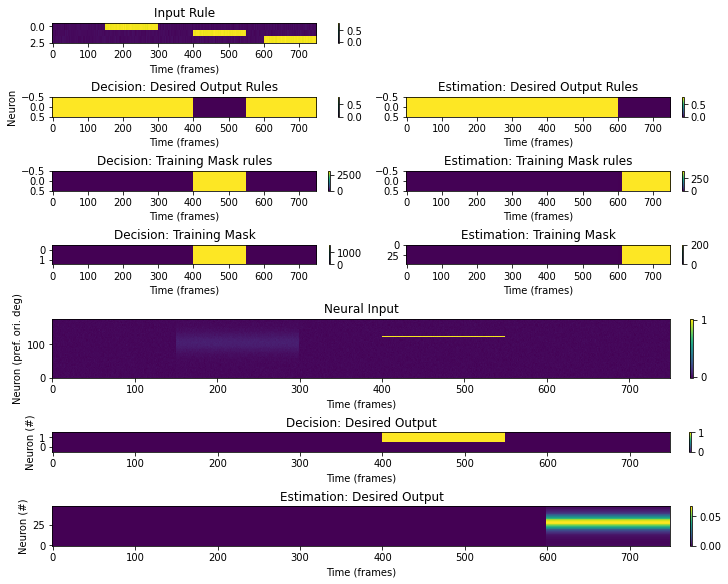

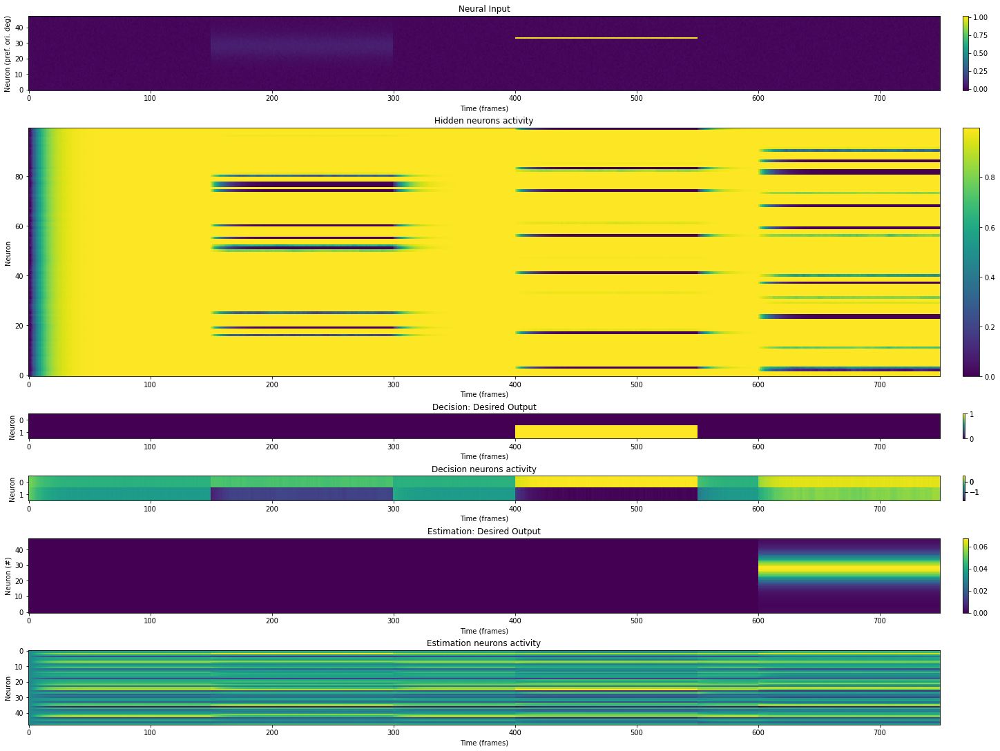

../models/base/analysis.py:186: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['CW'][0] = False
../models/base/analysis.py:187: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['CW'][1] = True
../utils/plotfnc.py:477: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)
../utils/plotfnc.py:485: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_xticklabels(xlabels)


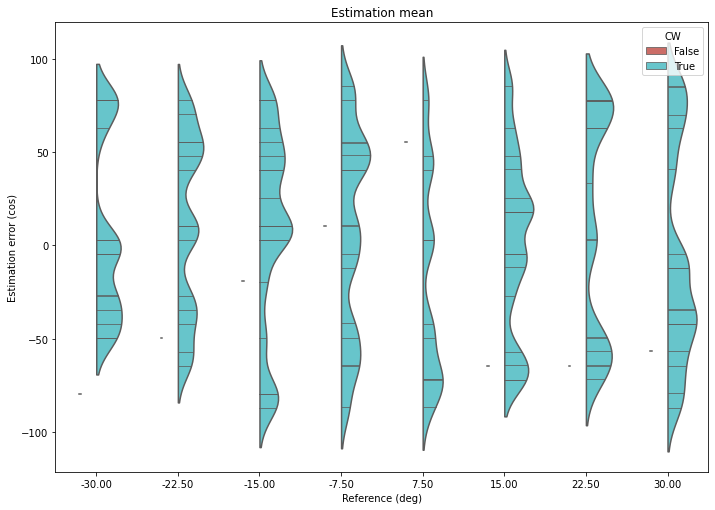

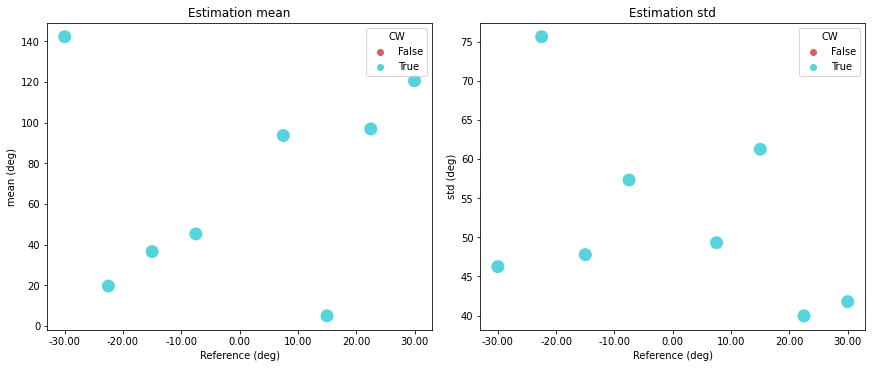

In [17]:
# evaluate and visualize before training
test_lossStruct, test_outputs   = grnn6.evaluate(test_data)

# plot rnn trial and outputs
TEST_TRIAL = np.random.randint(stim_train.batch_size) 
plot_trial(test_data, stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)
plot_rnn_output(test_data,test_outputs,stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)

# plot rnn decision effects on estimation
df_trials, df_sum = estimation_decision(test_data, test_outputs, stim_test)
plot_decision_effects(df_trials,df_sum)

   1/5000 [..............................] - ETA: 38898s - Train Loss: 2.8152 - Test Loss: 33.9510 - Test estimation cos error: : 0.5997 - Test decision performance: : 0.4141 - Grads: 14.5119


 Epoch 2, Train Loss: 2.815213918685913, Test Loss: 33.951011657714844


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1/assets


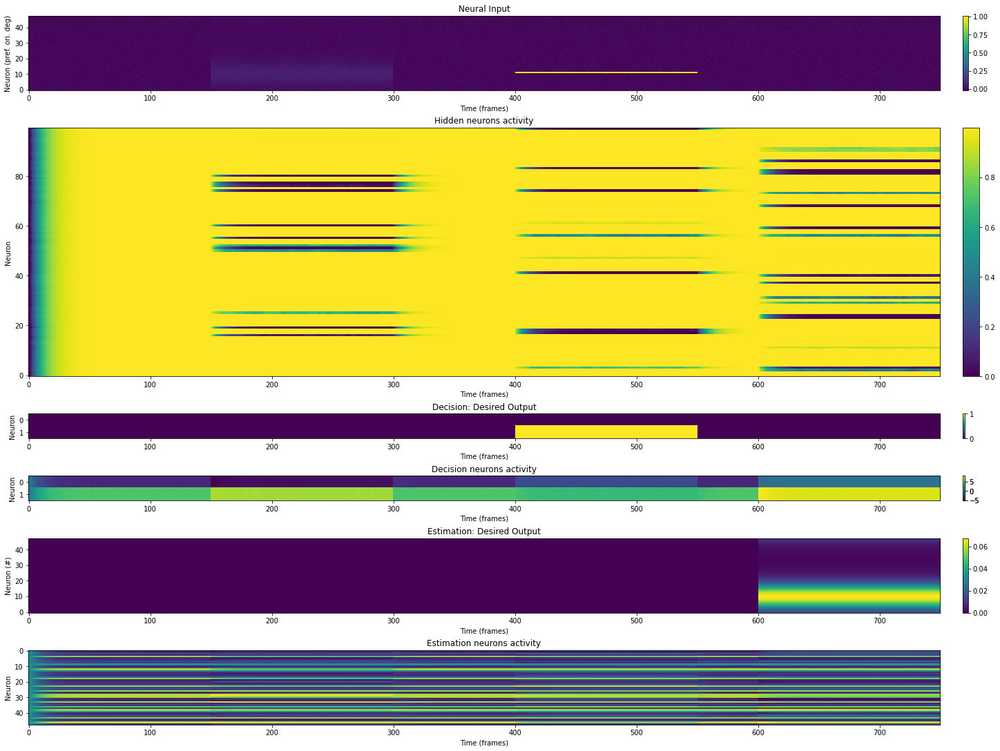

 101/5000 [..............................] - ETA: 38655s - Train Loss: 0.5039 - Test Loss: 0.5219 - Test estimation cos error: : 0.6568 - Test decision performance: : 0.4688 - Grads: 0.8372


 Epoch 102, Train Loss: 0.5039309859275818, Test Loss: 0.5218985676765442


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter101/assets


<Figure size 432x288 with 0 Axes>

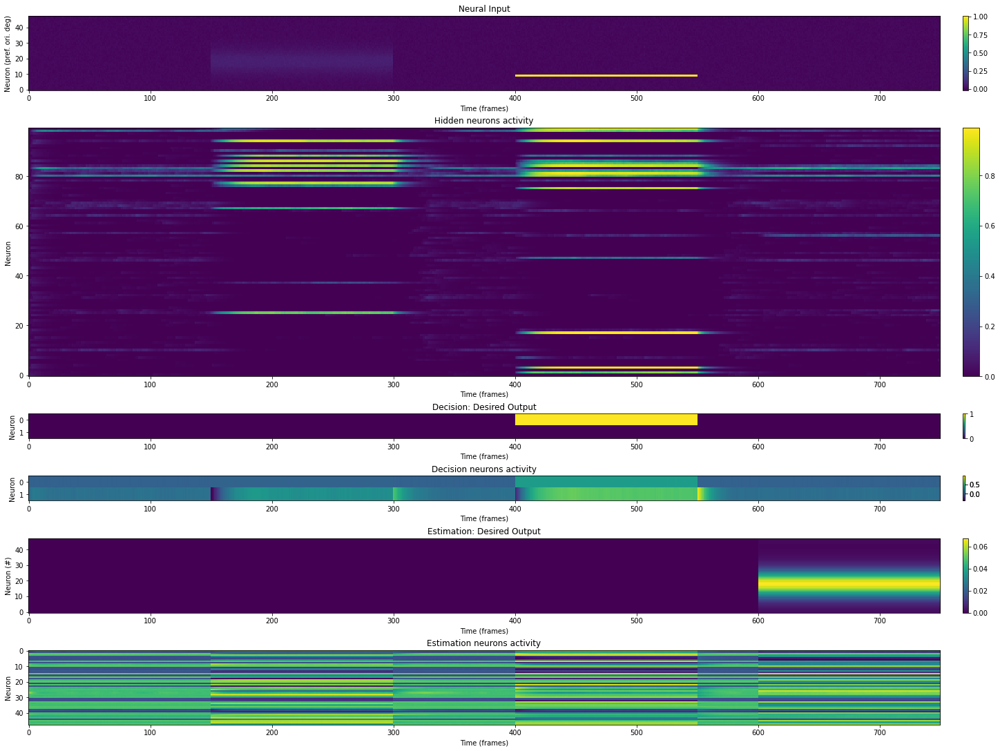

 201/5000 [>.............................] - ETA: 37665s - Train Loss: 0.5270 - Test Loss: 0.5561 - Test estimation cos error: : 0.6589 - Test decision performance: : 0.4219 - Grads: 0.8773


 Epoch 202, Train Loss: 0.527008593082428, Test Loss: 0.5560654401779175


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter201/assets


<Figure size 432x288 with 0 Axes>

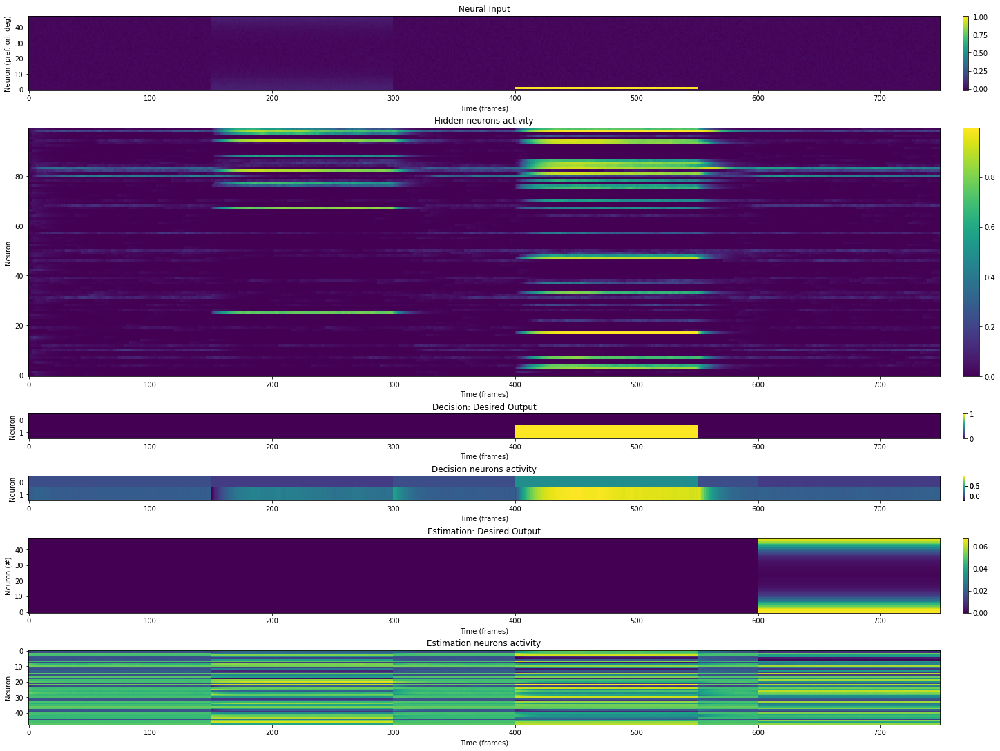

 301/5000 [>.............................] - ETA: 36962s - Train Loss: 0.4879 - Test Loss: 0.4867 - Test estimation cos error: : 0.6507 - Test decision performance: : 0.5000 - Grads: 0.7752


 Epoch 302, Train Loss: 0.4879119396209717, Test Loss: 0.48666492104530334


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter301/assets


<Figure size 432x288 with 0 Axes>

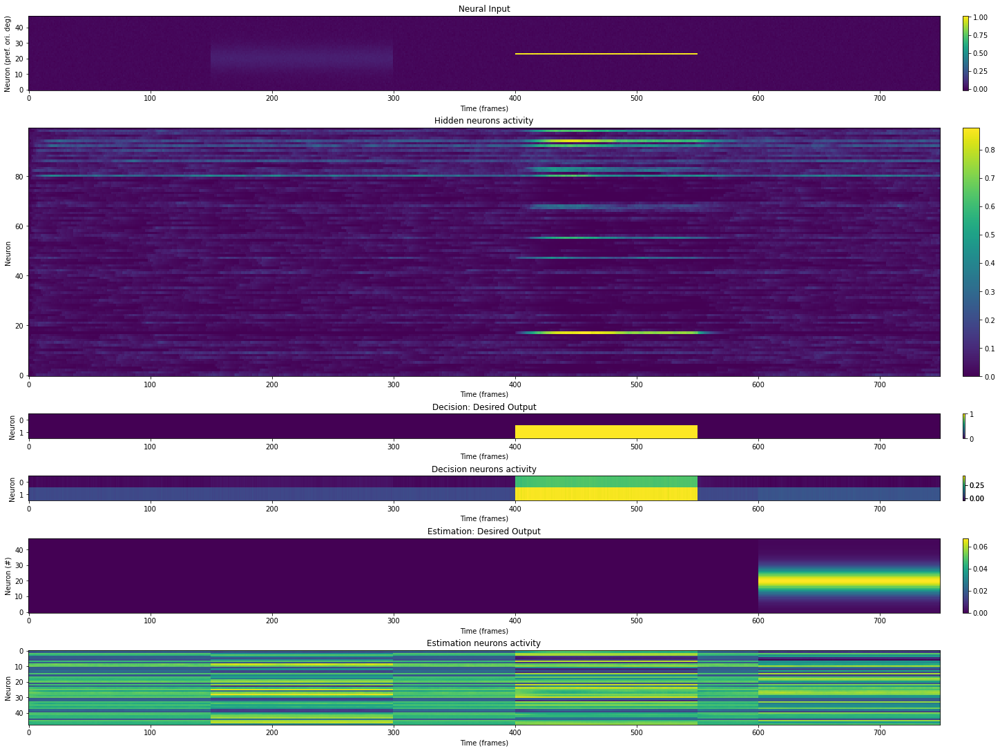

 401/5000 [=>............................] - ETA: 36134s - Train Loss: 0.4831 - Test Loss: 0.4826 - Test estimation cos error: : 0.6630 - Test decision performance: : 0.4766 - Grads: 0.7709


 Epoch 402, Train Loss: 0.4830705225467682, Test Loss: 0.4826033115386963


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter401/assets


<Figure size 432x288 with 0 Axes>

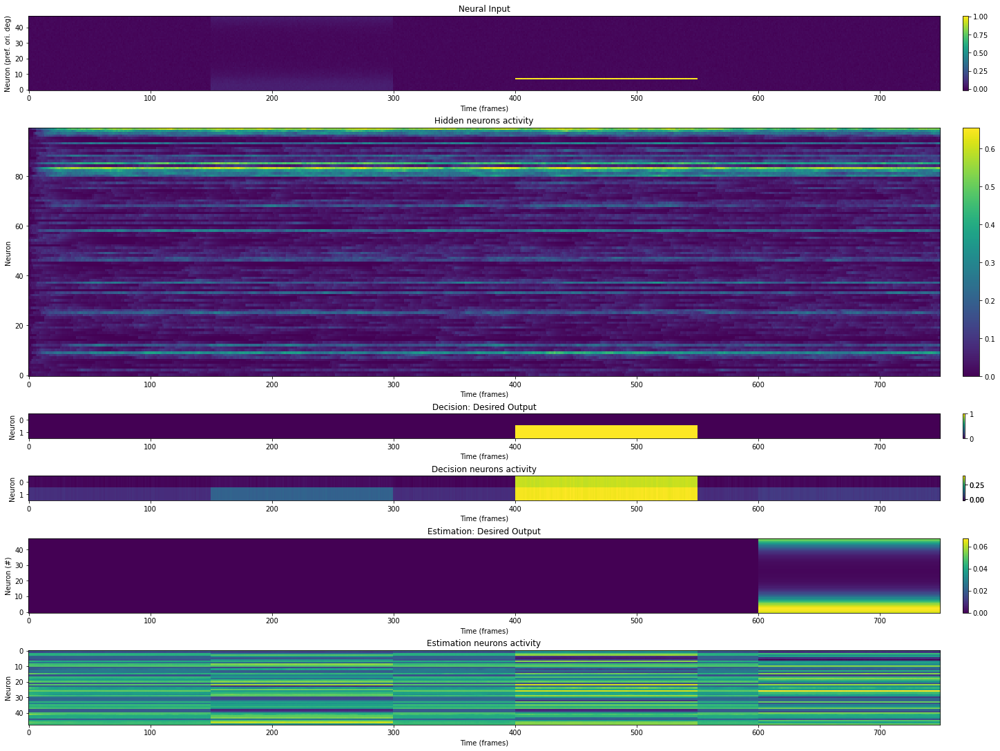

 501/5000 [==>...........................] - ETA: 35651s - Train Loss: 0.4911 - Test Loss: 0.4828 - Test estimation cos error: : 0.6206 - Test decision performance: : 0.5469 - Grads: 0.7809


 Epoch 502, Train Loss: 0.49107030034065247, Test Loss: 0.4828198552131653


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter501/assets


<Figure size 432x288 with 0 Axes>

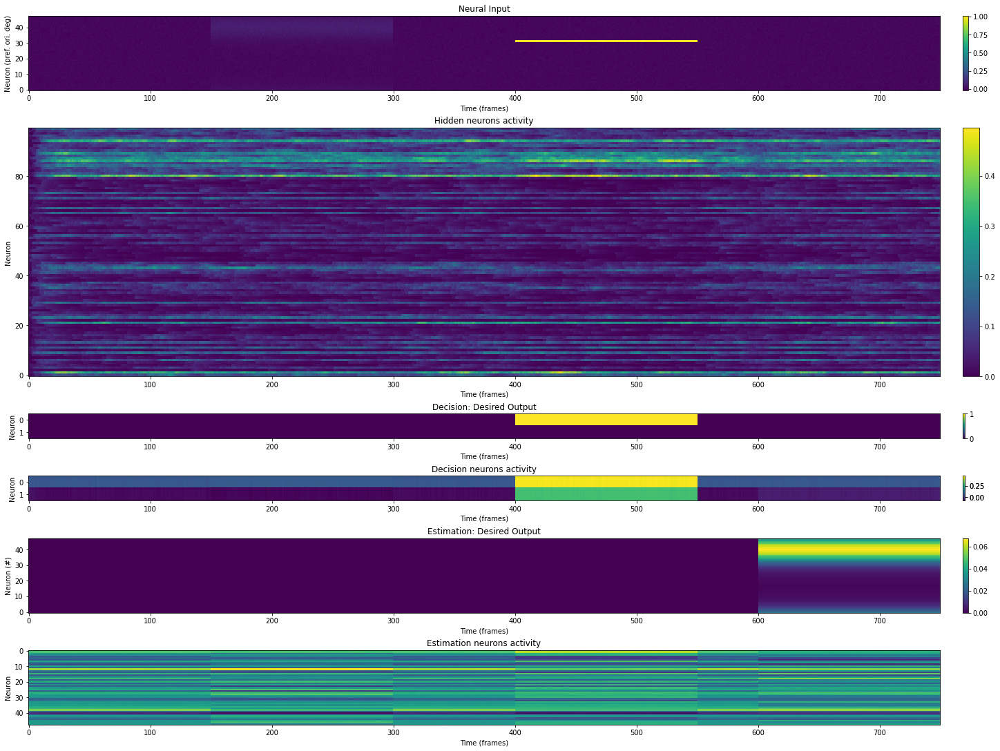

 601/5000 [==>...........................] - ETA: 35716s - Train Loss: 0.4851 - Test Loss: 0.4909 - Test estimation cos error: : 0.6578 - Test decision performance: : 0.5234 - Grads: 0.7672


 Epoch 602, Train Loss: 0.485067754983902, Test Loss: 0.4908992350101471


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter601/assets


<Figure size 432x288 with 0 Axes>

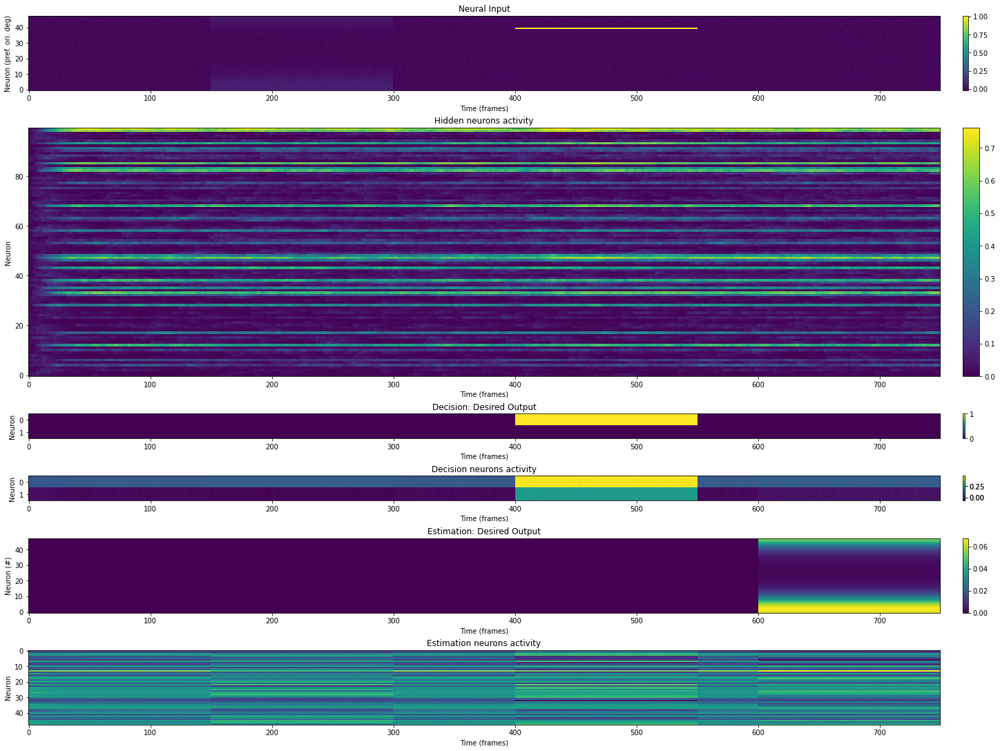

 701/5000 [===>..........................] - ETA: 36689s - Train Loss: 0.4749 - Test Loss: 0.4752 - Test estimation cos error: : 0.6525 - Test decision performance: : 0.5859 - Grads: 0.7765


 Epoch 702, Train Loss: 0.47491565346717834, Test Loss: 0.47519567608833313


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter701/assets


<Figure size 432x288 with 0 Axes>

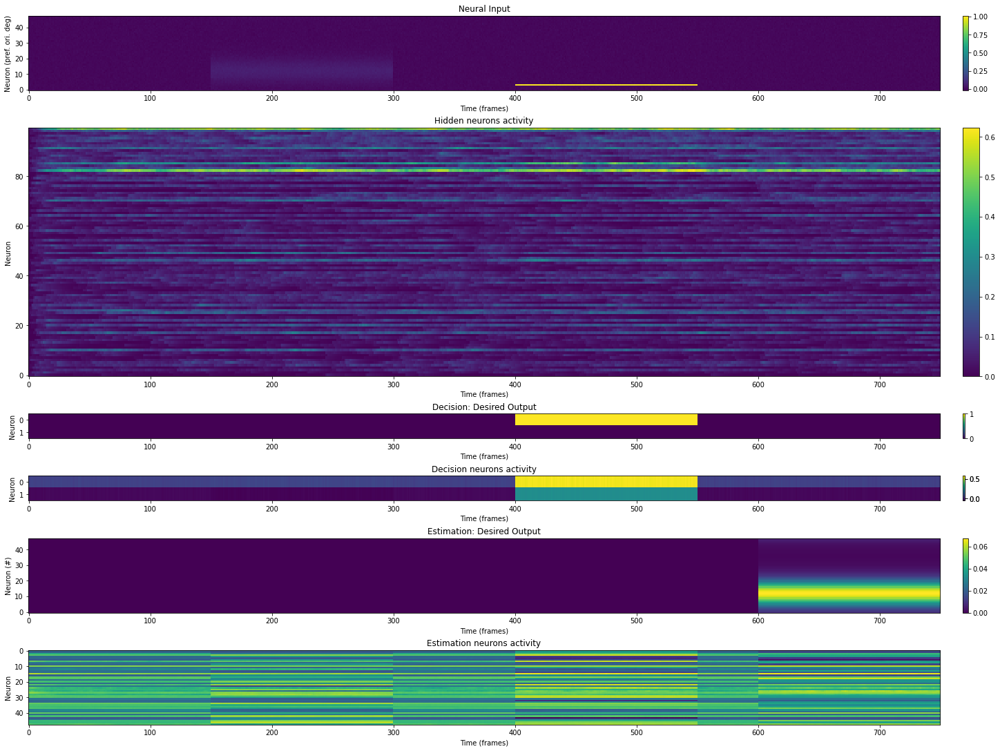

 801/5000 [===>..........................] - ETA: 37700s - Train Loss: 0.5227 - Test Loss: 0.4900 - Test estimation cos error: : 0.6386 - Test decision performance: : 0.4531 - Grads: 0.8413


 Epoch 802, Train Loss: 0.522660493850708, Test Loss: 0.49001413583755493


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter801/assets


<Figure size 432x288 with 0 Axes>

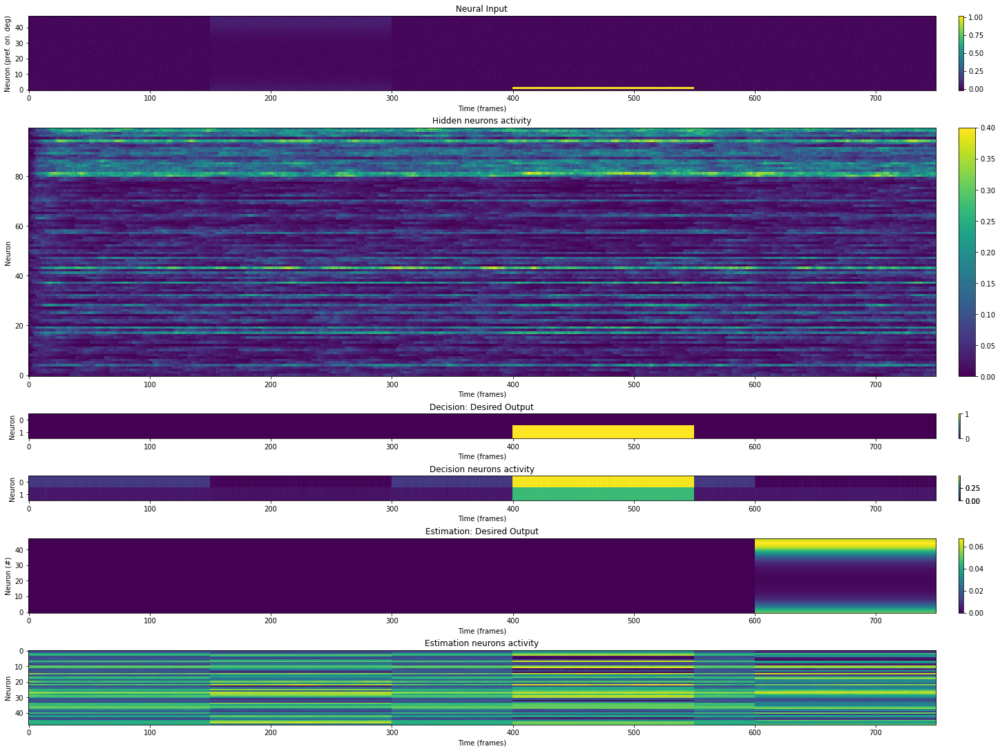

 901/5000 [====>.........................] - ETA: 46160s - Train Loss: 0.4809 - Test Loss: 0.4849 - Test estimation cos error: : 0.5933 - Test decision performance: : 0.5156 - Grads: 0.7649


 Epoch 902, Train Loss: 0.48087984323501587, Test Loss: 0.4849209189414978


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter901/assets


<Figure size 432x288 with 0 Axes>

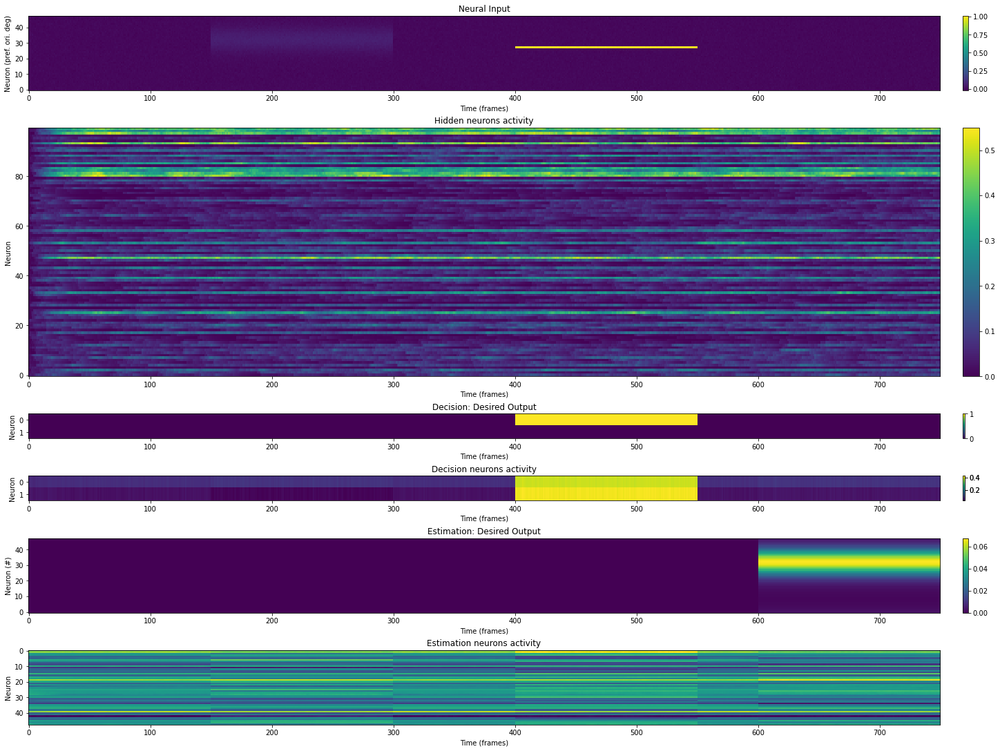

1001/5000 [=====>........................] - ETA: 45479s - Train Loss: 0.4911 - Test Loss: 0.4861 - Test estimation cos error: : 0.6291 - Test decision performance: : 0.5078 - Grads: 0.7826


 Epoch 1002, Train Loss: 0.4910743832588196, Test Loss: 0.48612847924232483


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1001/assets


<Figure size 432x288 with 0 Axes>

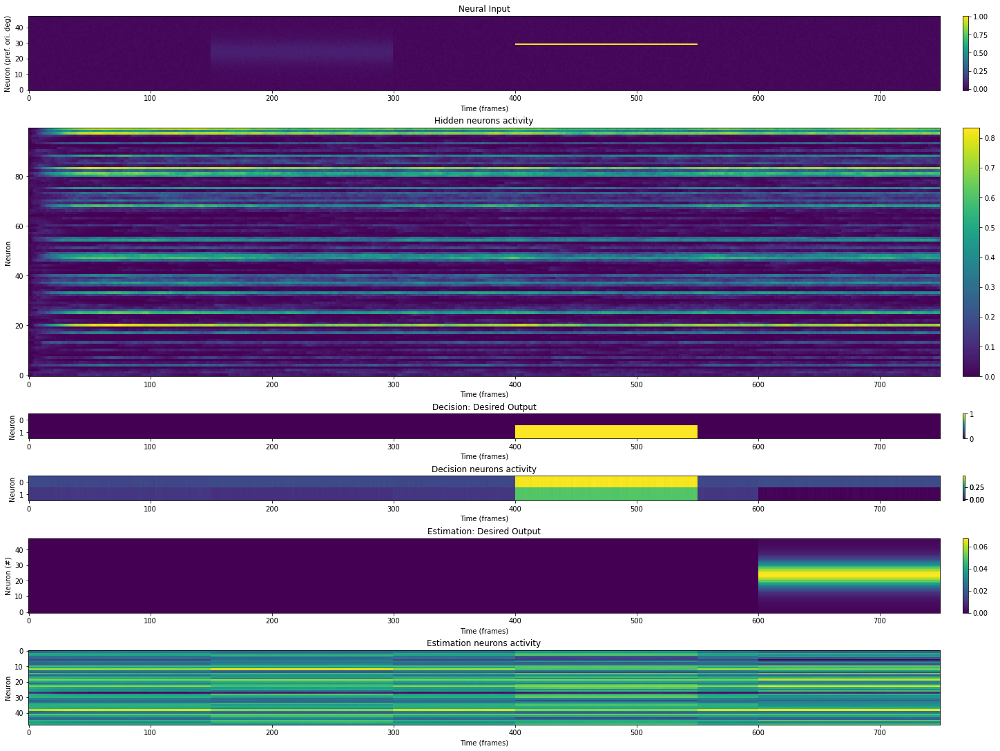

1101/5000 [=====>........................] - ETA: 45836s - Train Loss: 0.4822 - Test Loss: 0.4950 - Test estimation cos error: : 0.6455 - Test decision performance: : 0.5078 - Grads: 0.7657


 Epoch 1102, Train Loss: 0.48215699195861816, Test Loss: 0.49498945474624634


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1101/assets


<Figure size 432x288 with 0 Axes>

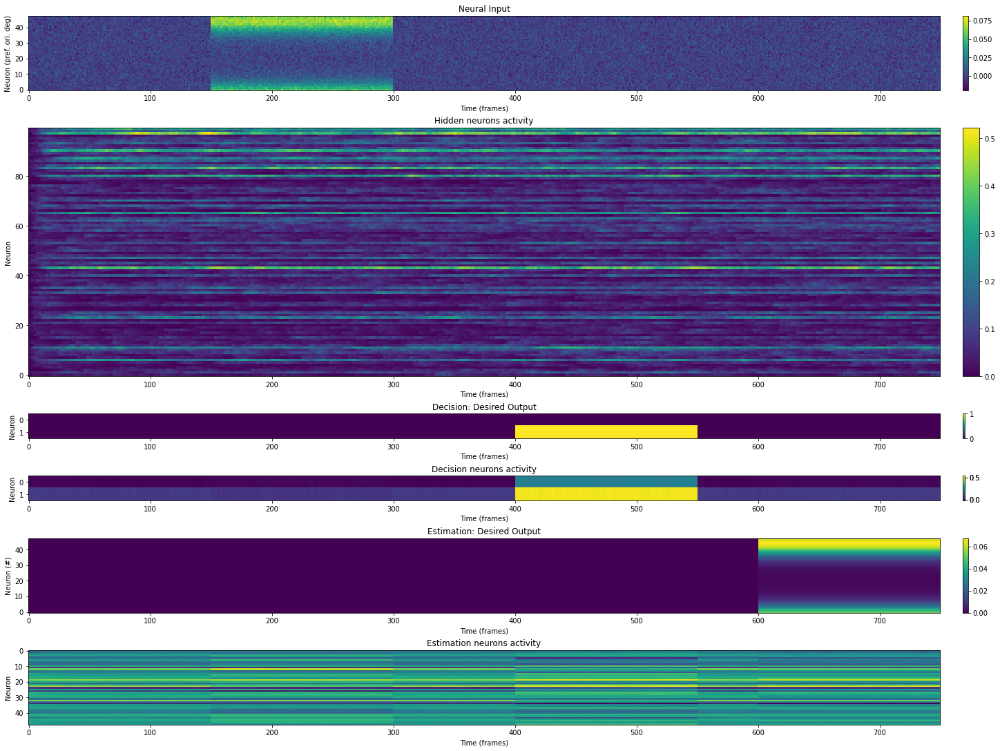

1201/5000 [======>.......................] - ETA: 45900s - Train Loss: 0.4963 - Test Loss: 0.4924 - Test estimation cos error: : 0.6614 - Test decision performance: : 0.4609 - Grads: 0.8060


 Epoch 1202, Train Loss: 0.4963216483592987, Test Loss: 0.4924022853374481


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1201/assets


<Figure size 432x288 with 0 Axes>

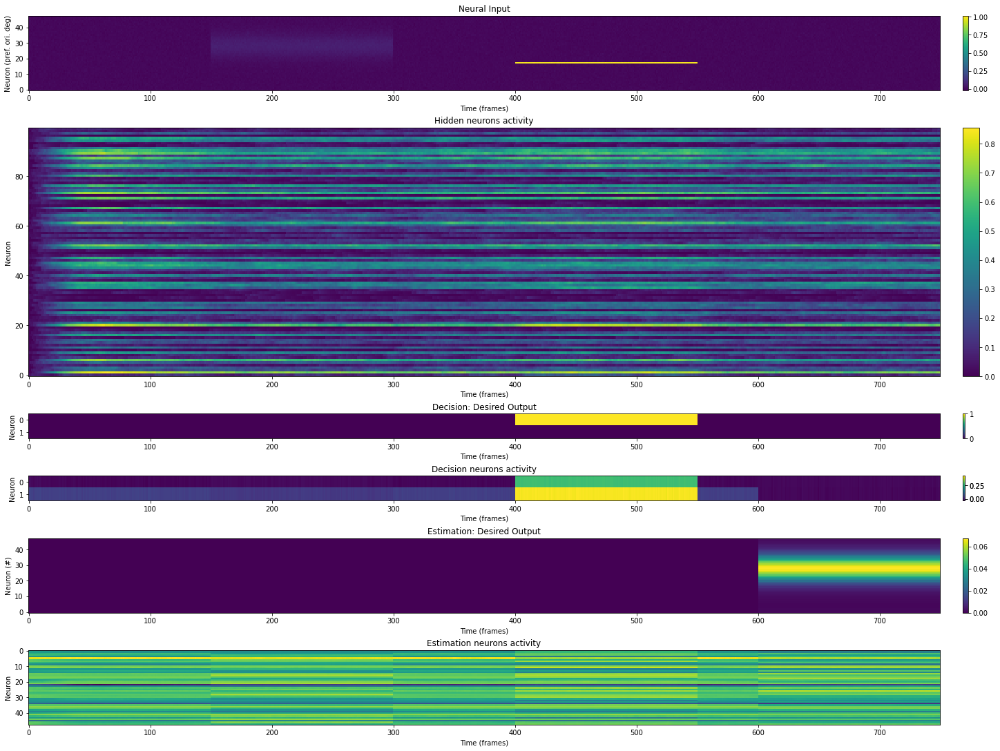

1301/5000 [======>.......................] - ETA: 44383s - Train Loss: 0.4864 - Test Loss: 0.4874 - Test estimation cos error: : 0.6450 - Test decision performance: : 0.4609 - Grads: 0.7711


 Epoch 1302, Train Loss: 0.48637470602989197, Test Loss: 0.48741334676742554


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1301/assets


<Figure size 432x288 with 0 Axes>

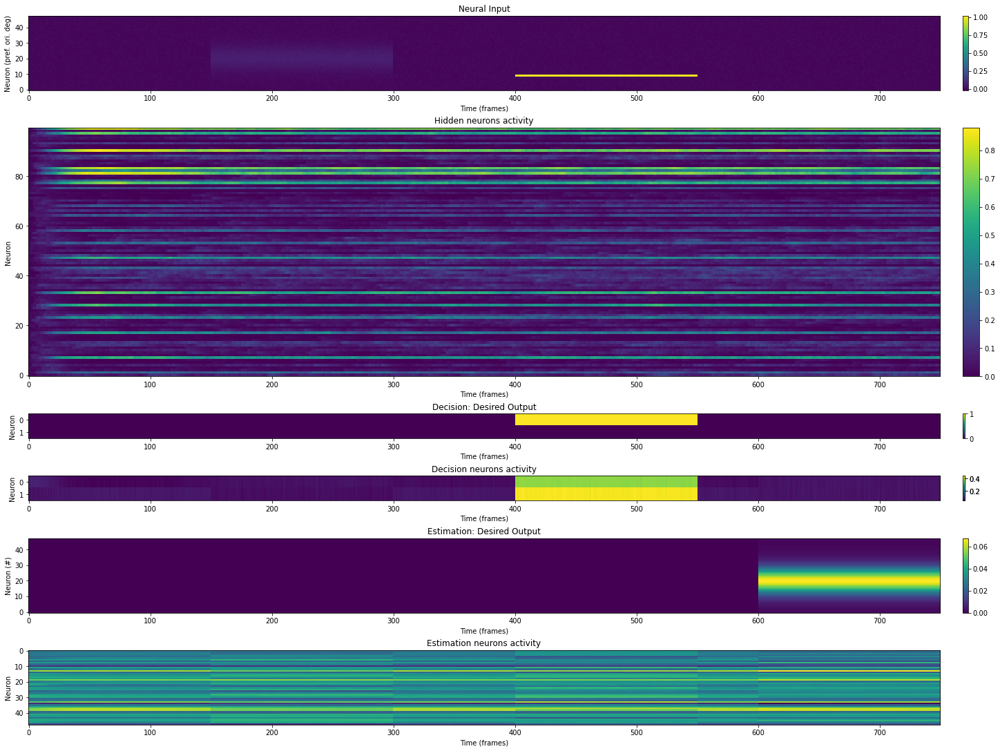

1401/5000 [=======>......................] - ETA: 42291s - Train Loss: 0.4903 - Test Loss: 0.4830 - Test estimation cos error: : 0.6481 - Test decision performance: : 0.5156 - Grads: 0.7803


 Epoch 1402, Train Loss: 0.49029821157455444, Test Loss: 0.48304444551467896


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1401/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1401/assets


<Figure size 432x288 with 0 Axes>

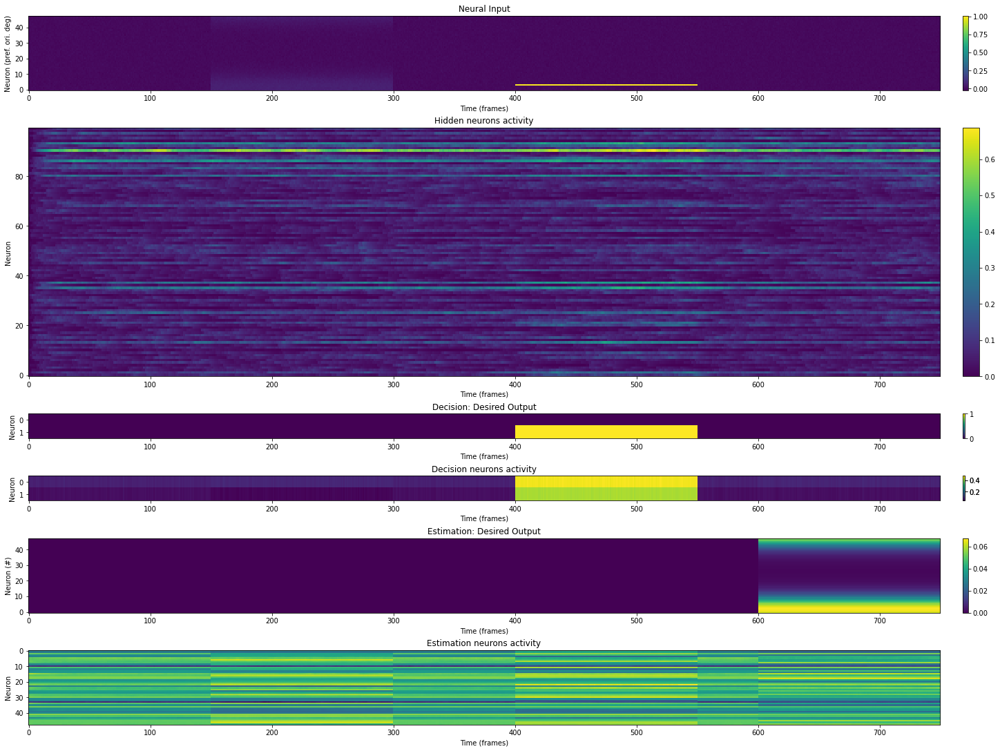

1501/5000 [========>.....................] - ETA: 40246s - Train Loss: 0.4845 - Test Loss: 0.4816 - Test estimation cos error: : 0.5842 - Test decision performance: : 0.5469 - Grads: 0.7690


 Epoch 1502, Train Loss: 0.4844897985458374, Test Loss: 0.48157432675361633


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1501/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1501/assets


<Figure size 432x288 with 0 Axes>

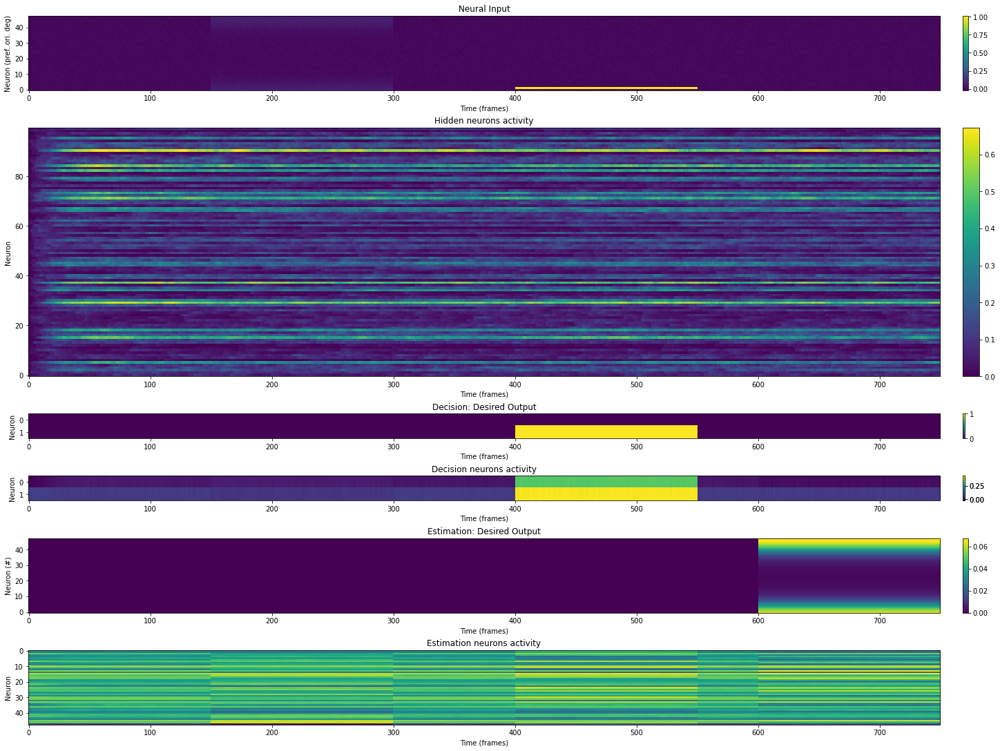

1601/5000 [========>.....................] - ETA: 38647s - Train Loss: 0.4784 - Test Loss: 0.4852 - Test estimation cos error: : 0.6055 - Test decision performance: : 0.5391 - Grads: 0.7681


 Epoch 1602, Train Loss: 0.47836485505104065, Test Loss: 0.485225647687912


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1601/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1601/assets


<Figure size 432x288 with 0 Axes>

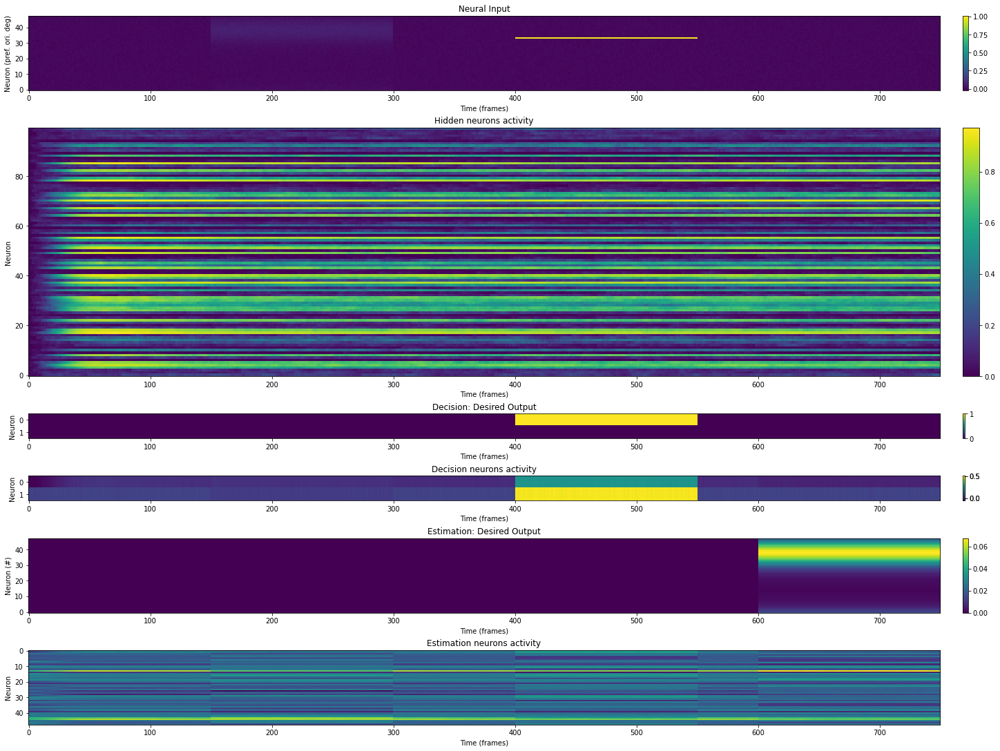

1701/5000 [=========>....................] - ETA: 37609s - Train Loss: 0.4849 - Test Loss: 0.4925 - Test estimation cos error: : 0.5804 - Test decision performance: : 0.5312 - Grads: 0.7716


 Epoch 1702, Train Loss: 0.484854131937027, Test Loss: 0.4925369322299957


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1701/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1701/assets


<Figure size 432x288 with 0 Axes>

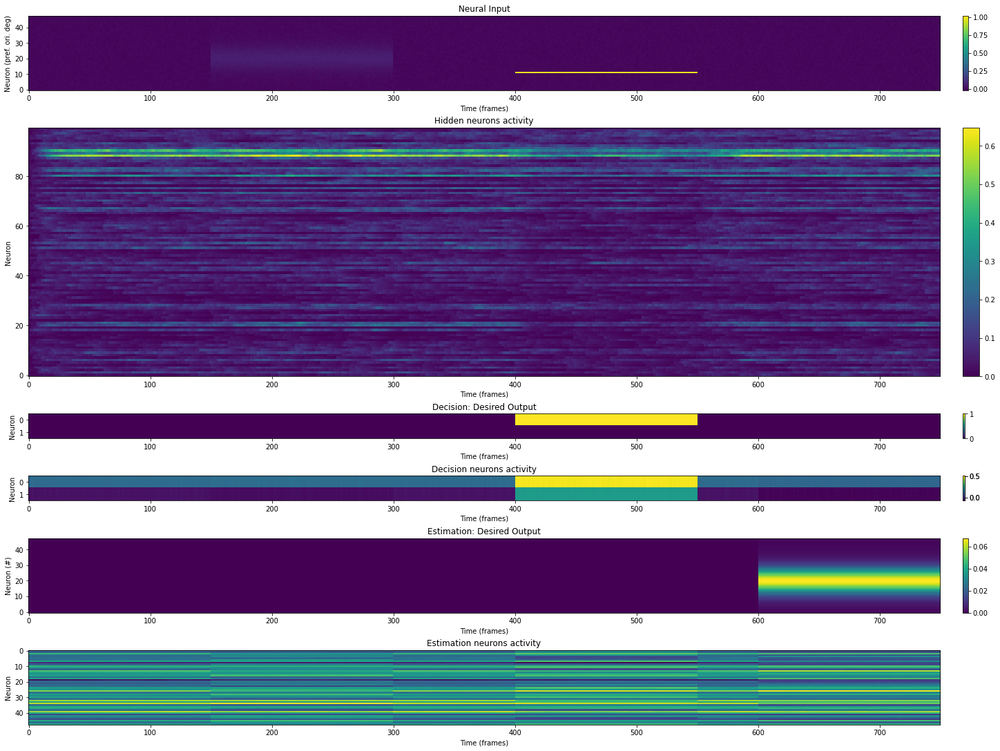

1801/5000 [=========>....................] - ETA: 36229s - Train Loss: 0.4763 - Test Loss: 0.4920 - Test estimation cos error: : 0.6457 - Test decision performance: : 0.5078 - Grads: 0.7683


 Epoch 1802, Train Loss: 0.47626635432243347, Test Loss: 0.49203571677207947


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1801/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1801/assets


<Figure size 432x288 with 0 Axes>

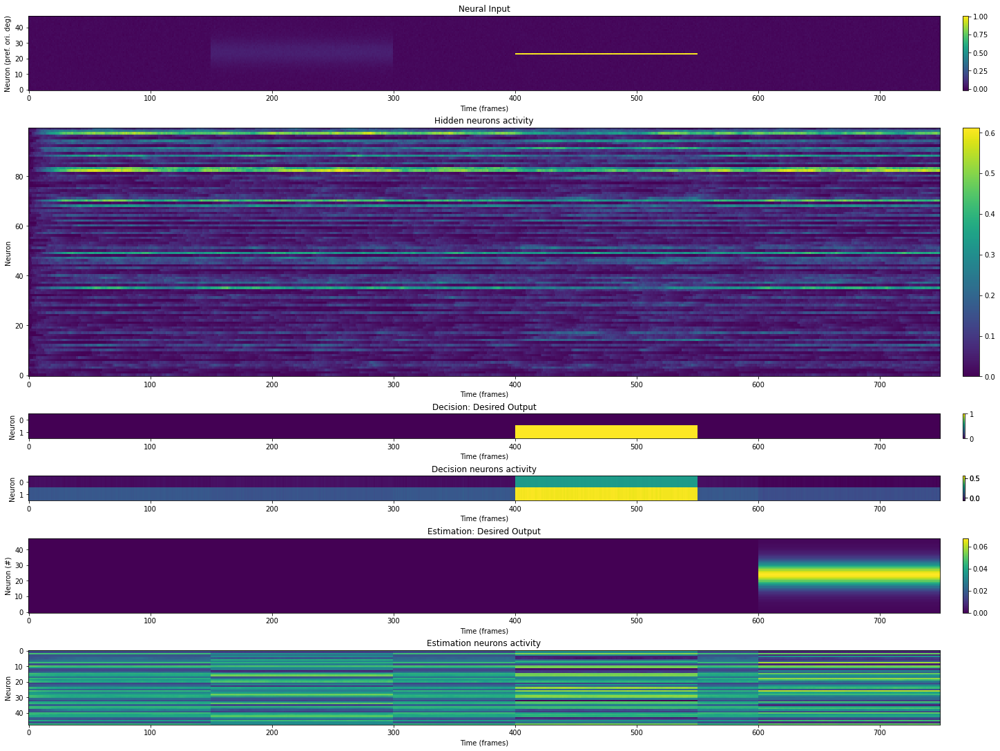

1901/5000 [==========>...................] - ETA: 35373s - Train Loss: 0.5147 - Test Loss: 0.5130 - Test estimation cos error: : 0.6333 - Test decision performance: : 0.5234 - Grads: 0.9430


 Epoch 1902, Train Loss: 0.5146835446357727, Test Loss: 0.512959361076355


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1901/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter1901/assets


<Figure size 432x288 with 0 Axes>

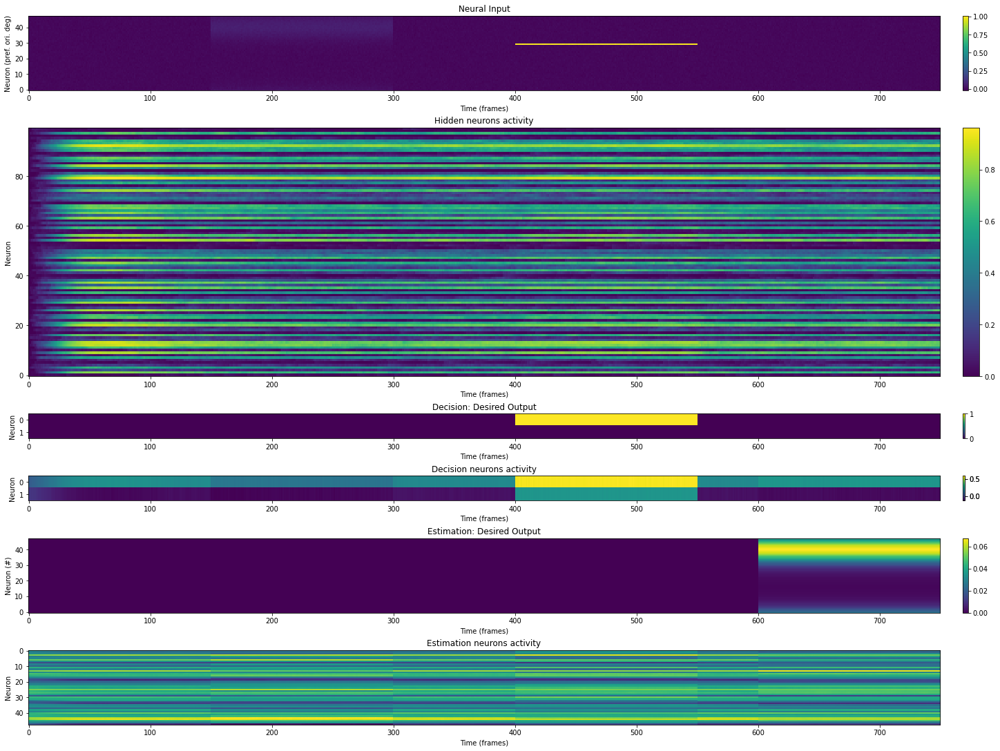

2001/5000 [===========>..................] - ETA: 34523s - Train Loss: 0.4813 - Test Loss: 0.4885 - Test estimation cos error: : 0.6380 - Test decision performance: : 0.4766 - Grads: 0.7652


 Epoch 2002, Train Loss: 0.48130908608436584, Test Loss: 0.4885481595993042


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2001/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2001/assets


<Figure size 432x288 with 0 Axes>

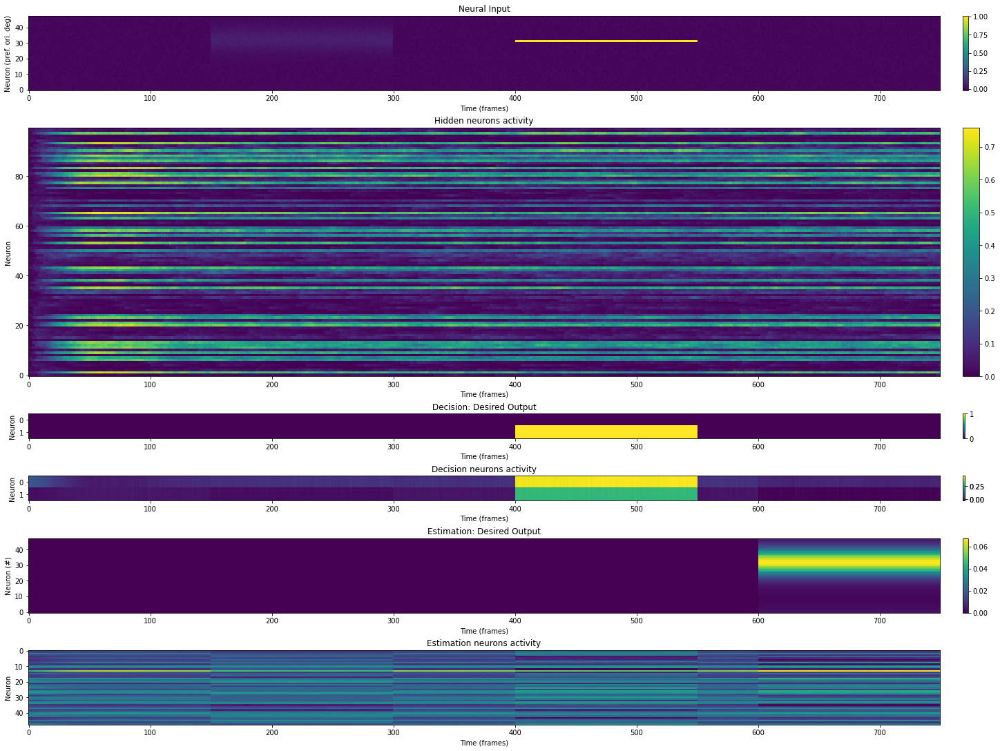

2101/5000 [===========>..................] - ETA: 33653s - Train Loss: 0.4928 - Test Loss: 0.4870 - Test estimation cos error: : 0.6715 - Test decision performance: : 0.5156 - Grads: 0.7793


 Epoch 2102, Train Loss: 0.4928249716758728, Test Loss: 0.48695510625839233


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2101/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2101/assets


<Figure size 432x288 with 0 Axes>

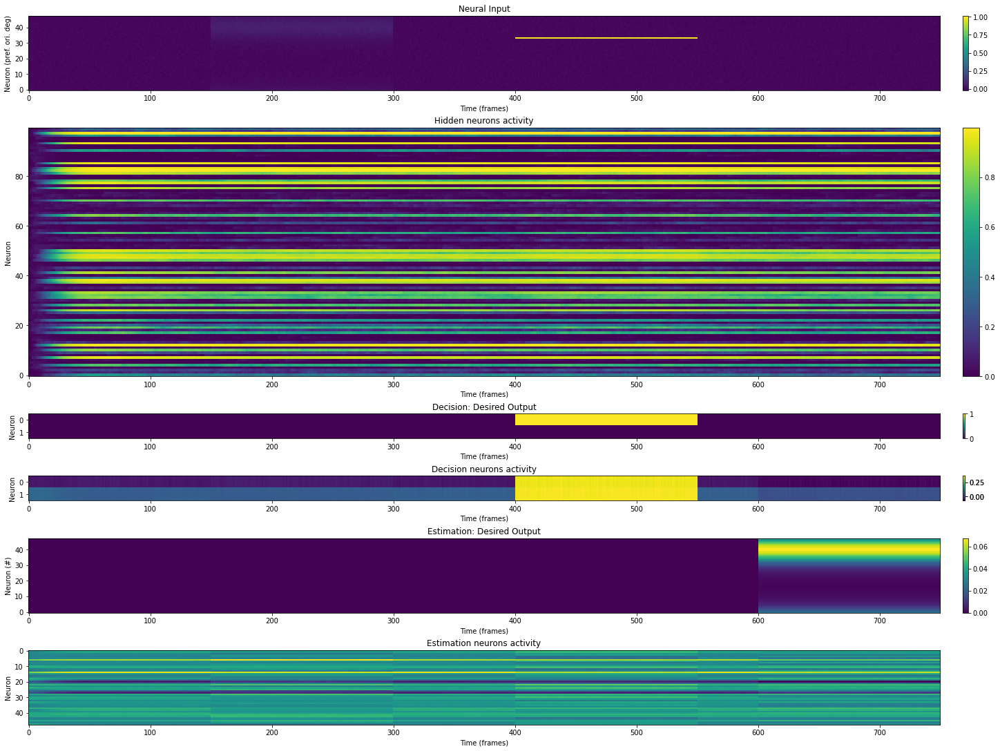

2201/5000 [============>.................] - ETA: 33068s - Train Loss: 0.5134 - Test Loss: 0.4870 - Test estimation cos error: : 0.5843 - Test decision performance: : 0.4844 - Grads: 0.8212


 Epoch 2202, Train Loss: 0.5133857131004333, Test Loss: 0.48702728748321533


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2201/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2201/assets


<Figure size 432x288 with 0 Axes>

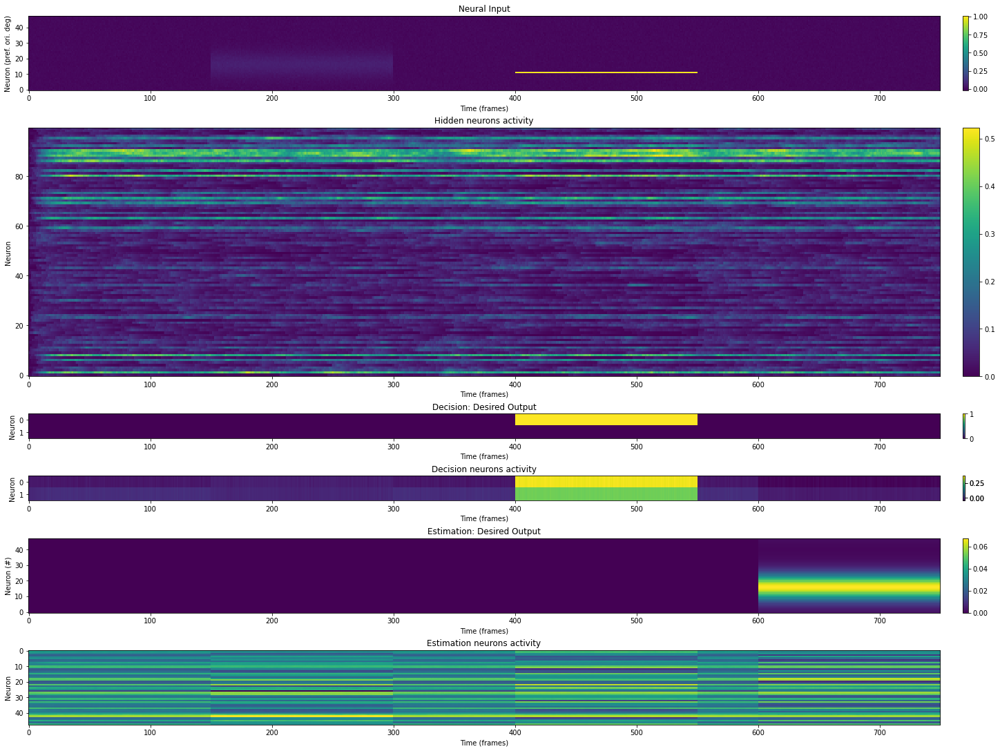

2301/5000 [============>.................] - ETA: 32132s - Train Loss: 0.4828 - Test Loss: 0.4978 - Test estimation cos error: : 0.6494 - Test decision performance: : 0.4297 - Grads: 0.7678


 Epoch 2302, Train Loss: 0.48278918862342834, Test Loss: 0.4977904260158539


INFO:tensorflow:Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2301/assets


Assets written to: /Users/JRyu/github/det_rnn/experiments/grnn/model6/model/iter2301/assets


<Figure size 432x288 with 0 Axes>

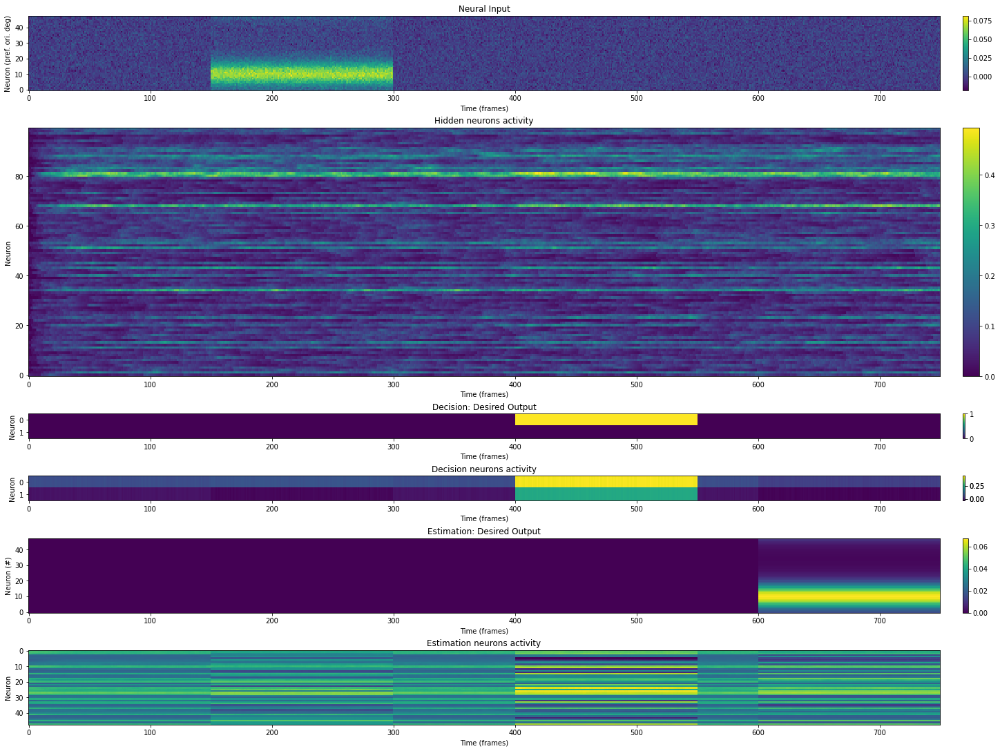

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [18]:
grnn6.train(stim_train = stim_train, stim_test= stim_train, niter=5000)

In [ ]:
# evaluate and visualize before training
test_lossStruct, test_outputs   = grnn6.evaluate(test_data)

# plot rnn trial and outputs
TEST_TRIAL = np.random.randint(stim_train.batch_size) 
plot_trial(test_data, stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)
plot_rnn_output(test_data,test_outputs,stim_train, TEST_TRIAL=TEST_TRIAL, savename=None)

# plot rnn decision effects on estimation on test set
df_trials, df_sum = estimation_decision(test_data, test_outputs, stim_test)
plot_decision_effects(df_trials,df_sum)